In [1]:
import geopandas as gpd
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import datetime as dt
import plotly.express as px
import plotly
from plotly.subplots import make_subplots
from operator import itemgetter
from FunctionsV2 import *

In [2]:
# conversio abs to rs to ss

absrsss = pd.read_csv('/data/ifaecovid/common/Health/P_646_F_taula0_pob_cohort_estudi_Final.csv',sep='~')

absrsss.iloc[:,7] = absrsss.iloc[:,7].astype(str).str.zfill(3)
filterSES = absrsss.ABS1 == 'SES'
absrsss = absrsss[~filterSES]
absrsss.iloc[:,7] = absrsss.iloc[:,7].astype(int)
absrsss.ABS1.nunique()
absrsss = absrsss.groupby(['ABS1','ABS2', 'SS1', 'SS2', 'RS1', 'RS2']).count().reset_index().drop_duplicates(subset=['ABS1'])
absrsss = absrsss[['ABS1','ABS2', 'SS1', 'SS2', 'RS1', 'RS2']]
absrsss.to_csv('ABStoRS.csv',sep=',') 

/data/jupyter/software/miniconda_py39_4.10.3/envs/jupyterhub_0.4/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3251: DtypeWarning: Columns (7,9,11) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [3]:
data = gpd.read_file('ABS_2018_2021.shp')
data.shape
data.CODIABS.nunique()

374

In [4]:
abstors = pd.read_csv('ABStoRS.csv', sep=',')
abstors.iloc[:,1] = abstors.iloc[:,1].astype(str).str.zfill(3)
abstors.ABS1.nunique()
abstors = abstors.drop_duplicates(subset=['ABS1'], keep='first')
filterSES = abstors.ABS1 == 'SES'
abstors = abstors[~filterSES]

# Daily Analysis by ABS

In [5]:
pcrs = pd.read_csv('provesperdiaperABS.csv')
pcrs2 = pcrs.copy()
pcrs = pcrs.iloc[:,1:]
pcrs = pcrs.rename(columns={"ABS1": "CODIABS"})
pcrs['DATA_parsed'] = pd.to_datetime(pcrs['DATA_parsed']).dt.date
pcrs = pcrs.drop('RelativeProves', axis = 1)
pcrs

/data/jupyter/software/miniconda_py39_4.10.3/envs/jupyterhub_0.4/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3251: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,CODIABS,NUM_INDIV,DATA_parsed,NUM_PROVES
0,1,6495,2020-03-11,1
1,1,6495,2020-03-20,2
2,1,6495,2020-03-22,2
3,1,6495,2020-03-24,1
4,1,6495,2020-03-25,1
...,...,...,...,...
148249,403,29403,2021-10-20,2
148250,403,29403,2021-10-22,1
148251,403,29403,2021-10-27,1
148252,403,29403,2021-10-28,1


In [6]:
pcrs.dtypes, data.dtypes

(CODIABS        object
 NUM_INDIV       int64
 DATA_parsed    object
 NUM_PROVES      int64
 dtype: object,
 CODIABS       object
 NOMABS        object
 geometry    geometry
 dtype: object)

In [7]:
pcrs['100hab'] = 100000
pcrs['cases100hab'] = ( pcrs['100hab'] * pcrs.NUM_PROVES ) / pcrs.NUM_INDIV
filterSES = pcrs.CODIABS == 'SES'
pcrs = pcrs[~filterSES]

In [8]:
pcrs['CODIABS'] = pcrs['CODIABS'].astype(str).astype(int)
data['CODIABS'] = data['CODIABS'].astype(str).astype(int)
abstors['ABS1'] = abstors['ABS1'].astype(str).astype(int)

/tmp/ipykernel_205/1512498970.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pcrs['CODIABS'] = pcrs['CODIABS'].astype(str).astype(int)


In [9]:
pcrs.CODIABS.nunique(), data.CODIABS.nunique() #seems we have one abs less than geographical data

(373, 374)

In [10]:
absdata = data.CODIABS.unique()
abspcrs = pcrs.CODIABS.unique()

set(abspcrs) ^ set(absdata)

{302, 381, 382}

In [11]:
maxval = pcrs.cases100hab.max()
maxval

1222.7222552432709

In [12]:
# ABS = pcrs.CODIABS.unique()
# # ABS
# for i in ABS:
#     filterABS = pcrs.CODIABS == i
#     df = pcrs[filterABS]
#     fig = px.bar(x = df.DATA_parsed, y = df.cases100hab, title = 'Relative daily tests distribution over time by ABS ' + str(i), labels = {"x": "DATE", "y": "Normalized tests by 100.000 population"})
#     fig.show()
#     plotly.offline.plot(fig,filename= 'AgregatedDataplots/AgregatedData-Tests/TestsbyABS/Normalized_tests_daily/abs'+str(i)+'.html',config={'displayModeBar': False})

In [13]:
#find initial date and last date in data
mindate = pcrs.DATA_parsed.min()
maxdate = pcrs.DATA_parsed.max() 
(maxdate-mindate).days

615

In [14]:
mindate.weekday()

1

In [15]:
mindate

datetime.date(2020, 2, 25)

In [16]:
maxdate.weekday()

0

In [17]:
pcrs.DATA_parsed.nunique()

611

In [18]:
pcrs.CODIABS.nunique()

373

In [19]:
pcrs

,CODIABS,NUM_INDIV,DATA_parsed,NUM_PROVES,100hab,cases100hab
0,1,6495,2020-03-11,1,100000,15.396459
1,1,6495,2020-03-20,2,100000,30.792918
2,1,6495,2020-03-22,2,100000,30.792918
3,1,6495,2020-03-24,1,100000,15.396459
4,1,6495,2020-03-25,1,100000,15.396459
...,...,...,...,...,...,...
148248,403,29403,2021-10-19,1,100000,3.401014
148249,403,29403,2021-10-20,2,100000,6.802027
148250,403,29403,2021-10-22,1,100000,3.401014
148251,403,29403,2021-10-27,1,100000,3.401014


In [20]:
pcrs.dtypes

CODIABS          int64
NUM_INDIV        int64
DATA_parsed     object
NUM_PROVES       int64
100hab           int64
cases100hab    float64
dtype: object

In [21]:
no_missing_dates = pcrs.copy()

In [22]:
no_missing_dates.shape

(148253, 6)

In [23]:
no_missing_dates = pcrs.copy()
no_missing_dates = no_missing_dates.set_index(
    ['DATA_parsed', 'CODIABS']
).unstack(
    fill_value=0
).asfreq(
    'D', fill_value=0
).stack().sort_index(level=1).reset_index()

In [24]:
no_missing_dates.shape

(229768, 6)

In [25]:
# abss = pcrs.CODIABS.unique()
# dfs = []
# for i in abss:
#     filterabs = pcrs.CODIABS == i
#     df = pcrs[filterabs]
#     df = (df.set_index('DATA_parsed')
#       .reindex(pd.date_range(mindate, maxdate, freq='W-MON'))
#       .rename_axis(['DATA_parsed'])
#       .reset_index())
#     df['CODIABS'] = i
#     num_ind = float(df.NUM_INDIV.dropna().unique())
#     df['NUM_INDIV'] = df['NUM_INDIV'].fillna(num_ind)
#     df['100hab'] = df['100hab'].fillna(100000.0)
#     df[['NUM_PROVES', 'cases100hab']] = df[['NUM_PROVES', 'cases100hab']].fillna(0)
#     dfs.append(df)

# no_missing_dates = pd.concat(dfs, axis=0, ignore_index=True)

In [26]:
no_missing_dates.CODIABS.nunique(), no_missing_dates.DATA_parsed.nunique()

(373, 616)

In [27]:
abss = pcrs.CODIABS.unique()

for i in abss:
    filterabs = no_missing_dates.CODIABS == i
    df = no_missing_dates[filterabs]
    min_date = df.DATA_parsed.min()
    max_date = df.DATA_parsed.max() 
    diff_dates = (max_date-min_date).days
    if diff_dates != 615:
        print('Abs '+str(i) +' has' + str(diff_dates) +' different days')
    else: pass

In [28]:
no_missing_dates

,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
0,2020-02-25,1,0,0,0,0.000000
1,2020-02-26,1,0,0,0,0.000000
2,2020-02-27,1,0,0,0,0.000000
3,2020-02-28,1,0,0,0,0.000000
4,2020-02-29,1,0,0,0,0.000000
...,...,...,...,...,...,...
229763,2021-10-28,403,29403,1,100000,3.401014
229764,2021-10-29,403,0,0,0,0.000000
229765,2021-10-30,403,0,0,0,0.000000
229766,2021-10-31,403,0,0,0,0.000000


In [29]:
no_missing_dates.dtypes

DATA_parsed    datetime64[ns]
CODIABS                 int64
NUM_INDIV               int64
NUM_PROVES              int64
100hab                  int64
cases100hab           float64
dtype: object

In [30]:
no_missing_dates.DATA_parsed.nunique()

616

In [31]:
c_white = matplotlib.colors.colorConverter.to_rgba('white',alpha = 0)
c_black= matplotlib.colors.colorConverter.to_rgba('black',alpha = 1)
cmap_rb = matplotlib.colors.LinearSegmentedColormap.from_list('rb_cmap',[c_white,c_black],512)

In [32]:
# dates = no_missing_dates.DATA_parsed.unique()
# len(dates)
# for i in dates:
#     # cmap = 'Blues'
#     filterdata = no_missing_dates.DATA_parsed == i
#     df = no_missing_dates[filterdata]
#     mergeddataplot = data.merge(df, on ='CODIABS', how='left')
#     mergeddataplot = mergeddataplot.drop(['NUM_INDIV', 'NUM_PROVES','100hab'], axis=1)
#     mergeddataplot['cases100hab'] = mergeddataplot['cases100hab'].fillna(0)
#     mergeddataplot['DATA_parsed'] = mergeddataplot['DATA_parsed'].fillna(mergeddataplot.DATA_parsed.value_counts().index[0])
#     # print(mergeddataplot.isna().sum())
#     # break
#     mergeddataplot = mergeddataplot.sort_values(by=['CODIABS'])
#     fig, ax = plt.subplots(1, 1)
#     mergeddataplot.plot(column='cases100hab', ax=ax, cmap = cmap_rb, legend=True, edgecolor='0.3', \
#                         vmin = 0, vmax = maxval,linewidth = 0.05)
#     plt.axis('off')
#     plt.title('Normalized PCR tests / 100.000 habitants on day ' + str(i)) 
#     plt.show()
#     fig.savefig(f'PCRdistributionnormalized/DayPlots/Day_'+str(i)+'.png', dpi=100, bbox_inches='tight')



In [33]:
pcrs = pcrs.sort_values(by=['CODIABS'])

In [34]:
population = []
abss = pcrs.CODIABS.unique()
for i in abss:
    filterabs = pcrs.CODIABS == i
    df = pcrs[filterabs]
    num_pop = df.NUM_INDIV.unique()
    population.append(num_pop)

print(pcrs.CODIABS.nunique()), print(len(population))
population = sum(population)
int(population)

373
373


7722114

## 2020 daily analysis

In [35]:
first_wave_pcrs_filter = pcrs['DATA_parsed'] < pd.to_datetime('2020-06-15').date()
first_wave_no_missing_dates_filter = no_missing_dates['DATA_parsed'] < '2020-12-31'

In [36]:
# first_wave_pcrs = pcrs[first_wave_pcrs_filter]
# pcrs.shape, first_wave_pcrs.shape

In [37]:
first_wave_no_missing_dates = no_missing_dates[first_wave_no_missing_dates_filter]
no_missing_dates.shape, first_wave_no_missing_dates.shape

((229768, 6), (115630, 6))

In [38]:
first_wave_no_missing_dates.cases100hab.max()

1222.7222552432709

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 373, which represents 100.0%
First 5 ABSs to surpass threshold 50 are ABS {269: "['VILANOVA DEL CAMÍ']", 371: "['IGUALADA-1']", 372: "['IGUALADA-2']", 127: "['GIRONA 4']", 272: "['BADALONA 1']"} with first date 03/14/2020


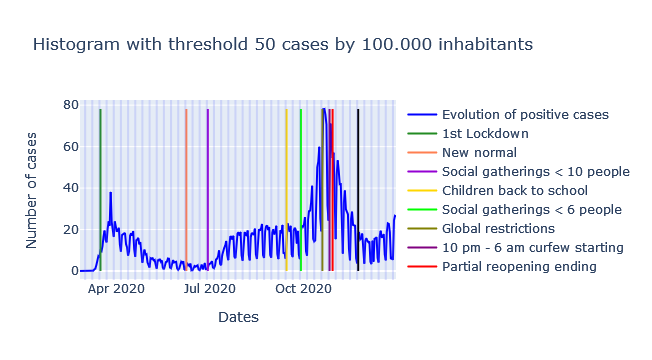

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 299, which represents 80.2%
First 5 ABSs to surpass threshold 100 are ABS {347: '["VALL D\'EN BAS"]', 129: "['LA GRANADELLA']", 8: "['ARBÚCIES/SANT HILARI']", 50: "['BARCELONA 6-D']", 78: "['BARCELONA 10-H']"} with first date 03/20/2020


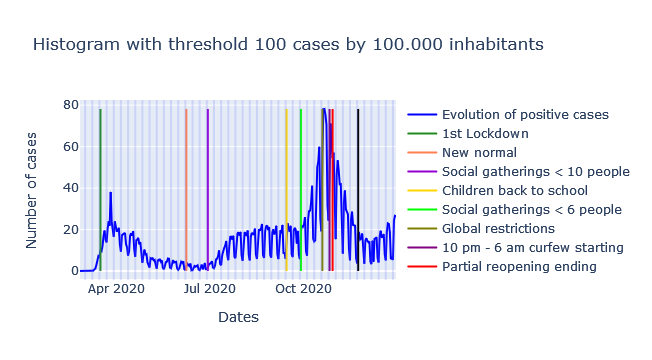

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 75, which represents 20.1%
First 5 ABSs to surpass threshold 200 are ABS {204: "['SANT BOI DE LLOBREGAT 3']", 218: '["SANT SADURNÍ D\'ANOIA"]', 228: "['SANTA COLOMA DE QUERALT']", 88: "['CALAF']", 213: "['SANT JOAN DESPÍ 1']"} with first date 03/28/2020


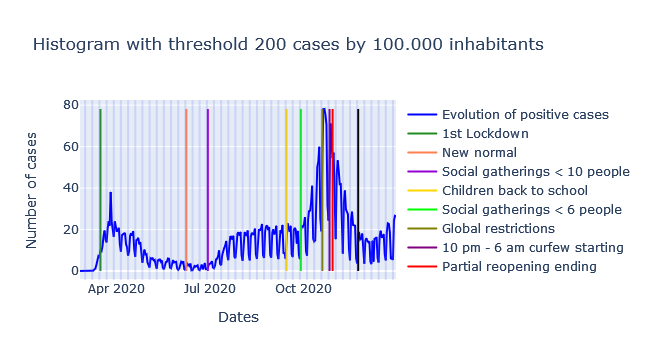

In [39]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_no_missing_dates.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates.CODIABS == j
        df = first_wave_no_missing_dates[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[no_missing_waves_2021_first_wave.DATA_parsed.min(), no_missing_waves_2021_first_wave.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    no_missing_waves_2021_first_wavegp = first_wave_no_missing_dates.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
#     print(first_wave_no_missing_dates['DATA_parsed'])
#     print(first_wave_no_missing_dates['DATA_parsed'].dtypes)

#     break
    no_missing_waves_2021_first_wavegp['population'] = int(population)
    no_missing_waves_2021_first_wavegp['100hab'] = 100000
    no_missing_waves_2021_first_wavegp['proves100hab'] = (no_missing_waves_2021_first_wavegp['100hab'] * no_missing_waves_2021_first_wavegp['NUM_PROVES']) / no_missing_waves_2021_first_wavegp['population']
    no_missing_waves_2021_first_wavegp['weekend'] = np.where((no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 5) | (no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp['DATA_parsed'], y=no_missing_waves_2021_first_wavegp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp.DATA_parsed ,y = no_missing_waves_2021_first_wavegp.proves100hab, line_color = 'blue', name ='Evolution of positive cases'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    # hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    # hist.update_layout(showlegend = False, xaxis_range=[no_missing_waves_2021_first_wave.DATA_parsed.min(), no_missing_waves_2021_first_wave.DATA_parsed.max()])
    # fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    dmin = no_missing_waves_2021_first_wavegp.proves100hab.min()
    dmax = no_missing_waves_2021_first_wavegp.proves100hab.max()
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 3, 16)), np.datetime64(datetime.datetime(2020, 3, 16))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='forestgreen', width=2),
                             name='1st Lockdown'))
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 6, 8)), np.datetime64(datetime.datetime(2020, 6, 8))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='coral', width=2),
                             name='New normal'))

    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 6, 29)), np.datetime64(datetime.datetime(2020, 6, 29))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='darkviolet', width=2),
                             name='Social gatherings < 10 people'))
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 9, 14)), np.datetime64(datetime.datetime(2020, 9, 14))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='gold', width=2),
                             name='Children back to school'))
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 9, 28)), np.datetime64(datetime.datetime(2020, 9, 28))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='lime', width=2),
                             name='Social gatherings < 6 people'))
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 10, 19)), np.datetime64(datetime.datetime(2020, 10, 19))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='olive', width=2),
                             name='Global restrictions'))
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 10, 26)), np.datetime64(datetime.datetime(2020, 10, 26))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='purple', width=2),
                             name='10 pm - 6 am curfew starting'))
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 10, 29)), np.datetime64(datetime.datetime(2020, 10, 29))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='red', width=2),
                             name='Partial reopening ending'))
    
    fig.add_trace(go.Scatter(x=[np.datetime64(datetime.datetime(2020, 11, 23)), np.datetime64(datetime.datetime(2020, 11, 23))],
                             y = [dmin,dmax],
                             mode='lines', 
                             line=dict(color='black', width=2),
                             name='Partial reopening'))
    fig.update_layout(showlegend=True, legend_traceorder="normal")
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
#     fig = px.line()
#     fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
#     for l in min_kabs_l:
#         filterABS = no_missing_waves_2021_first_wave.CODIABS == l
#         df = no_missing_waves_2021_first_wave[filterABS]
#         filternameabs = abstors.ABS1 == l
#         nameabs = abstors[filternameabs]
#         nameabs = str(nameabs.ABS2.values)
#         fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
#     fig.update_layout(legend=dict(
#         orientation = 'h',
#         yanchor="bottom",
#         y=1.02,
#         xanchor="right",
#         x=1))
#     fig.show()

# # if we take into accunt first threshold, lleida province is clearly when second wave started earlier

## First wave daily analysis

In [40]:
first_wave_pcrs_filter = pcrs['DATA_parsed'] < pd.to_datetime('2020-06-15').date()
first_wave_no_missing_dates_filter = no_missing_dates['DATA_parsed'] < '2020-06-15'

In [41]:
# first_wave_pcrs = pcrs[first_wave_pcrs_filter]
# pcrs.shape, first_wave_pcrs.shape

In [42]:
first_wave_no_missing_dates = no_missing_dates[first_wave_no_missing_dates_filter]
no_missing_dates.shape, first_wave_no_missing_dates.shape

((229768, 6), (41403, 6))

In [43]:
first_wave_no_missing_dates.cases100hab.max()

455.7885141294439

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 239, which represents 64.1%
First 5 ABSs to surpass threshold 50 are ABS {269: "['VILANOVA DEL CAMÍ']", 371: "['IGUALADA-1']", 372: "['IGUALADA-2']", 127: "['GIRONA 4']", 272: "['BADALONA 1']"} with first date 03/14/2020


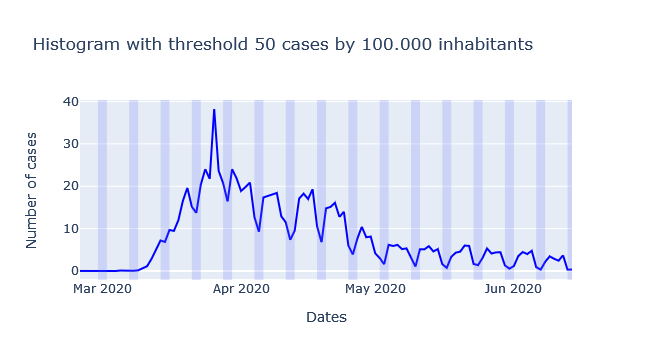

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 77, which represents 20.6%
First 5 ABSs to surpass threshold 100 are ABS {347: '["VALL D\'EN BAS"]', 129: "['LA GRANADELLA']", 8: "['ARBÚCIES/SANT HILARI']", 50: "['BARCELONA 6-D']", 78: "['BARCELONA 10-H']"} with first date 03/20/2020


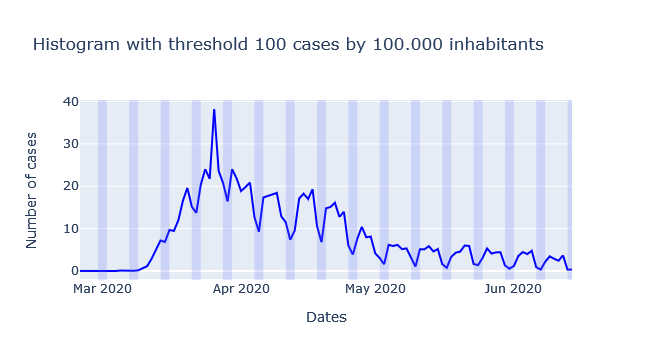

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 18, which represents 4.8%
First 5 ABSs to surpass threshold 200 are ABS {204: "['SANT BOI DE LLOBREGAT 3']", 218: '["SANT SADURNÍ D\'ANOIA"]', 228: "['SANTA COLOMA DE QUERALT']", 88: "['CALAF']", 213: "['SANT JOAN DESPÍ 1']"} with first date 03/28/2020


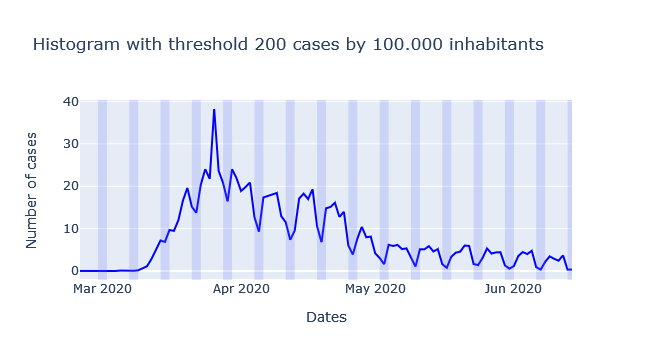

In [44]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_no_missing_dates.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates.CODIABS == j
        df = first_wave_no_missing_dates[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[no_missing_waves_2021_first_wave.DATA_parsed.min(), no_missing_waves_2021_first_wave.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    no_missing_waves_2021_first_wavegp = first_wave_no_missing_dates.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    no_missing_waves_2021_first_wavegp['population'] = int(population)
    no_missing_waves_2021_first_wavegp['100hab'] = 100000
    no_missing_waves_2021_first_wavegp['proves100hab'] = (no_missing_waves_2021_first_wavegp['100hab'] * no_missing_waves_2021_first_wavegp['NUM_PROVES']) / no_missing_waves_2021_first_wavegp['population']
    no_missing_waves_2021_first_wavegp['weekend'] = np.where((no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 5) | (no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp['DATA_parsed'], y=no_missing_waves_2021_first_wavegp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp.DATA_parsed ,y = no_missing_waves_2021_first_wavegp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    # hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    # hist.update_layout(showlegend = False, xaxis_range=[no_missing_waves_2021_first_wave.DATA_parsed.min(), no_missing_waves_2021_first_wave.DATA_parsed.max()])
    # fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
#     fig = px.line()
#     fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
#     for l in min_kabs_l:
#         filterABS = no_missing_waves_2021_first_wave.CODIABS == l
#         df = no_missing_waves_2021_first_wave[filterABS]
#         filternameabs = abstors.ABS1 == l
#         nameabs = abstors[filternameabs]
#         nameabs = str(nameabs.ABS2.values)
#         fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
#     fig.update_layout(legend=dict(
#         orientation = 'h',
#         yanchor="bottom",
#         y=1.02,
#         xanchor="right",
#         x=1))
#     fig.show()

# # if we take into accunt first threshold, lleida province is clearly when second wave started earlier

In [45]:
first_wave_no_missing_dates.DATA_parsed.nunique()

111

Threshold 50 cases by 100.000 population
There are 239 ABS that surpass threshold 50, which represents 64.1%
First 5 ABSs to surpass threshold 50 are ABS {269: "['VILANOVA DEL CAMÍ']", 371: "['IGUALADA-1']", 372: "['IGUALADA-2']", 127: "['GIRONA 4']", 272: "['BADALONA 1']"} with first date 03/14/2020


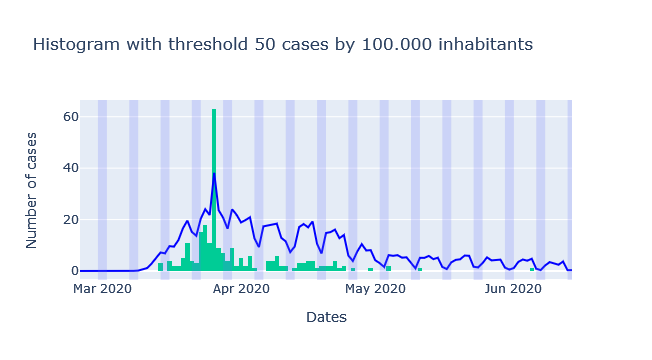

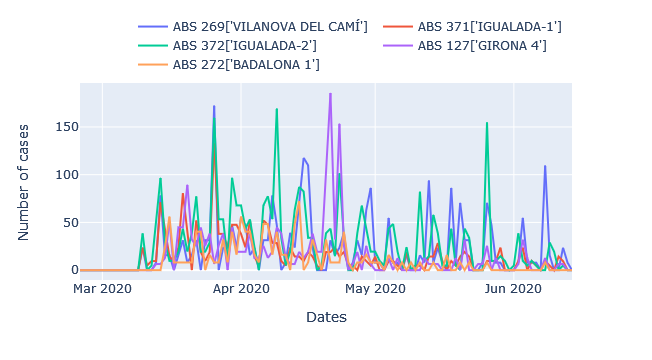

Threshold 100 cases by 100.000 population
There are 77 ABS that surpass threshold 100, which represents 20.6%
First 5 ABSs to surpass threshold 100 are ABS {347: '["VALL D\'EN BAS"]', 129: "['LA GRANADELLA']", 8: "['ARBÚCIES/SANT HILARI']", 50: "['BARCELONA 6-D']", 78: "['BARCELONA 10-H']"} with first date 03/20/2020


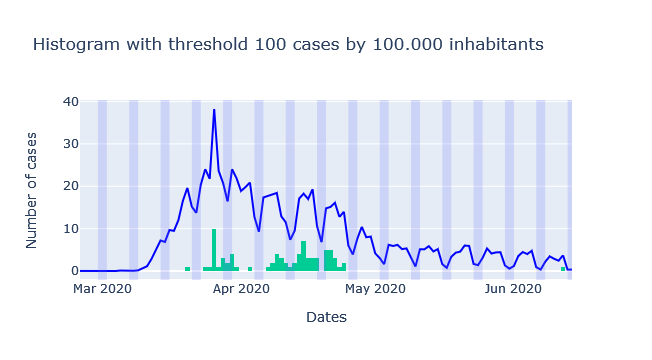

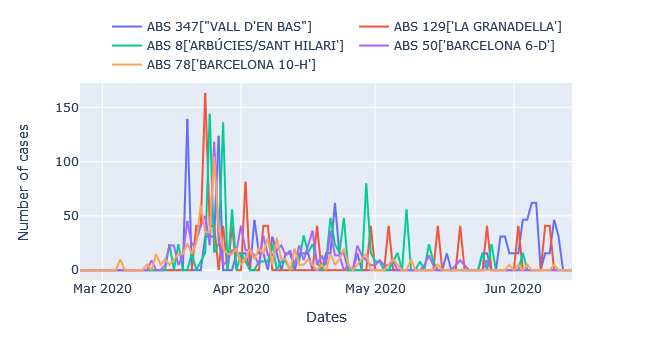

Threshold 200 cases by 100.000 population
There are 18 ABS that surpass threshold 200, which represents 4.8%
First 5 ABSs to surpass threshold 200 are ABS {204: "['SANT BOI DE LLOBREGAT 3']", 218: '["SANT SADURNÍ D\'ANOIA"]', 228: "['SANTA COLOMA DE QUERALT']", 88: "['CALAF']", 213: "['SANT JOAN DESPÍ 1']"} with first date 03/28/2020


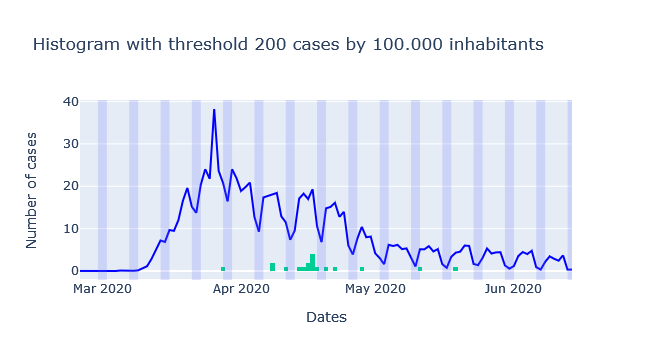

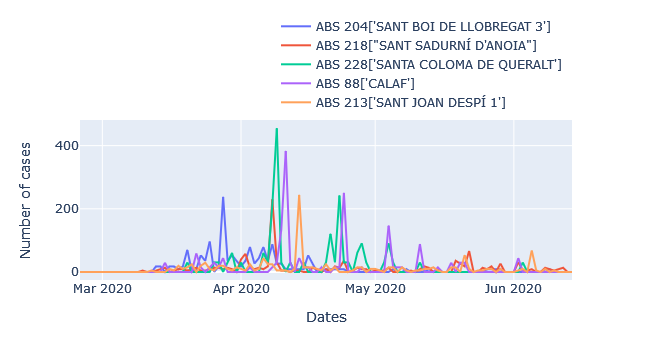

In [46]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_no_missing_dates.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates.CODIABS == j
        df = first_wave_no_missing_dates[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('There are ' +str(len(datesbyabsthreshold)) + ' ABS that surpass threshold ' + str(i)  + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)    
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_datesgp = first_wave_no_missing_dates.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_datesgp['population'] = int(population)
    first_wave_no_missing_datesgp['100hab'] = 100000
    first_wave_no_missing_datesgp['proves100hab'] = (first_wave_no_missing_datesgp['100hab'] * first_wave_no_missing_datesgp['NUM_PROVES']) / first_wave_no_missing_datesgp['population']
    first_wave_no_missing_datesgp['weekend'] = np.where((first_wave_no_missing_datesgp.DATA_parsed.dt.weekday == 5) | (first_wave_no_missing_datesgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_datesgp['DATA_parsed'], y=first_wave_no_missing_datesgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_datesgp.DATA_parsed ,y = first_wave_no_missing_datesgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_datesgp.DATA_parsed.min(), first_wave_no_missing_datesgp.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid (from 26/02/2020 until 14/06/2021)')
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates.CODIABS == l
        df = first_wave_no_missing_dates[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

    
# if we take into accound first threshold 50, Igualada is clearly the place where it had more cases since the beggining
# second threshold selva comarca

## Second wave daily analysis

In [47]:
second_wave_no_missing_dates = no_missing_dates[~first_wave_no_missing_dates_filter]
filter_second_wave_no_missing_dates = second_wave_no_missing_dates['DATA_parsed'] < '2021-01-01'
second_wave_no_missing_dates = second_wave_no_missing_dates[filter_second_wave_no_missing_dates]
no_missing_dates.shape, second_wave_no_missing_dates.shape

((229768, 6), (74600, 6))

In [48]:
second_wave_no_missing_dates.cases100hab.max()

1222.7222552432709

In [49]:
second_wave_no_missing_dates.DATA_parsed.nunique()

200

In [50]:
second_wave_no_missing_dates

,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
111,2020-06-15,1,0,0,0,0.000000
112,2020-06-16,1,0,0,0,0.000000
113,2020-06-17,1,0,0,0,0.000000
114,2020-06-18,1,6495,1,100000,15.396459
115,2020-06-19,1,0,0,0,0.000000
...,...,...,...,...,...,...
229458,2020-12-27,403,29403,1,100000,3.401014
229459,2020-12-28,403,29403,8,100000,27.208108
229460,2020-12-29,403,29403,10,100000,34.010135
229461,2020-12-30,403,29403,17,100000,57.817230


In [51]:
[second_wave_no_missing_dates.DATA_parsed.min(), second_wave_no_missing_dates.DATA_parsed.max()]

[Timestamp('2020-06-15 00:00:00'), Timestamp('2020-12-31 00:00:00')]

In [52]:
second_wave_no_missing_dates = no_missing_dates[~first_wave_no_missing_dates_filter]
filter_second_wave_no_missing_dates = second_wave_no_missing_dates['DATA_parsed'] < '2021-01-01'
second_wave_no_missing_dates_ = second_wave_no_missing_dates[filter_second_wave_no_missing_dates]
no_missing_waves_2021 = second_wave_no_missing_dates[~filter_second_wave_no_missing_dates]
no_missing_dates.shape, no_missing_waves_2021.shape

((229768, 6), (113765, 6))

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 373, which represents 100.0%
First 5 ABSs to surpass threshold 50 are ABS {96: "['CARDONA']", 350: "['VIC-1 NORD']", 128: "['BAIX BERGUEDÀ']", 130: "['ALT BERGUEDÀ']", 379: "['LLEIDA 7 ONZE DE SETEMBRE']"} with first date 06/16/2020


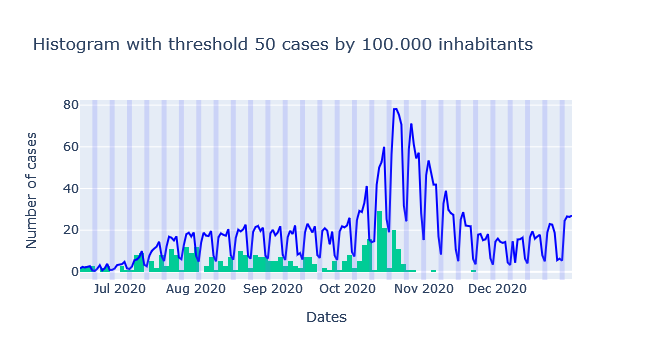

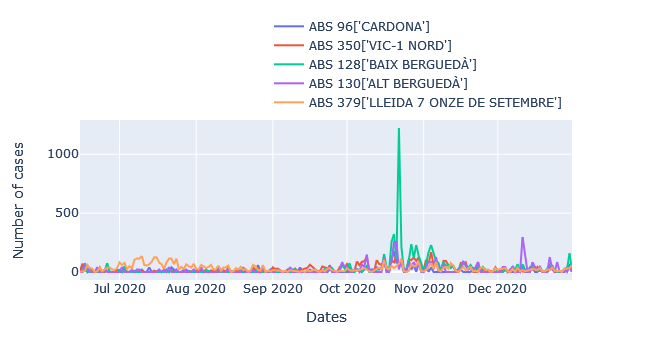

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 273, which represents 73.2%
First 5 ABSs to surpass threshold 100 are ABS {232: "['SERÒS']", 2: "['ALCARRÀS']", 135: "['LLEIDA 1 CENTRE HISTÒRIC-RAMBLA FERRAN']", 180: "['ALTA RIBAGORÇA']", 379: "['LLEIDA 7 ONZE DE SETEMBRE']"} with first date 06/26/2020


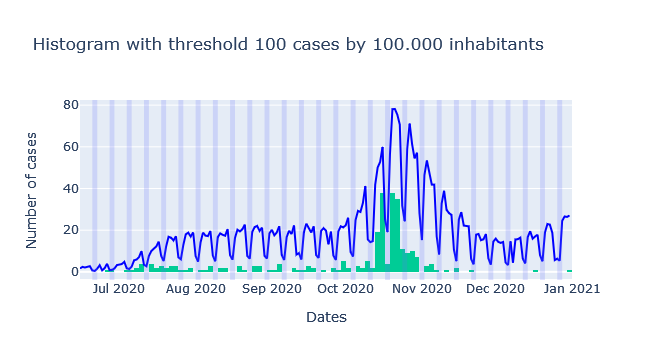

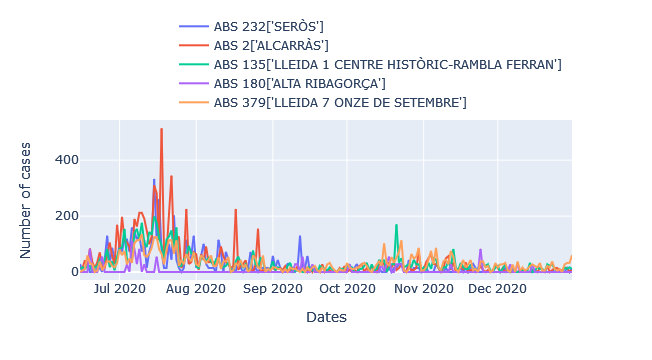

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 62, which represents 16.6%
First 5 ABSs to surpass threshold 200 are ABS {169: "['ALT URGELL-SUD']", 2: "['ALCARRÀS']", 334: "['ALMACELLES']", 232: "['SERÒS']", 329: "['LLEIDA RURAL 2-SUD']"} with first date 07/08/2020


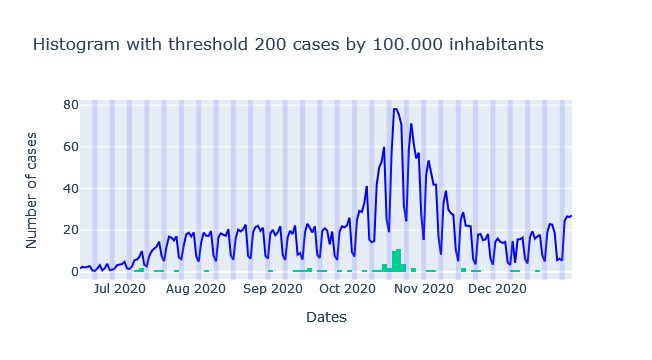

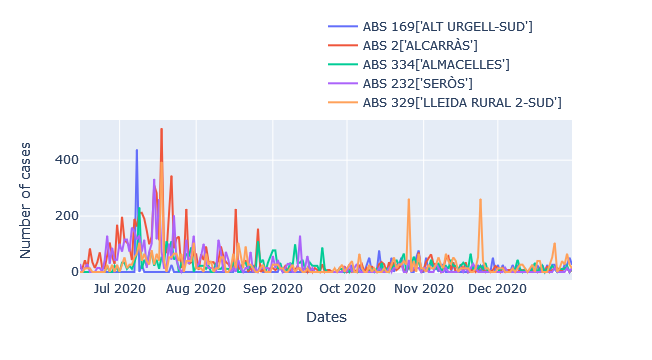

In [53]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_wave_no_missing_dates_.CODIABS.unique()
    for j in abss:
        filterabs = second_wave_no_missing_dates_.CODIABS == j
        df = second_wave_no_missing_dates_[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_.DATA_parsed.min(), second_wave_no_missing_dates_.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_gp = second_wave_no_missing_dates_.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_gp['population'] = int(population)
    second_wave_no_missing_dates_gp['100hab'] = 100000
    second_wave_no_missing_dates_gp['proves100hab'] = (second_wave_no_missing_dates_gp['100hab'] * second_wave_no_missing_dates_gp['NUM_PROVES']) / second_wave_no_missing_dates_gp['population']
    second_wave_no_missing_dates_gp['weekend'] = np.where((second_wave_no_missing_dates_gp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_gp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_gp['DATA_parsed'], y=second_wave_no_missing_dates_gp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_gp.DATA_parsed ,y = second_wave_no_missing_dates_gp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_.DATA_parsed.min(), second_wave_no_missing_dates_.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates_.CODIABS == l
        df = second_wave_no_missing_dates_[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

## First WAVE 2021

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 373, which represents 100.0%
First 5 ABSs to surpass threshold 50 are ABS {130: "['ALT BERGUEDÀ']", 187: "['RIPOLL-SANT JOAN DE LES ABADESSES']", 324: '["VANDELLÒS I L\'HOSPITALET DE L\'INFANT"]', 81: "['BELLPUIG']", 96: "['CARDONA']"} with first date 01/01/2021


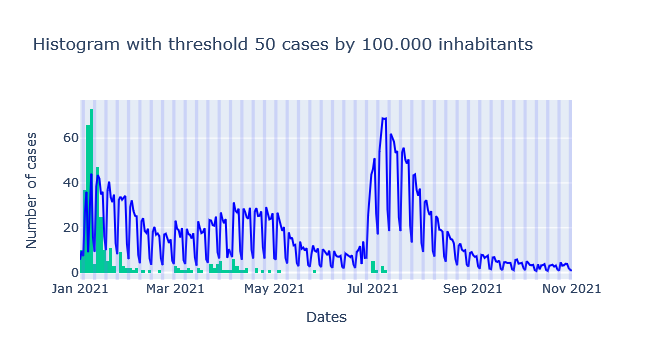

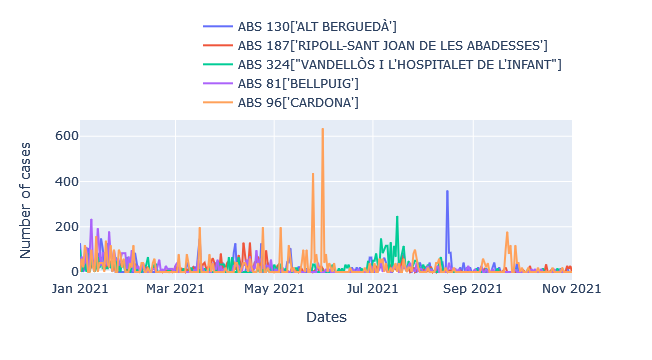

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 282, which represents 75.6%
First 5 ABSs to surpass threshold 100 are ABS {130: "['ALT BERGUEDÀ']", 169: "['ALT URGELL-SUD']", 333: "['ALT CAMP OEST']", 354: "['LA SELVA DEL CAMP']", 96: "['CARDONA']"} with first date 01/01/2021


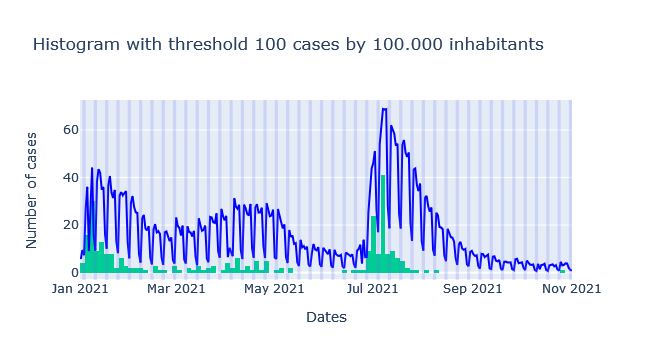

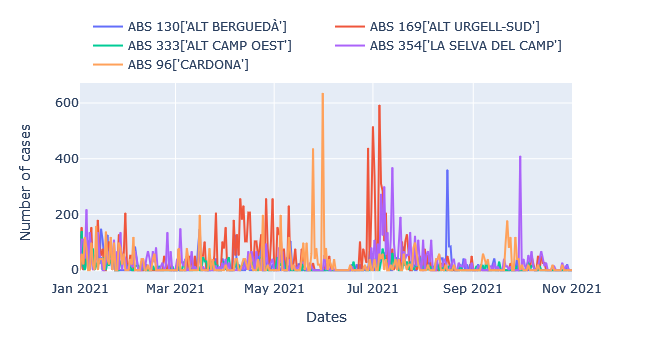

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 61, which represents 16.4%
First 5 ABSs to surpass threshold 200 are ABS {354: "['LA SELVA DEL CAMP']", 81: "['BELLPUIG']", 86: "['LES BORGES BLANQUES']", 128: "['BAIX BERGUEDÀ']", 236: "['EL SOLSONÈS']"} with first date 01/05/2021


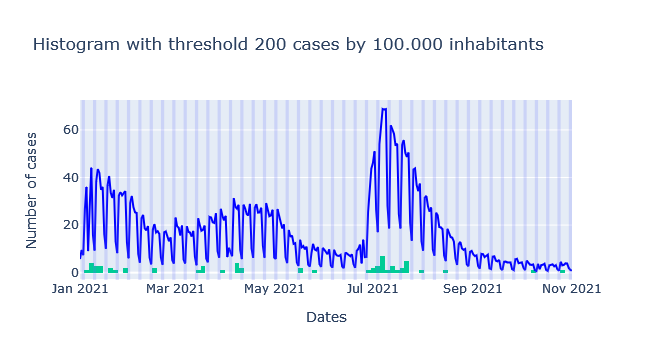

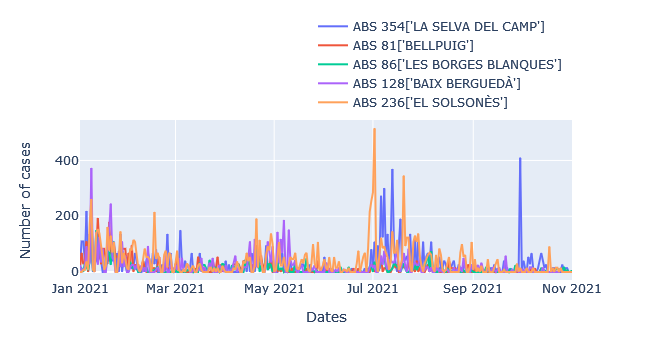

In [54]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = no_missing_waves_2021.CODIABS.unique()
    for j in abss:
        filterabs = no_missing_waves_2021.CODIABS == j
        df = no_missing_waves_2021[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[no_missing_waves_2021_first_wave.DATA_parsed.min(), no_missing_waves_2021_first_wave.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    no_missing_waves_2021_first_wavegp = no_missing_waves_2021.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    no_missing_waves_2021_first_wavegp['population'] = int(population)
    no_missing_waves_2021_first_wavegp['100hab'] = 100000
    no_missing_waves_2021_first_wavegp['proves100hab'] = (no_missing_waves_2021_first_wavegp['100hab'] * no_missing_waves_2021_first_wavegp['NUM_PROVES']) / no_missing_waves_2021_first_wavegp['population']
    no_missing_waves_2021_first_wavegp['weekend'] = np.where((no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 5) | (no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp['DATA_parsed'], y=no_missing_waves_2021_first_wavegp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp.DATA_parsed ,y = no_missing_waves_2021_first_wavegp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[no_missing_waves_2021.DATA_parsed.min(), no_missing_waves_2021.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.update_traces(showlegend=False,row = 1, col = 1)
    fig.show()
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = no_missing_waves_2021.CODIABS == l
        df = no_missing_waves_2021[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

In [55]:
no_missing_waves_2021_filter_first_wave = no_missing_waves_2021['DATA_parsed'] < '2021-02-20'
no_missing_waves_2021_first_wave = no_missing_waves_2021[no_missing_waves_2021_filter_first_wave]

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 313, which represents 83.9%
First 5 ABSs to surpass threshold 50 are ABS {130: "['ALT BERGUEDÀ']", 187: "['RIPOLL-SANT JOAN DE LES ABADESSES']", 324: '["VANDELLÒS I L\'HOSPITALET DE L\'INFANT"]', 81: "['BELLPUIG']", 96: "['CARDONA']"} with first date 01/01/2021


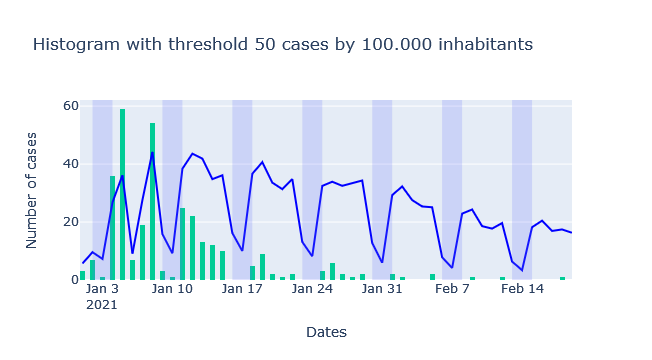

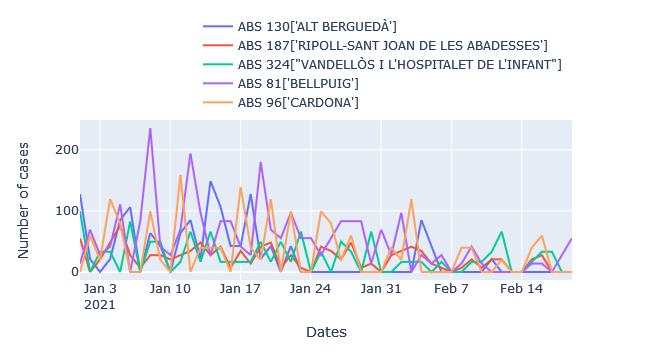

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 110, which represents 29.5%
First 5 ABSs to surpass threshold 100 are ABS {130: "['ALT BERGUEDÀ']", 169: "['ALT URGELL-SUD']", 333: "['ALT CAMP OEST']", 354: "['LA SELVA DEL CAMP']", 96: "['CARDONA']"} with first date 01/01/2021


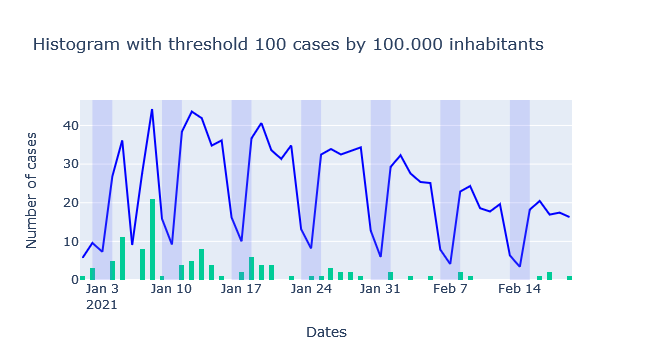

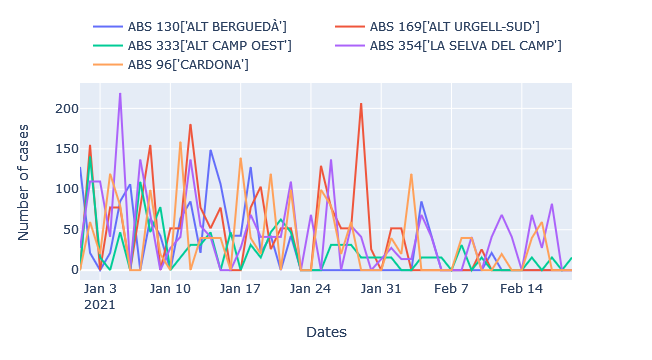

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 18, which represents 4.8%
First 5 ABSs to surpass threshold 200 are ABS {354: "['LA SELVA DEL CAMP']", 81: "['BELLPUIG']", 86: "['LES BORGES BLANQUES']", 128: "['BAIX BERGUEDÀ']", 236: "['EL SOLSONÈS']"} with first date 01/05/2021


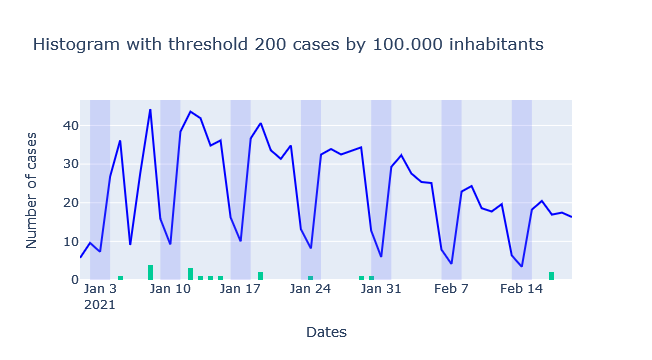

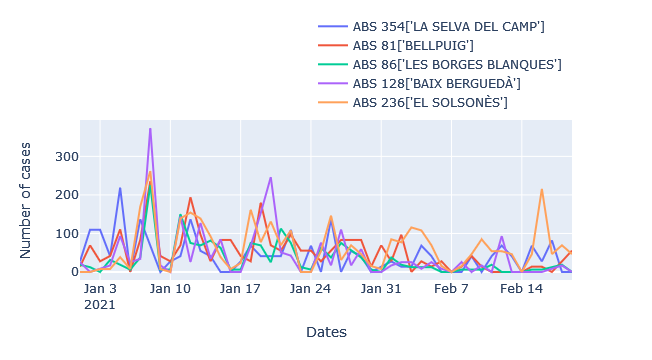

In [56]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = no_missing_waves_2021_first_wave.CODIABS.unique()
    for j in abss:
        filterabs = no_missing_waves_2021_first_wave.CODIABS == j
        df = no_missing_waves_2021_first_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[no_missing_waves_2021_first_wave.DATA_parsed.min(), no_missing_waves_2021_first_wave.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    no_missing_waves_2021_first_wavegp = no_missing_waves_2021_first_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    no_missing_waves_2021_first_wavegp['population'] = int(population)
    no_missing_waves_2021_first_wavegp['100hab'] = 100000
    no_missing_waves_2021_first_wavegp['proves100hab'] = (no_missing_waves_2021_first_wavegp['100hab'] * no_missing_waves_2021_first_wavegp['NUM_PROVES']) / no_missing_waves_2021_first_wavegp['population']
    no_missing_waves_2021_first_wavegp['weekend'] = np.where((no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 5) | (no_missing_waves_2021_first_wavegp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp['DATA_parsed'], y=no_missing_waves_2021_first_wavegp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_first_wavegp.DATA_parsed ,y = no_missing_waves_2021_first_wavegp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[no_missing_waves_2021_first_wave.DATA_parsed.min(), no_missing_waves_2021_first_wave.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.update_traces(showlegend=False,
                  row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = no_missing_waves_2021_first_wave.CODIABS == l
        df = no_missing_waves_2021_first_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

## Second wave 2021

In [57]:
no_missing_waves_2021.dtypes

DATA_parsed    datetime64[ns]
CODIABS                 int64
NUM_INDIV               int64
NUM_PROVES              int64
100hab                  int64
cases100hab           float64
dtype: object

In [58]:
no_missing_waves_2021_second_wave = no_missing_waves_2021[~no_missing_waves_2021_filter_first_wave]
no_missing_waves_2021_second_wave_filter = no_missing_waves_2021_second_wave['DATA_parsed'] < '2021-06-06'
no_missing_waves_2021_second_wave_2 = no_missing_waves_2021_second_wave[no_missing_waves_2021_second_wave_filter]
no_missing_waves_2021_third_wave = no_missing_waves_2021_second_wave[~no_missing_waves_2021_second_wave_filter]

In [59]:
no_missing_waves_2021_second_wave_2

,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
361,2021-02-20,1,6495,3,100000,46.189376
362,2021-02-21,1,0,0,0,0.000000
363,2021-02-22,1,6495,1,100000,15.396459
364,2021-02-23,1,0,0,0,0.000000
365,2021-02-24,1,0,0,0,0.000000
...,...,...,...,...,...,...
229614,2021-06-01,403,29403,4,100000,13.604054
229615,2021-06-02,403,29403,3,100000,10.203041
229616,2021-06-03,403,29403,2,100000,6.802027
229617,2021-06-04,403,29403,1,100000,3.401014


Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 285, which represents 76.4%
First 5 ABSs to surpass threshold 50 are ABS {7: "['ARAN']", 98: "['MONTSERRAT']", 144: "['MANLLEU']", 10: "['ARGENTONA']", 11: "['ARTÉS']"} with first date 02/20/2021


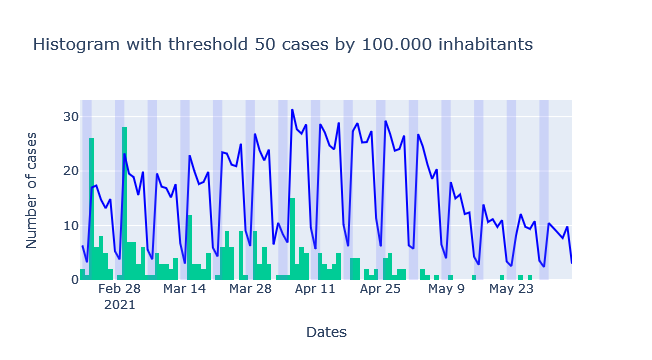

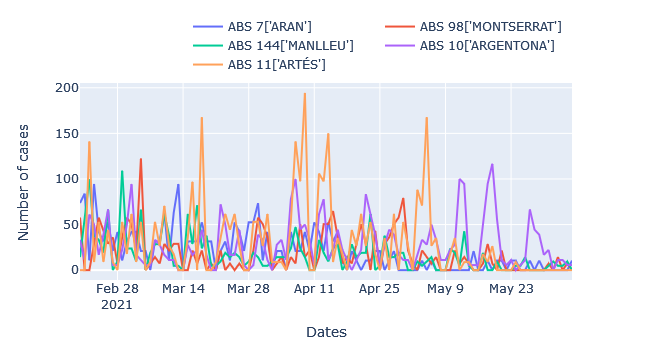

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 102, which represents 27.3%
First 5 ABSs to surpass threshold 100 are ABS {11: "['ARTÉS']", 159: "['MOIÀ']", 254: "['VALL DEL GES']", 377: "['RODA DE TER']", 211: "['NAVARCLES - SANT FRUITÓS DE BAGES']"} with first date 02/22/2021


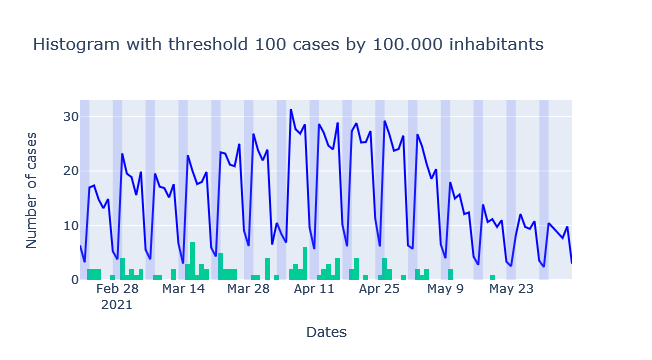

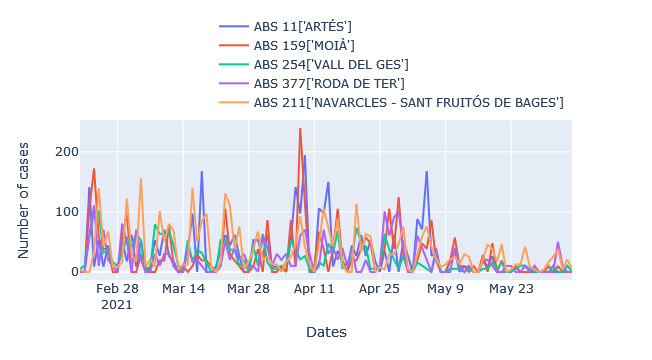

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 21, which represents 5.6%
First 5 ABSs to surpass threshold 200 are ABS {217: "['SANT QUIRZE DE BESORA']", 233: '["LA SEU D\'URGELL"]', 102: "['CENTELLES']", 92: "['CAMPRODON']", 162: "['MONTBLANC']"} with first date 03/09/2021


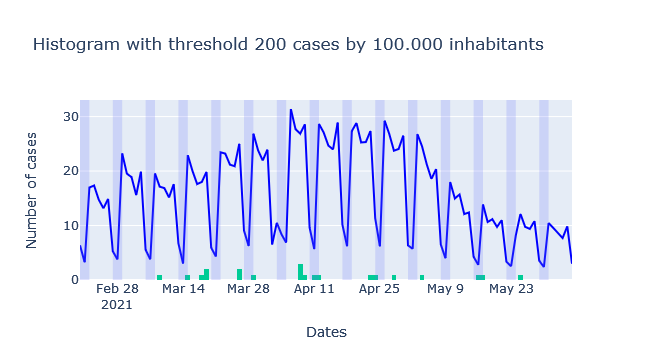

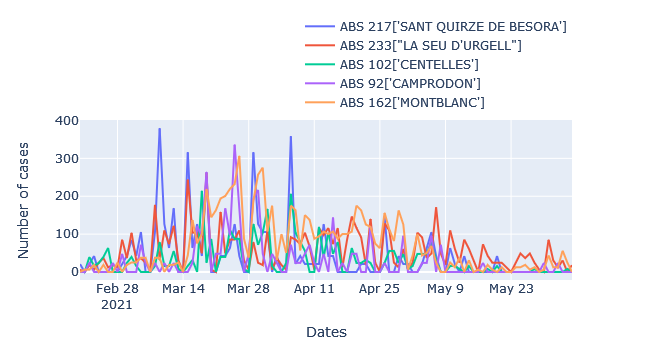

In [60]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = no_missing_waves_2021_second_wave_2.CODIABS.unique()
    for j in abss:
        filterabs = no_missing_waves_2021_second_wave_2.CODIABS == j
        df = no_missing_waves_2021_second_wave_2[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[no_missing_waves_2021_second_wave.DATA_parsed.min(), no_missing_waves_2021_second_wave.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    no_missing_waves_2021_second_wavegp = no_missing_waves_2021_second_wave_2.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    no_missing_waves_2021_second_wavegp['population'] = int(population)
    no_missing_waves_2021_second_wavegp['100hab'] = 100000
    no_missing_waves_2021_second_wavegp['proves100hab'] = (no_missing_waves_2021_second_wavegp['100hab'] * no_missing_waves_2021_second_wavegp['NUM_PROVES']) / no_missing_waves_2021_second_wavegp['population']
    no_missing_waves_2021_second_wavegp['weekend'] = np.where((no_missing_waves_2021_second_wavegp.DATA_parsed.dt.weekday == 5) | (no_missing_waves_2021_second_wavegp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_second_wavegp['DATA_parsed'], y=no_missing_waves_2021_second_wavegp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_second_wavegp.DATA_parsed ,y = no_missing_waves_2021_second_wavegp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[no_missing_waves_2021_second_wave.DATA_parsed.min(), no_missing_waves_2021_second_wave.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.update_traces(showlegend=False,
                  row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = no_missing_waves_2021_second_wave_2.CODIABS == l
        df = no_missing_waves_2021_second_wave_2[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

## Third wave 2021

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 367, which represents 98.4%
First 5 ABSs to surpass threshold 50 are ABS {228: "['SANTA COLOMA DE QUERALT']", 87: "['LES BORGES DEL CAMP']", 174: "['PALLARS SOBIRÀ']", 193: "['SABADELL 3A']", 236: "['EL SOLSONÈS']"} with first date 06/06/2021


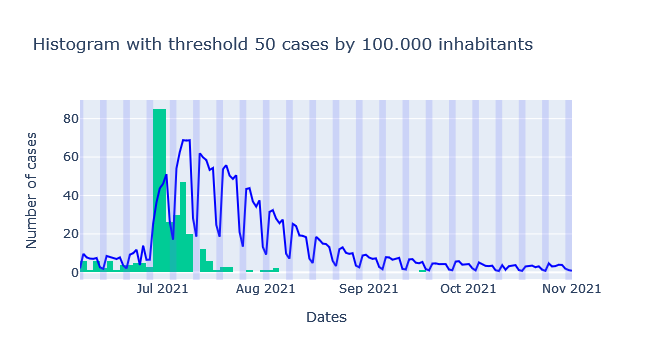

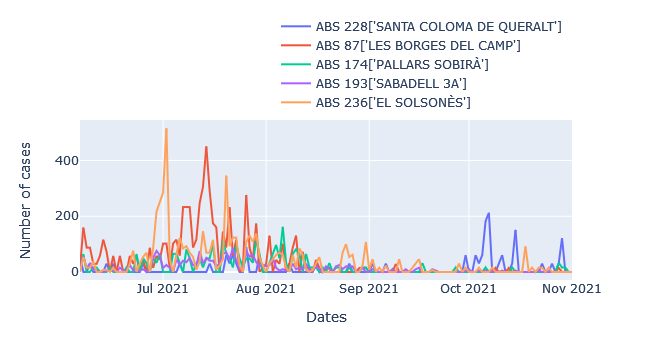

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 213, which represents 57.1%
First 5 ABSs to surpass threshold 100 are ABS {87: "['LES BORGES DEL CAMP']", 338: "['PIERA']", 272: "['BADALONA 1']", 177: "['PERALADA']", 83: "['BESALÚ']"} with first date 06/07/2021


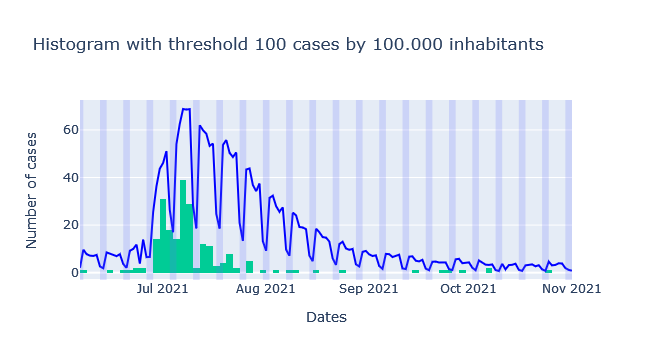

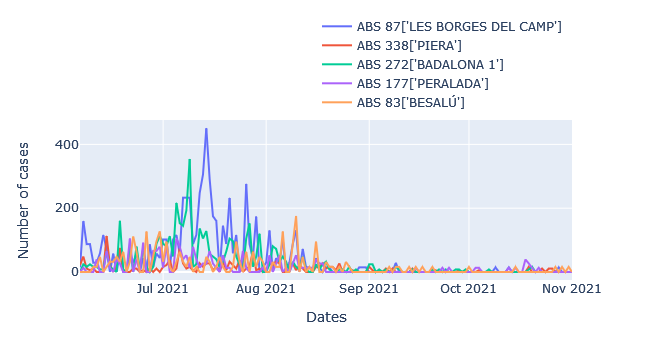

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 36, which represents 9.7%
First 5 ABSs to surpass threshold 200 are ABS {112: "['CORNUDELLA DE MONTSANT']", 169: "['ALT URGELL-SUD']", 190: "['SABADELL 1A']", 236: "['EL SOLSONÈS']", 153: "['MATARÓ 2']"} with first date 06/28/2021


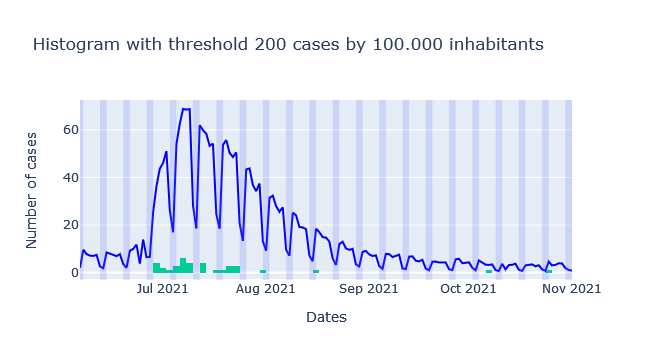

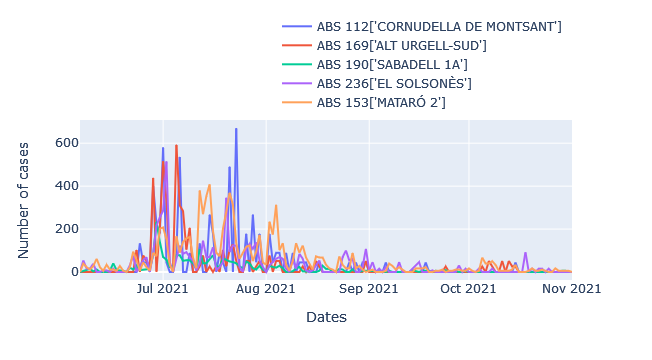

In [61]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = no_missing_waves_2021_third_wave.CODIABS.unique()
    for j in abss:
        filterabs = no_missing_waves_2021_third_wave.CODIABS == j
        df = no_missing_waves_2021_third_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[no_missing_waves_2021_second_wave.DATA_parsed.min(), no_missing_waves_2021_second_wave.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    no_missing_waves_2021_second_wavegp = no_missing_waves_2021_third_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    no_missing_waves_2021_second_wavegp['population'] = int(population)
    no_missing_waves_2021_second_wavegp['100hab'] = 100000
    no_missing_waves_2021_second_wavegp['proves100hab'] = (no_missing_waves_2021_second_wavegp['100hab'] * no_missing_waves_2021_second_wavegp['NUM_PROVES']) / no_missing_waves_2021_second_wavegp['population']
    no_missing_waves_2021_second_wavegp['weekend'] = np.where((no_missing_waves_2021_second_wavegp.DATA_parsed.dt.weekday == 5) | (no_missing_waves_2021_second_wavegp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_second_wavegp['DATA_parsed'], y=no_missing_waves_2021_second_wavegp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=no_missing_waves_2021_second_wavegp.DATA_parsed ,y = no_missing_waves_2021_second_wavegp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[no_missing_waves_2021_second_wave.DATA_parsed.min(), no_missing_waves_2021_second_wave.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = no_missing_waves_2021_third_wave.CODIABS == l
        df = no_missing_waves_2021_third_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

In [62]:
pop100 = 100000
abspop = 20000
for i in threshs:
    temp = abspop * i
    temp2 = temp / pop100
    print('Threshold ' + str(i) + ' represents ' + str(temp2) + ' in a normal ABS with population ' + str(abspop))

Threshold 50 represents 10.0 in a normal ABS with population 20000
Threshold 100 represents 20.0 in a normal ABS with population 20000
Threshold 200 represents 40.0 in a normal ABS with population 20000


# ANALYSIS BARCELONA PROVINCE

## First wave

### First wave all province

In [63]:
RSdata = pd.read_csv('ABStoRS.csv', sep=',')
RSdata.RS2.unique()
provBCN = RSdata.loc[(RSdata['RS2']=='BARCELONA') | (RSdata['RS2']== 'CATALUNYA CENTRAL')]
provBCN['ABS1'] = provBCN['ABS1'].astype(str).str.zfill(3)
provBCN['ABS1'] = provBCN['ABS1'].astype(int)
provBCN = provBCN[['ABS1', 'ABS2']]
print(provBCN.ABS1.nunique())
provBCN = provBCN.groupby(['ABS1']).size().reset_index()
ABS_BCN = provBCN.ABS1.unique() 
first_wave_no_missing_dates_BCN = first_wave_no_missing_dates[first_wave_no_missing_dates['CODIABS'].isin(ABS_BCN)]
first_wave_no_missing_dates.shape, first_wave_no_missing_dates_BCN.shape
# ABS_BCN, first_wave_no_missing_dates['CODIABS'].dtypes

257


/tmp/ipykernel_205/305961077.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_205/305961077.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



((41403, 6), (28527, 6))

Threshold 50 cases by 100.000 population
There are 198 ABS that surpass threshold 50, which represents 77.0%
First 5 ABSs to surpass threshold 50 are ABS {269: "['VILANOVA DEL CAMÍ']", 371: "['IGUALADA-1']", 372: "['IGUALADA-2']", 272: "['BADALONA 1']", 363: "['SANT QUIRZE DEL VALLÈS']"} with first date 03/14/2020


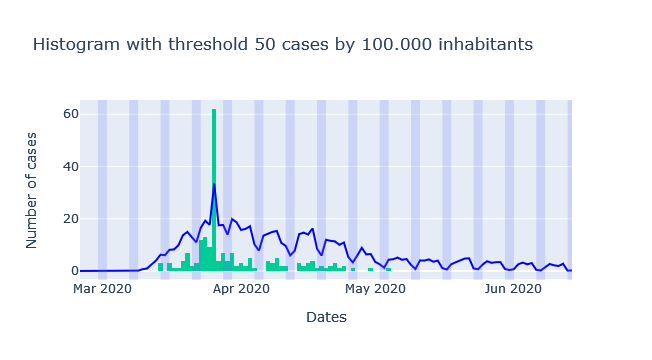

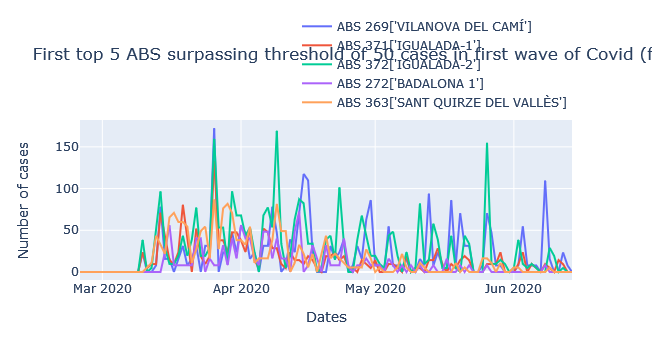

Threshold 100 cases by 100.000 population
There are 65 ABS that surpass threshold 100, which represents 25.3%
First 5 ABSs to surpass threshold 100 are ABS {50: "['BARCELONA 6-D']", 78: "['BARCELONA 10-H']", 79: "['BARCELONA 10-I']", 191: "['SABADELL 1B']", 194: "['SABADELL 3B']"} with first date 03/26/2020


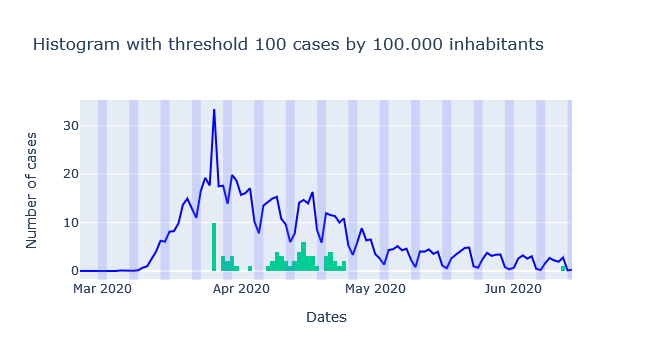

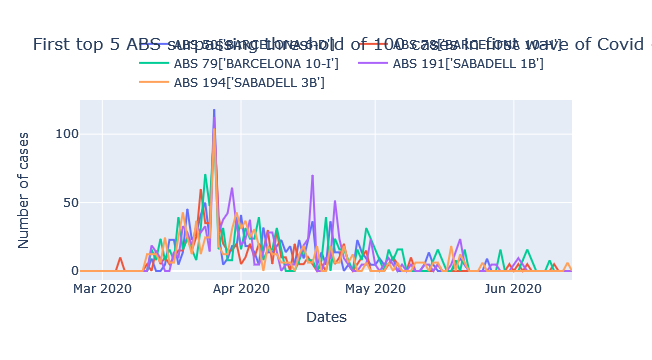

Threshold 200 cases by 100.000 population
There are 15 ABS that surpass threshold 200, which represents 5.8%
First 5 ABSs to surpass threshold 200 are ABS {204: "['SANT BOI DE LLOBREGAT 3']", 218: '["SANT SADURNÍ D\'ANOIA"]', 228: "['SANTA COLOMA DE QUERALT']", 88: "['CALAF']", 213: "['SANT JOAN DESPÍ 1']"} with first date 03/28/2020


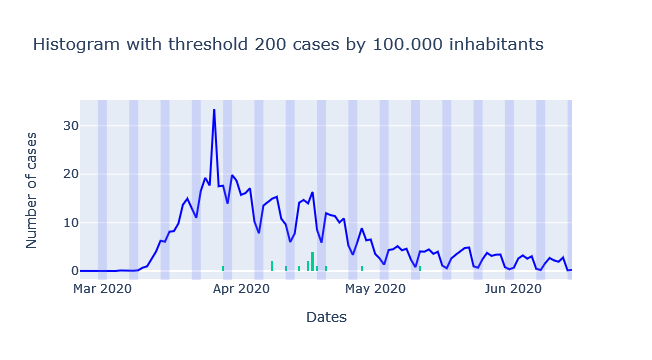

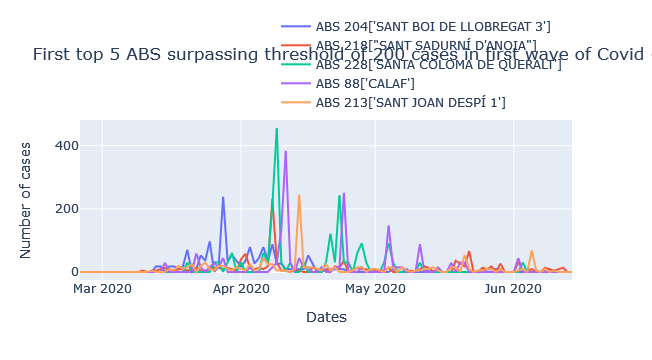

In [64]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_no_missing_dates_BCN.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates_BCN.CODIABS == j
        df = first_wave_no_missing_dates_BCN[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('There are ' +str(len(datesbyabsthreshold)) + ' ABS that surpass threshold ' + str(i)  + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)    
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_dates_BCNgp = first_wave_no_missing_dates_BCN.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_dates_BCNgp['population'] = int(population)
    first_wave_no_missing_dates_BCNgp['100hab'] = 100000
    first_wave_no_missing_dates_BCNgp['proves100hab'] = (first_wave_no_missing_dates_BCNgp['100hab'] * first_wave_no_missing_dates_BCNgp['NUM_PROVES']) / first_wave_no_missing_dates_BCNgp['population']
    first_wave_no_missing_dates_BCNgp['weekend'] = np.where((first_wave_no_missing_dates_BCNgp.DATA_parsed.dt.weekday == 5) | (first_wave_no_missing_dates_BCNgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_BCNgp['DATA_parsed'], y=first_wave_no_missing_dates_BCNgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_BCNgp.DATA_parsed ,y = first_wave_no_missing_dates_BCNgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_dates_BCNgp.DATA_parsed.min(), first_wave_no_missing_dates_BCNgp.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid (from 26/02/2020 until 14/06/2021)')
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates_BCN.CODIABS == l
        df = first_wave_no_missing_dates_BCN[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

    
# if we take into accound first threshold 50, Igualada is clearly the place where it had more cases since the beggining
# second threshold selva comarca

### Barcelona city

In [65]:
BCN_city = absrsss[absrsss['SS2'].str.match('BARCELONA')]
BCN_city_ABS = BCN_city.ABS1.unique()
first_wave_no_missing_dates_BCN_city = first_wave_no_missing_dates_BCN[first_wave_no_missing_dates_BCN['CODIABS'].isin(BCN_city_ABS)]
first_wave_no_missing_dates.shape, first_wave_no_missing_dates_BCN.shape, first_wave_no_missing_dates_BCN_city.shape

((41403, 6), (28527, 6), (7437, 6))

Threshold 50 cases by 100.000 population
There are 54 ABS that surpass threshold 50, which represents 80.6%
When ech ABS surpasses threshold 50?
[["['BARCELONA 6-E']" '03/18/2020']
 ["['BARCELONA 8J']" '03/20/2020']
 ["['BARCELONA 9-C']" '03/23/2020']
 ["['BARCELONA 10-H']" '03/23/2020']
 ["['BARCELONA 10-J']" '03/23/2020']
 ["['BARCELONA 3-C']" '03/24/2020']
 ["['BARCELONA 6-D']" '03/24/2020']
 ["['BARCELONA 10-I']" '03/24/2020']
 ["['BARCELONA 3-I']" '03/24/2020']
 ["['BARCELONA 8-K']" '03/24/2020']
 ["['BARCELONA 8-L']" '03/24/2020']
 ["['BARCELONA 2-A']" '03/25/2020']
 ["['BARCELONA 3-G']" '03/25/2020']
 ["['BARCELONA 7-A']" '03/25/2020']
 ["['BARCELONA 7-B']" '03/25/2020']
 ["['BARCELONA 8-G']" '03/25/2020']
 ["['BARCELONA 1-B']" '03/26/2020']
 ["['BARCELONA 1-D']" '03/26/2020']
 ["['BARCELONA 1-E']" '03/26/2020']
 ["['BARCELONA 3-A']" '03/26/2020']
 ["['BARCELONA 3-E']" '03/26/2020']
 ["['BARCELONA 5-B']" '03/26/2020']
 ["['BARCELONA 5-E']" '03/26/2020']
 ["['BARCELONA 6-A']" '03

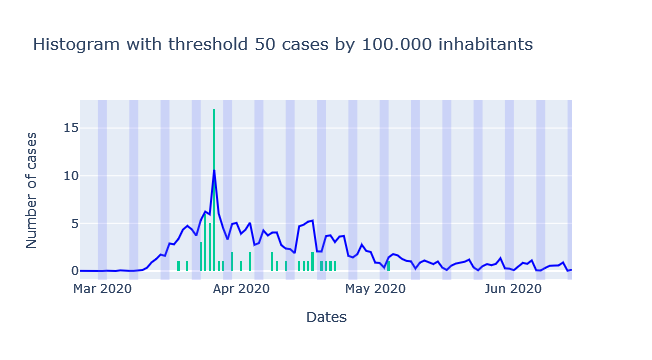

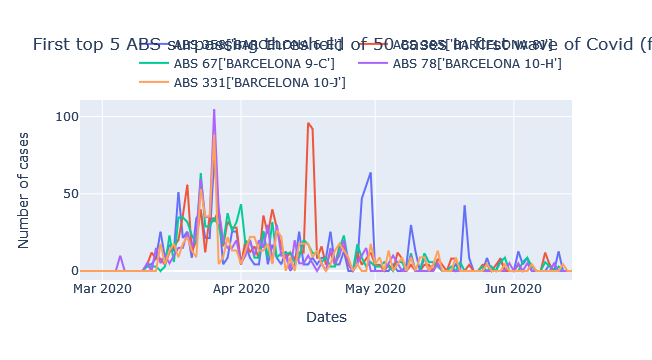

Threshold 100 cases by 100.000 population
There are 11 ABS that surpass threshold 100, which represents 16.4%
First 5 ABSs to surpass threshold 100 are ABS {50: "['BARCELONA 6-D']", 78: "['BARCELONA 10-H']", 79: "['BARCELONA 10-I']", 53: "['BARCELONA 7-C']", 16: "['BARCELONA 1-A']"} with first date 03/26/2020


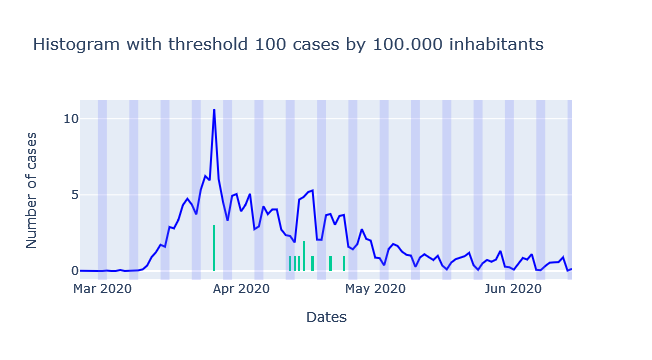

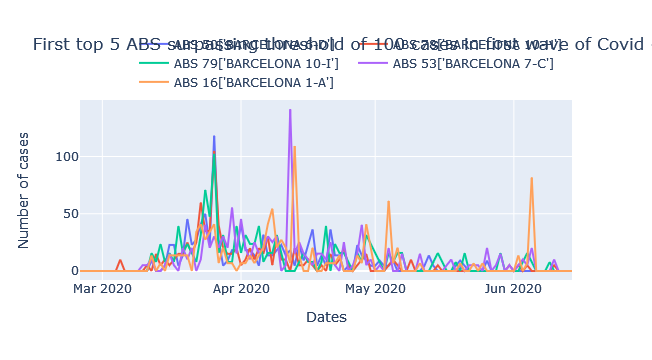

Threshold 200 cases by 100.000 population
There are 2 ABS that surpass threshold 200, which represents 3.0%
First 2 ABSs to surpass threshold 200 are ABS {55: "['BARCELONA 7-E']", 34: "['BARCELONA 3-C']"} with first date 04/16/2020


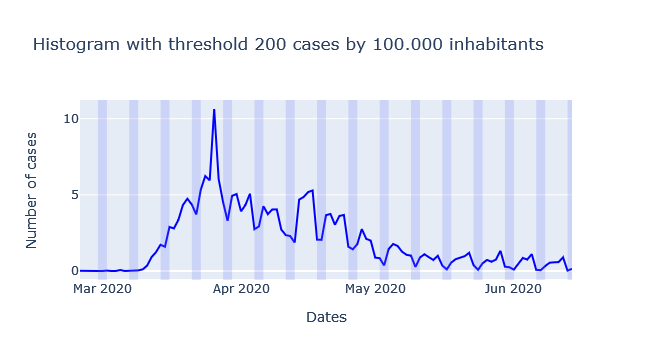

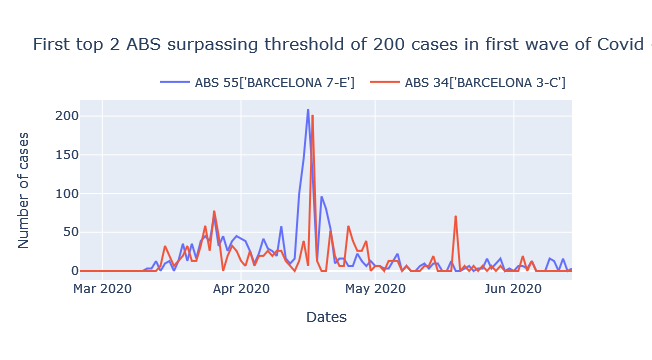

In [66]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    nambeabsbythreshold = []
    abss = first_wave_no_missing_dates_BCN_city.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates_BCN_city.CODIABS == j
        df = first_wave_no_missing_dates_BCN_city[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        filternameabs = abstors.ABS1 == j
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            nambeabsbythreshold.append(nameabs)
            absbythreshold.append(j)
        else: pass
    print('There are ' +str(len(datesbyabsthreshold)) + ' ABS that surpass threshold ' + str(i)  + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)    
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    if i == 50:
        print('\033[1m' + 'When ech ABS surpasses threshold 50?' + "\033[0m")
        datesbyabsthreshold2 = [date.strftime('%m/%d/%Y') for date in datesbyabsthreshold]        
        abs_threshold_city_1wave = np.array(sorted(zip(nambeabsbythreshold,datesbyabsthreshold2), key=lambda t: t[1]))
        print(abs_threshold_city_1wave)    
        print('\n')
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_dates_BCN_citygp = first_wave_no_missing_dates_BCN_city.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_dates_BCN_citygp['population'] = int(population)
    first_wave_no_missing_dates_BCN_citygp['100hab'] = 100000
    first_wave_no_missing_dates_BCN_citygp['proves100hab'] = (first_wave_no_missing_dates_BCN_citygp['100hab'] * first_wave_no_missing_dates_BCN_citygp['NUM_PROVES']) / first_wave_no_missing_dates_BCN_citygp['population']
    first_wave_no_missing_dates_BCN_citygp['weekend'] = np.where((first_wave_no_missing_dates_BCN_citygp.DATA_parsed.dt.weekday == 5) | (first_wave_no_missing_dates_BCN_citygp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_BCN_citygp['DATA_parsed'], y=first_wave_no_missing_dates_BCN_citygp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_BCN_citygp.DATA_parsed ,y = first_wave_no_missing_dates_BCN_citygp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_dates_BCN_citygp.DATA_parsed.min(), first_wave_no_missing_dates_BCN_citygp.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid (from 26/02/2020 until 14/06/2021)')
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates_BCN_city.CODIABS == l
        df = first_wave_no_missing_dates_BCN_city[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

    
# if we take into accound first threshold 50, Igualada is clearly the place where it had more cases since the beggining
# second threshold selva comarca

### Ring 1 (RS barcelona menys barcelona city

In [67]:
RSBCN = RSdata.loc[(RSdata['RS2']=='BARCELONA')]
RS_BCN = RSBCN.ABS1.unique() 
first_wave_no_missing_dates_BCN = first_wave_no_missing_dates[first_wave_no_missing_dates['CODIABS'].isin(RS_BCN)]
first_wave_no_missing_dates_RS_BCN = first_wave_no_missing_dates_BCN[~first_wave_no_missing_dates_BCN['CODIABS'].isin(BCN_city_ABS)]
print(first_wave_no_missing_dates_BCN.shape, first_wave_no_missing_dates_RS_BCN.shape, first_wave_no_missing_dates_BCN_city.shape)
first_wave_no_missing_dates_RS_BCN.shape[0] + first_wave_no_missing_dates_BCN_city.shape[0]
first_wave_no_missing_dates_RS_BCN

(24309, 6) (16872, 6) (7437, 6)


,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
4312,2020-02-25,9,0,0,0,0.000000
4313,2020-02-26,9,0,0,0,0.000000
4314,2020-02-27,9,0,0,0,0.000000
4315,2020-02-28,9,0,0,0,0.000000
4316,2020-02-29,9,0,0,0,0.000000
...,...,...,...,...,...,...
228026,2020-06-10,401,0,0,0,0.000000
228027,2020-06-11,401,23606,1,100000,4.236211
228028,2020-06-12,401,23606,1,100000,4.236211
228029,2020-06-13,401,0,0,0,0.000000


Threshold 50 cases by 100.000 population
There are 112 ABS that surpass threshold 50, which represents 73.7%
When ech ABS surpasses threshold 50?
[["['BADALONA 1']" '03/16/2020']
 ["['SANT QUIRZE DEL VALLÈS']" '03/16/2020']
 ["['VILADECANS 3']" '03/16/2020']
 ["['VILADECANS 2']" '03/17/2020']
 ["['SANT BOI DE LLOBREGAT 2']" '03/19/2020']
 ["['GAVÀ 1']" '03/20/2020']
 ["['SANT BOI DE LLOBREGAT 3']" '03/20/2020']
 ["['SANT JOAN DESPÍ 2']" '03/20/2020']
 ["['BADALONA 12']" '03/20/2020']
 ["['BEGUES']" '03/20/2020']
 ["['SABADELL 3A']" '03/21/2020']
 ["['SABADELL 5']" '03/21/2020']
 ["['CERDANYOLA DEL VALLÈS 1']" '03/22/2020']
 ["['ARGENTONA']" '03/23/2020']
 ["['SANT BOI DE LLOBREGAT 1']" '03/23/2020']
 ["['SANTA COLOMA DE GRAMENET 3']" '03/23/2020']
 ["['VILADECANS 1']" '03/23/2020']
 ["['BADALONA 5']" '03/23/2020']
 ["['BADALONA 9']" '03/23/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 10 - C.SERRA"]' '03/23/2020']
 ["['VILANOVA I LA GELTRÚ 1']" '03/23/2020']
 ["['EL MASNOU-ALELLA']" '03/23/20

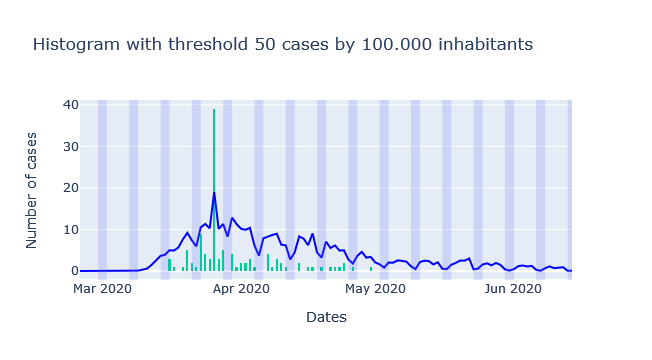

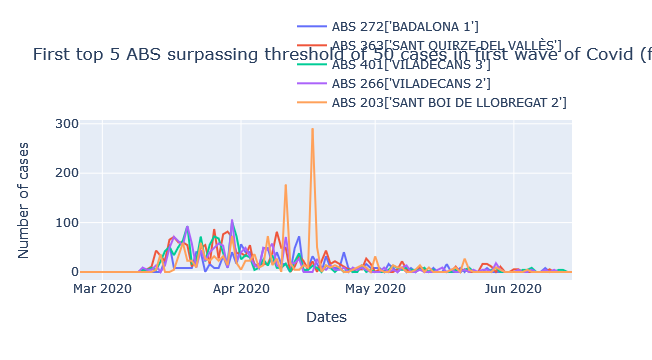

Threshold 100 cases by 100.000 population
There are 34 ABS that surpass threshold 100, which represents 22.4%
First 5 ABSs to surpass threshold 100 are ABS {191: "['SABADELL 1B']", 194: "['SABADELL 3B']", 204: "['SANT BOI DE LLOBREGAT 3']", 223: "['SANTA COLOMA DE GRAMENET 2']", 224: "['SANTA COLOMA DE GRAMENET 3']"} with first date 03/26/2020


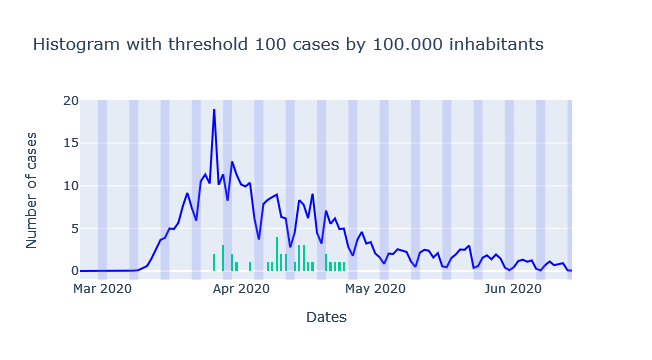

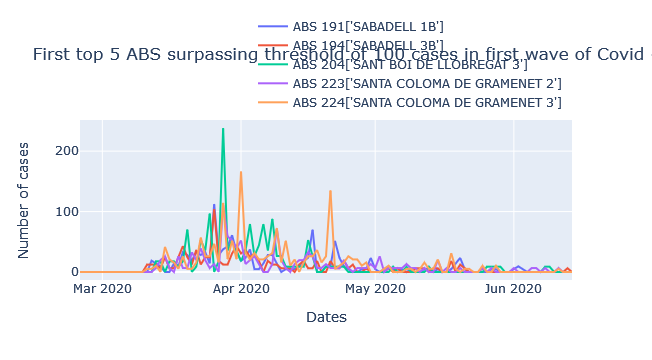

Threshold 200 cases by 100.000 population
There are 6 ABS that surpass threshold 200, which represents 3.9%
First 5 ABSs to surpass threshold 200 are ABS {204: "['SANT BOI DE LLOBREGAT 3']", 218: '["SANT SADURNÍ D\'ANOIA"]', 213: "['SANT JOAN DESPÍ 1']", 89: "['CALDES DE MONTBUI']", 203: "['SANT BOI DE LLOBREGAT 2']"} with first date 03/28/2020


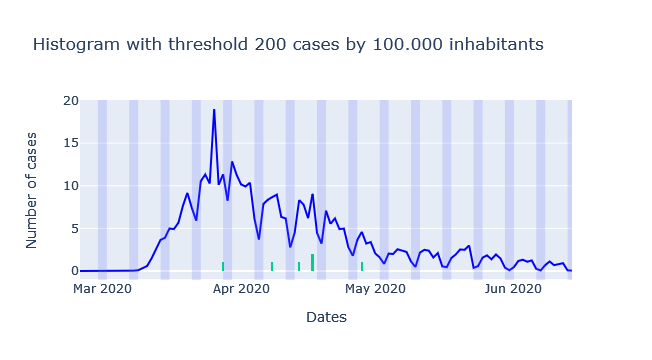

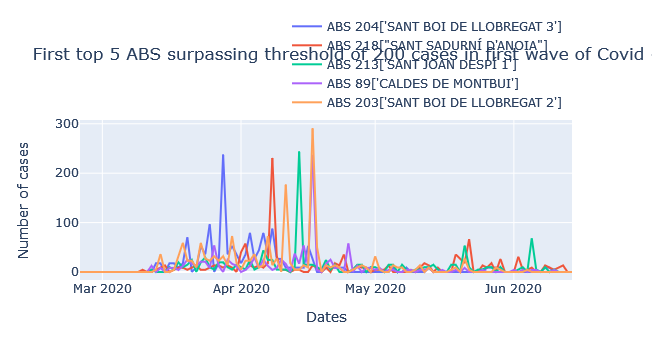

In [68]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    nambeabsbythreshold = []
    abss = first_wave_no_missing_dates_RS_BCN.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates_RS_BCN.CODIABS == j
        df = first_wave_no_missing_dates_RS_BCN[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        filternameabs = abstors.ABS1 == j
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            nambeabsbythreshold.append(nameabs)
            absbythreshold.append(j)
        else: pass
    print('There are ' +str(len(datesbyabsthreshold)) + ' ABS that surpass threshold ' + str(i)  + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)    
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    if i == 50:
        print('\033[1m' + 'When ech ABS surpasses threshold 50?' + "\033[0m")
        datesbyabsthreshold2 = [date.strftime('%m/%d/%Y') for date in datesbyabsthreshold]
        abs_threshold_ring1_1wave = np.array(sorted(zip(nambeabsbythreshold,datesbyabsthreshold2), key=lambda t: t[1]))
        print(abs_threshold_ring1_1wave)       
        print('\n')
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_dates_RS_BCNgp = first_wave_no_missing_dates_RS_BCN.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_dates_RS_BCNgp['population'] = int(population)
    first_wave_no_missing_dates_RS_BCNgp['100hab'] = 100000
    first_wave_no_missing_dates_RS_BCNgp['proves100hab'] = (first_wave_no_missing_dates_RS_BCNgp['100hab'] * first_wave_no_missing_dates_RS_BCNgp['NUM_PROVES']) / first_wave_no_missing_dates_RS_BCNgp['population']
    first_wave_no_missing_dates_RS_BCNgp['weekend'] = np.where((first_wave_no_missing_dates_RS_BCNgp.DATA_parsed.dt.weekday == 5) | (first_wave_no_missing_dates_RS_BCNgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_RS_BCNgp['DATA_parsed'], y=first_wave_no_missing_dates_RS_BCNgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_RS_BCNgp.DATA_parsed ,y = first_wave_no_missing_dates_RS_BCNgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_dates_RS_BCNgp.DATA_parsed.min(), first_wave_no_missing_dates_RS_BCNgp.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid (from 26/02/2020 until 14/06/2021)')
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates_RS_BCN.CODIABS == l
        df = first_wave_no_missing_dates_RS_BCN[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

    
# if we take into accound first threshold 50, Igualada is clearly the place where it had more cases since the beggining
# second threshold selva comarca

### Ring 2 (RS CATALUNYA CENTRAL)

In [69]:
RSCC = RSdata.loc[(RSdata['RS2']=='CATALUNYA CENTRAL')]
RS_CC = RSCC.ABS1.unique() 
first_wave_no_missing_dates_CC = first_wave_no_missing_dates[first_wave_no_missing_dates['CODIABS'].isin(RS_CC)]
print(first_wave_no_missing_dates.shape)
print(first_wave_no_missing_dates_BCN.shape, first_wave_no_missing_dates_RS_BCN.shape, first_wave_no_missing_dates_BCN_city.shape, first_wave_no_missing_dates_CC.shape)
first_wave_no_missing_dates_CC

(41403, 6)
(24309, 6) (16872, 6) (7437, 6) (4218, 6)


,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
5544,2020-02-25,11,0,0,0,0.0
5545,2020-02-26,11,0,0,0,0.0
5546,2020-02-27,11,0,0,0,0.0
5547,2020-02-28,11,0,0,0,0.0
5548,2020-02-29,11,0,0,0,0.0
...,...,...,...,...,...,...
214474,2020-06-10,377,0,0,0,0.0
214475,2020-06-11,377,0,0,0,0.0
214476,2020-06-12,377,0,0,0,0.0
214477,2020-06-13,377,0,0,0,0.0


In [70]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    nambeabsbythreshold = []
    abss = first_wave_no_missing_dates_CC.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates_CC.CODIABS == j
        df = first_wave_no_missing_dates_CC[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        filternameabs = abstors.ABS1 == j
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            nambeabsbythreshold.append(nameabs)
            absbythreshold.append(j)
        else: pass
    print('There are ' +str(len(datesbyabsthreshold)) + ' ABS that surpass threshold ' + str(i)  + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)    
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    if i == 50:
        print('\033[1m' + 'When ech ABS surpasses threshold 50?' + "\033[0m")
        datesbyabsthreshold2 = [date.strftime('%m/%d/%Y') for date in datesbyabsthreshold]
        abs_threshold_ring2_1wave = np.array(sorted(zip(nambeabsbythreshold,datesbyabsthreshold2), key=lambda t: t[1]))
        print(abs_threshold_ring2_1wave)
        print('\n')
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_dates_CCgp = first_wave_no_missing_dates_CC.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_dates_CCgp['population'] = int(population)
    first_wave_no_missing_dates_CCgp['100hab'] = 100000
    first_wave_no_missing_dates_CCgp['proves100hab'] = (first_wave_no_missing_dates_CCgp['100hab'] * first_wave_no_missing_dates_CCgp['NUM_PROVES']) / first_wave_no_missing_dates_CCgp['population']
    first_wave_no_missing_dates_CCgp['weekend'] = np.where((first_wave_no_missing_dates_CCgp.DATA_parsed.dt.weekday == 5) | (first_wave_no_missing_dates_CCgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_CCgp['DATA_parsed'], y=first_wave_no_missing_dates_CCgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_CCgp.DATA_parsed ,y = first_wave_no_missing_dates_CCgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_dates_CCgp.DATA_parsed.min(), first_wave_no_missing_dates_CCgp.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid (from 26/02/2020 until 14/06/2021)')
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates_CC.CODIABS == l
        df = first_wave_no_missing_dates_CC[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

    
# if we take into accound first threshold 50, Igualada is clearly the place where it had more cases since the beggining
# second threshold selva comarca

Threshold 50 cases by 100.000 population
There are 32 ABS that surpass threshold 50, which represents 84.2%
When ech ABS surpasses threshold 50?
[["['VILANOVA DEL CAMÍ']" '03/14/2020']
 ["['IGUALADA-1']" '03/14/2020']
 ["['IGUALADA-2']" '03/14/2020']
 ["['ANOIA RURAL']" '03/19/2020']
 ["['SANT VICENÇ DE CASTELLET']" '03/19/2020']
 ["['SÚRIA']" '03/19/2020']
 ["['CAPELLADES']" '03/20/2020']
 ["['CALAF']" '03/22/2020']
 ["['SANTA MARGARIDA DE MONTBUI']" '03/22/2020']
 ["['BERGA']" '03/24/2020']
 ["['SANTA EUGÈNIA DE BERGA']" '03/24/2020']
 ["['VIC-1 NORD']" '03/24/2020']
 ["['CARDONA']" '03/25/2020']
 ["['ARTÉS']" '03/26/2020']
 ["['MANRESA 4']" '03/26/2020']
 ["['NAVÀS/BALSARENY']" '03/26/2020']
 ["['NAVARCLES - SANT FRUITÓS DE BAGES']" '03/26/2020']
 ["['SANT HIPÒLIT DE VOLTREGÀ']" '03/26/2020']
 ["['PIERA']" '03/26/2020']
 ["['ALT BERGUEDÀ']" '03/28/2020']
 ["['CENTELLES']" '03/29/2020']
 ["['MANRESA 2']" '03/29/2020']
 ["['SALLENT']" '03/29/2020']
 ["['SANT JOAN DE VILATORRADA']" '03

Threshold 100 cases by 100.000 population
There are 20 ABS that surpass threshold 100, which represents 52.6%
First 5 ABSs to surpass threshold 100 are ABS {229: "['SANTA MARGARIDA DE MONTBUI']", 269: "['VILANOVA DEL CAMÍ']", 337: "['CAPELLADES']", 371: "['IGUALADA-1']", 372: "['IGUALADA-2']"} with first date 03/26/2020


Threshold 200 cases by 100.000 population
There are 7 ABS that surpass threshold 200, which represents 18.4%
First 5 ABSs to surpass threshold 200 are ABS {228: "['SANTA COLOMA DE QUERALT']", 88: "['CALAF']", 237: "['SÚRIA']", 159: "['MOIÀ']", 130: "['ALT BERGUEDÀ']"} with first date 04/08/2020


## Second wave

### Second wave all Barcelona province

In [71]:
RSdata = pd.read_csv('ABStoRS.csv', sep=',')
RSdata.RS2.unique()
provBCN = RSdata.loc[(RSdata['RS2']=='BARCELONA') | (RSdata['RS2']== 'CATALUNYA CENTRAL')]
provBCN['ABS1'] = provBCN['ABS1'].astype(str).str.zfill(3)
provBCN['ABS1'] = provBCN['ABS1'].astype(int)
provBCN = provBCN[['ABS1', 'ABS2']]
print(provBCN.ABS1.nunique())
provBCN = provBCN.groupby(['ABS1']).size().reset_index()
ABS_BCN = provBCN.ABS1.unique() 
second_wave_no_missing_dates__BCN = second_wave_no_missing_dates_[second_wave_no_missing_dates_['CODIABS'].isin(ABS_BCN)]
second_wave_no_missing_dates_.shape, second_wave_no_missing_dates__BCN.shape
# ABS_BCN, first_wave_no_missing_dates['CODIABS'].dtypes

257


/tmp/ipykernel_205/3584559908.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_205/3584559908.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



((74600, 6), (51400, 6))

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 257, which represents 100.0%
First 5 ABSs to surpass threshold 50 are ABS {96: "['CARDONA']", 350: "['VIC-1 NORD']", 128: "['BAIX BERGUEDÀ']", 130: "['ALT BERGUEDÀ']", 237: "['SÚRIA']"} with first date 06/16/2020


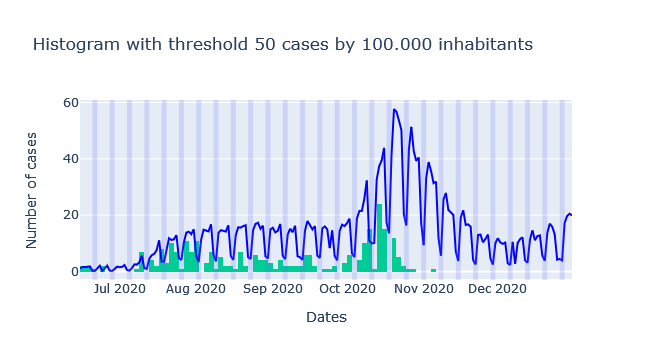

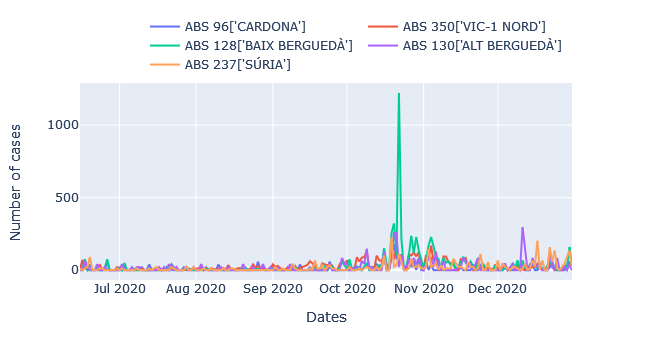

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 176, which represents 68.5%
First 5 ABSs to surpass threshold 100 are ABS {294: '["L\'HOSPITALET DE LLOBREGAT 7-FLORIDA N."]', 297: '["L\'HOSPITALET DE LLOBREGAT 10 - C.SERRA"]', 290: '["L\'HOSPITALET DE LLOBREGAT 3 - COLLBLANC"]', 33: "['BARCELONA 3-B']", 38: "['BARCELONA 3-G']"} with first date 07/13/2020


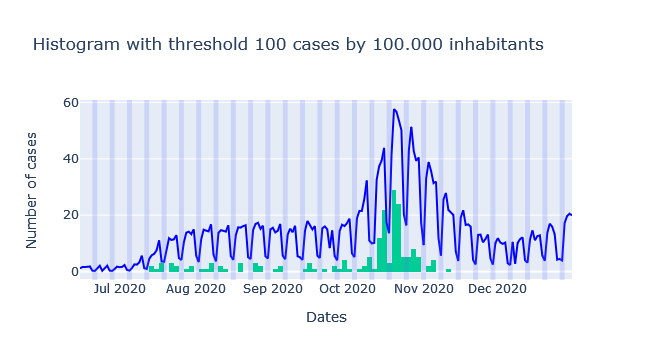

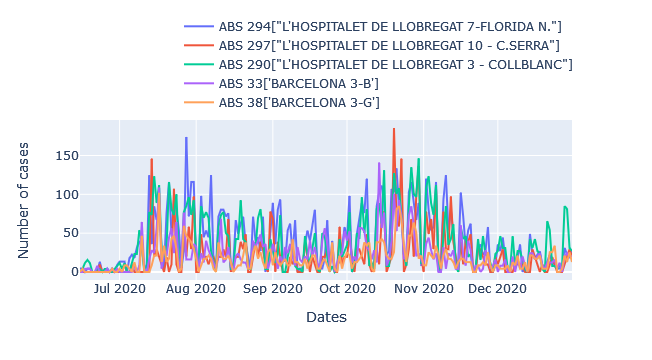

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 32, which represents 12.5%
First 5 ABSs to surpass threshold 200 are ABS {291: '["L\'HOSPITALET DE LLOBREGAT 4 TORRASSA"]', 217: "['SANT QUIRZE DE BESORA']", 70: "['BARCELONA 9-F']", 10: "['ARGENTONA']", 185: "['LLUÇANÈS']"} with first date 07/24/2020


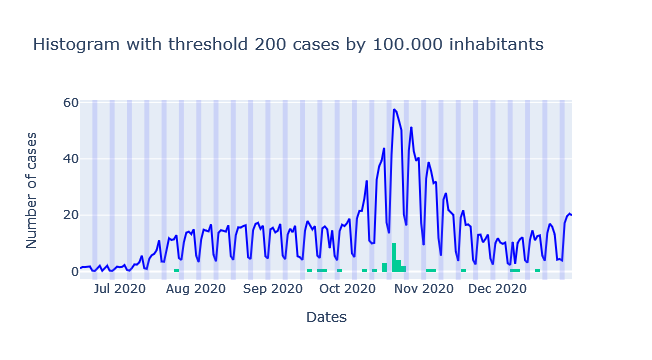

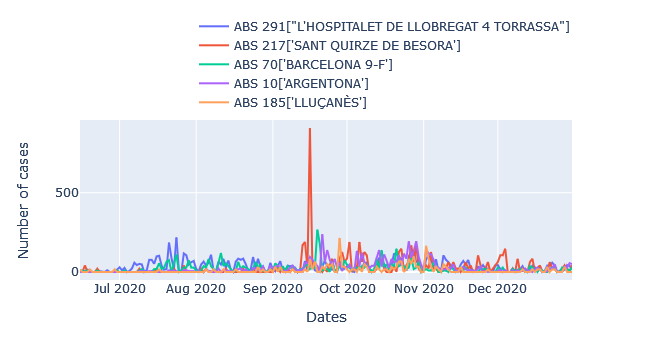

In [72]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_wave_no_missing_dates__BCN.CODIABS.unique()
    for j in abss:
        filterabs = second_wave_no_missing_dates__BCN.CODIABS == j
        df = second_wave_no_missing_dates__BCN[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates__BCN.DATA_parsed.min(), second_wave_no_missing_dates__BCN.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates__BCNgp = second_wave_no_missing_dates__BCN.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates__BCNgp['population'] = int(population)
    second_wave_no_missing_dates__BCNgp['100hab'] = 100000
    second_wave_no_missing_dates__BCNgp['proves100hab'] = (second_wave_no_missing_dates__BCNgp['100hab'] * second_wave_no_missing_dates__BCNgp['NUM_PROVES']) / second_wave_no_missing_dates__BCNgp['population']
    second_wave_no_missing_dates__BCNgp['weekend'] = np.where((second_wave_no_missing_dates__BCNgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates__BCNgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates__BCNgp['DATA_parsed'], y=second_wave_no_missing_dates__BCNgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates__BCNgp.DATA_parsed ,y = second_wave_no_missing_dates__BCNgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates__BCN.DATA_parsed.min(), second_wave_no_missing_dates__BCN.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates__BCN.CODIABS == l
        df = second_wave_no_missing_dates__BCN[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

### Barcelona city

In [73]:
BCN_city = absrsss[absrsss['SS2'].str.match('BARCELONA')]
BCN_city_ABS = BCN_city.ABS1.unique()
second_wave_no_missing_dates__BCN_city = second_wave_no_missing_dates__BCN[second_wave_no_missing_dates__BCN['CODIABS'].isin(BCN_city_ABS)]
second_wave_no_missing_dates_.shape, second_wave_no_missing_dates__BCN.shape, second_wave_no_missing_dates__BCN_city.shape

((74600, 6), (51400, 6), (13400, 6))

Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 67, which represents 100.0%
When ech ABS surpasses threshold 50?
[["['BARCELONA 2-K']" '06/23/2020']
 ["['BARCELONA 2-B']" '07/10/2020']
 ["['BARCELONA 2-D']" '07/10/2020']
 ["['BARCELONA 3-B']" '07/10/2020']
 ["['BARCELONA 3-C']" '07/10/2020']
 ["['BARCELONA 8-F']" '07/10/2020']
 ["['BARCELONA 3-I']" '07/10/2020']
 ["['BARCELONA 10-E']" '07/15/2020']
 ["['BARCELONA 2-A']" '07/17/2020']
 ["['BARCELONA 3-E']" '07/17/2020']
 ["['BARCELONA 3-G']" '07/17/2020']
 ["['BARCELONA 8-H']" '07/17/2020']
 ["['BARCELONA 9-F']" '07/17/2020']
 ["['BARCELONA 3-H']" '07/17/2020']
 ["['BARCELONA 1-D']" '07/21/2020']
 ["['BARCELONA 1-E']" '07/21/2020']
 ["['BARCELONA 4-C']" '07/21/2020']
 ["['BARCELONA 7-A']" '07/21/2020']
 ["['BARCELONA 10-D']" '07/21/2020']
 ["['BARCELONA 10-B']" '07/22/2020']
 ["['BARCELONA 2-C']" '07/23/2020']
 ["['BARCELONA 3-A']" '07/23/2020']
 ["['BARCELONA 8-I']" '

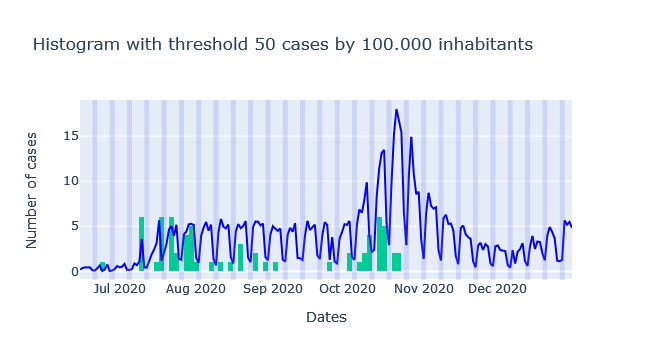

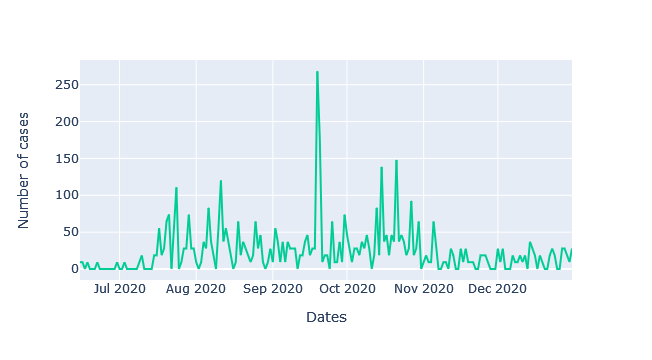

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 47, which represents 70.1%
First 5 ABSs to surpass threshold 100 are ABS {291: '["L\'HOSPITALET DE LLOBREGAT 4 TORRASSA"]', 217: "['SANT QUIRZE DE BESORA']", 70: "['BARCELONA 9-F']", 10: "['ARGENTONA']", 185: "['LLUÇANÈS']"} with first date 07/17/2020


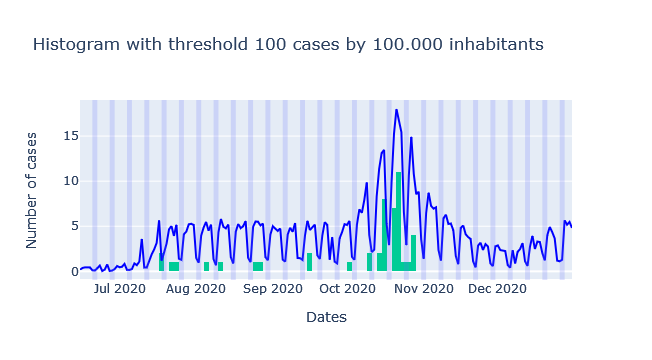

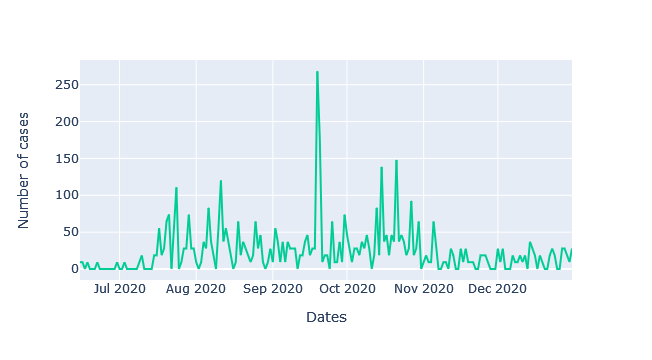

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 3, which represents 4.5%
First 5 ABSs to surpass threshold 200 are ABS {291: '["L\'HOSPITALET DE LLOBREGAT 4 TORRASSA"]', 217: "['SANT QUIRZE DE BESORA']", 70: "['BARCELONA 9-F']", 10: "['ARGENTONA']", 185: "['LLUÇANÈS']"} with first date 09/19/2020


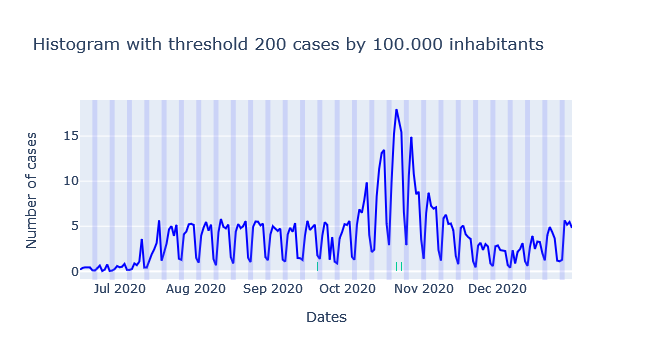

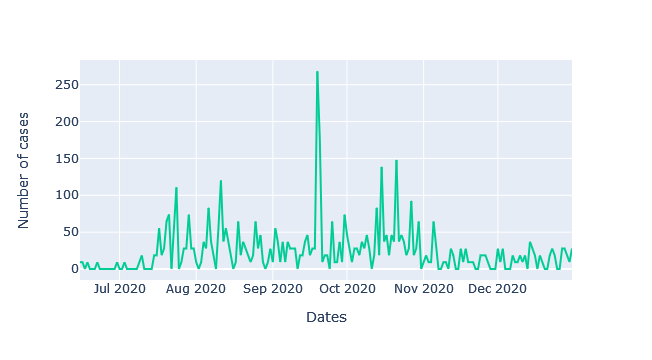

In [74]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_wave_no_missing_dates__BCN_city.CODIABS.unique()
    nambeabsbythreshold = []
    for j in abss:
        filterabs = second_wave_no_missing_dates__BCN_city.CODIABS == j
        df = second_wave_no_missing_dates__BCN_city[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        filternameabs = abstors.ABS1 == j
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            nambeabsbythreshold.append(nameabs)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates__BCN_city.DATA_parsed.min(), second_wave_no_missing_dates__BCN_city.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    if i == 50:
        print('\033[1m' + 'When ech ABS surpasses threshold 50?' + "\033[0m")
        datesbyabsthreshold2 = [date.strftime('%m/%d/%Y') for date in datesbyabsthreshold]
        abs_threshold_city_2wave = np.array(sorted(zip(nambeabsbythreshold,datesbyabsthreshold2), key=lambda t: t[1]))
        print(abs_threshold_city_2wave)
        print('\n')
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates__BCN_citygp = second_wave_no_missing_dates__BCN_city.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates__BCN_citygp['population'] = int(population)
    second_wave_no_missing_dates__BCN_citygp['100hab'] = 100000
    second_wave_no_missing_dates__BCN_citygp['proves100hab'] = (second_wave_no_missing_dates__BCN_citygp['100hab'] * second_wave_no_missing_dates__BCN_citygp['NUM_PROVES']) / second_wave_no_missing_dates__BCN_citygp['population']
    second_wave_no_missing_dates__BCN_citygp['weekend'] = np.where((second_wave_no_missing_dates__BCN_citygp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates__BCN_citygp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates__BCN_citygp['DATA_parsed'], y=second_wave_no_missing_dates__BCN_citygp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates__BCN_citygp.DATA_parsed ,y = second_wave_no_missing_dates__BCN_citygp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates__BCN_city.DATA_parsed.min(), second_wave_no_missing_dates__BCN_city.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates__BCN_city.CODIABS == l
        df = second_wave_no_missing_dates__BCN_city[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier
# lista abs con fecha de cuand pasan threshold 50 (1ra y 2a ola) BCN_City, Ring_1, Ring_2

### Ring 1 (RS barcelona menys barcelona city

In [75]:
RSBCN = RSdata.loc[(RSdata['RS2']=='BARCELONA')]
RS_BCN = RSBCN.ABS1.unique() 
second_wave_no_missing_dates__BCN = second_wave_no_missing_dates_[second_wave_no_missing_dates_['CODIABS'].isin(RS_BCN)]
second_wave_no_missing_dates_RS_BCN = second_wave_no_missing_dates__BCN[~second_wave_no_missing_dates__BCN['CODIABS'].isin(BCN_city_ABS)]
print(second_wave_no_missing_dates__BCN.shape, second_wave_no_missing_dates_RS_BCN.shape, second_wave_no_missing_dates__BCN_city.shape)
second_wave_no_missing_dates_RS_BCN.shape[0] + second_wave_no_missing_dates__BCN_city.shape[0]
second_wave_no_missing_dates_RS_BCN

(43800, 6) (30400, 6) (13400, 6)


,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
4423,2020-06-15,9,24763,2,100000,8.076566
4424,2020-06-16,9,0,0,0,0.000000
4425,2020-06-17,9,0,0,0,0.000000
4426,2020-06-18,9,24763,2,100000,8.076566
4427,2020-06-19,9,0,0,0,0.000000
...,...,...,...,...,...,...
228226,2020-12-27,401,0,0,0,0.000000
228227,2020-12-28,401,23606,9,100000,38.125900
228228,2020-12-29,401,23606,6,100000,25.417267
228229,2020-12-30,401,23606,7,100000,29.653478


Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 152, which represents 100.0%
When ech ABS surpasses threshold 50?
[['["L\'HOSPITALET DE LLOBREGAT 4 TORRASSA"]' '07/07/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 3 - COLLBLANC"]' '07/09/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 7-FLORIDA N."]' '07/13/2020']
 ["['SANT FELIU DE LLOBREGAT 1']" '07/14/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 9-PUBILLA C."]' '07/14/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 10 - C.SERRA"]' '07/14/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 8-FLORIDA S."]' '07/16/2020']
 ["['CORNELLÀ DE LLOBREGAT 2']" '07/17/2020']
 ["['CORNELLÀ DE LLOBREGAT 3']" '07/20/2020']
 ["['CORNELLÀ DE LLOBREGAT 4']" '07/20/2020']
 ["['ESPLUGUES DE LLOBREGAT 1']" '07/20/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 11 - GORNAL"]' '07/21/2020']
 ["['SANT JUST DESVERN']" '07/22/2020']
 ['["L\'HOSPITALET DE LLOBREGAT 12 (BELLVITGE)"]' '07/22/2020']
 ["['BADALONA 7A']" '07/22/2020']
 ["['BADALONA 

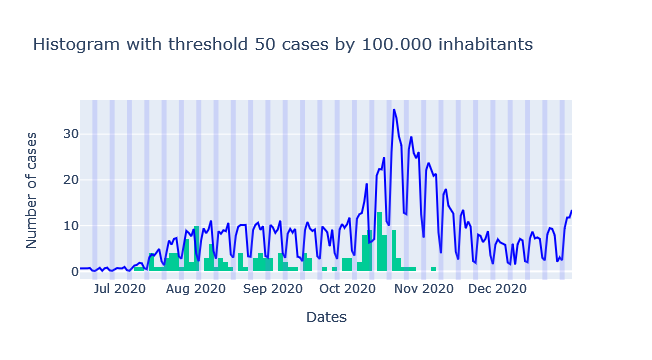

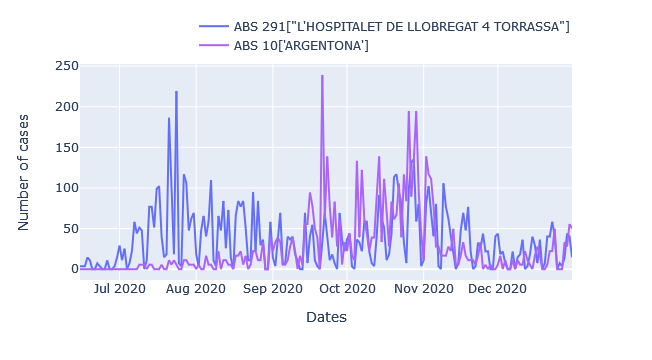

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 96, which represents 63.2%
First 5 ABSs to surpass threshold 100 are ABS {291: '["L\'HOSPITALET DE LLOBREGAT 4 TORRASSA"]', 217: "['SANT QUIRZE DE BESORA']", 70: "['BARCELONA 9-F']", 10: "['ARGENTONA']", 185: "['LLUÇANÈS']"} with first date 07/13/2020


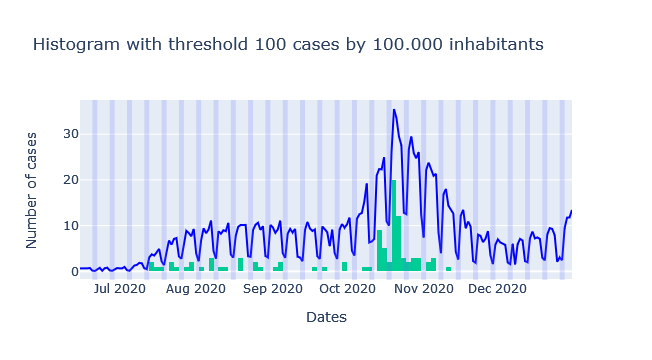

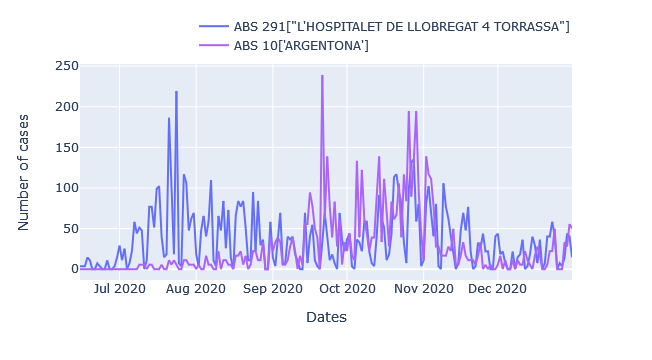

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 13, which represents 8.6%
First 5 ABSs to surpass threshold 200 are ABS {291: '["L\'HOSPITALET DE LLOBREGAT 4 TORRASSA"]', 217: "['SANT QUIRZE DE BESORA']", 70: "['BARCELONA 9-F']", 10: "['ARGENTONA']", 185: "['LLUÇANÈS']"} with first date 07/24/2020


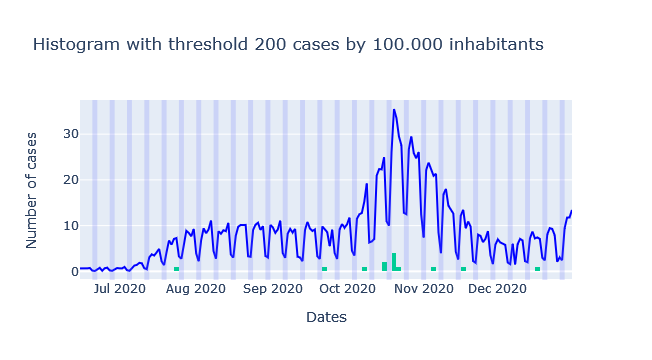

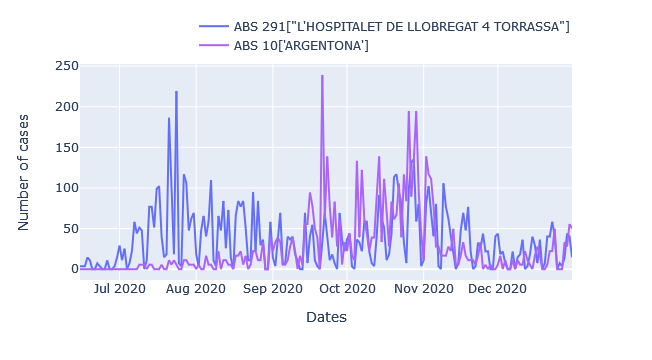

In [76]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    nambeabsbythreshold = []
    abss = second_wave_no_missing_dates_RS_BCN.CODIABS.unique()
    for j in abss:
        filterabs = second_wave_no_missing_dates_RS_BCN.CODIABS == j
        df = second_wave_no_missing_dates_RS_BCN[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        filternameabs = abstors.ABS1 == j
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            nambeabsbythreshold.append(nameabs)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_RS_BCN.DATA_parsed.min(), second_wave_no_missing_dates_RS_BCN.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    if i == 50:
        print('\033[1m' + 'When ech ABS surpasses threshold 50?' + "\033[0m")
        datesbyabsthreshold2 = [date.strftime('%m/%d/%Y') for date in datesbyabsthreshold]
        abs_threshold_ring1_2wave = np.array(sorted(zip(nambeabsbythreshold,datesbyabsthreshold2), key=lambda t: t[1]))
        print(abs_threshold_ring1_2wave)
        print('\n')
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_RS_BCNgp = second_wave_no_missing_dates_RS_BCN.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_RS_BCNgp['population'] = int(population)
    second_wave_no_missing_dates_RS_BCNgp['100hab'] = 100000
    second_wave_no_missing_dates_RS_BCNgp['proves100hab'] = (second_wave_no_missing_dates_RS_BCNgp['100hab'] * second_wave_no_missing_dates_RS_BCNgp['NUM_PROVES']) / second_wave_no_missing_dates_RS_BCNgp['population']
    second_wave_no_missing_dates_RS_BCNgp['weekend'] = np.where((second_wave_no_missing_dates_RS_BCNgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_RS_BCNgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_RS_BCNgp['DATA_parsed'], y=second_wave_no_missing_dates_RS_BCNgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_RS_BCNgp.DATA_parsed ,y = second_wave_no_missing_dates_RS_BCNgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_RS_BCN.DATA_parsed.min(), second_wave_no_missing_dates_RS_BCN.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates_RS_BCN.CODIABS == l
        df = second_wave_no_missing_dates_RS_BCN[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

### Ring 2 (RS CATALUNYA CENTRAL)

In [77]:
RSCC = RSdata.loc[(RSdata['RS2']=='CATALUNYA CENTRAL')]
RS_CC = RSCC.ABS1.unique() 
second_wave_no_missing_dates_CC = second_wave_no_missing_dates_[second_wave_no_missing_dates_['CODIABS'].isin(RS_CC)]
print(second_wave_no_missing_dates_.shape)
print(second_wave_no_missing_dates__BCN.shape, second_wave_no_missing_dates_RS_BCN.shape, second_wave_no_missing_dates__BCN_city.shape, second_wave_no_missing_dates_CC.shape)
second_wave_no_missing_dates_CC

(74600, 6)
(43800, 6) (30400, 6) (13400, 6) (7600, 6)


,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
5655,2020-06-15,11,0,0,0,0.000000
5656,2020-06-16,11,0,0,0,0.000000
5657,2020-06-17,11,0,0,0,0.000000
5658,2020-06-18,11,11315,3,100000,26.513478
5659,2020-06-19,11,11315,1,100000,8.837826
...,...,...,...,...,...,...
214674,2020-12-27,377,0,0,0,0.000000
214675,2020-12-28,377,0,0,0,0.000000
214676,2020-12-29,377,0,0,0,0.000000
214677,2020-12-30,377,9914,3,100000,30.260238


Threshold 50 cases by 100.000 population
Number of ABS that surpass the threshold 50 cases by 100.000 inhabitants is 38, which represents 100.0%
When ech ABS surpasses threshold 50?
[["['CARDONA']" '06/16/2020']
 ["['VIC-1 NORD']" '06/16/2020']
 ["['BAIX BERGUEDÀ']" '06/17/2020']
 ["['ALT BERGUEDÀ']" '06/17/2020']
 ["['SÚRIA']" '06/19/2020']
 ["['SANT JOAN DE VILATORRADA']" '06/23/2020']
 ["['SANTA COLOMA DE QUERALT']" '07/17/2020']
 ["['ARTÉS']" '07/24/2020']
 ["['SANT HIPÒLIT DE VOLTREGÀ']" '08/10/2020']
 ["['VIC-2 SUD']" '08/17/2020']
 ["['SANT VICENÇ DE CASTELLET']" '08/20/2020']
 ["['TONA']" '08/24/2020']
 ["['NAVÀS/BALSARENY']" '09/07/2020']
 ["['MOIÀ']" '09/10/2020']
 ["['MANLLEU']" '09/11/2020']
 ["['VALL DEL GES']" '09/11/2020']
 ["['SANT QUIRZE DE BESORA']" '09/13/2020']
 ["['CENTELLES']" '09/14/2020']
 ["['MONTSERRAT']" '09/15/2020']
 ["['LLUÇANÈS']" '09/16/2020']
 ["['EL SOLSONÈS']" '09/16/2020']
 ["['RODA DE TER']" '09/17/2020']
 ["['SALLENT']" '09/18/2020']
 ["['BERGA']" 

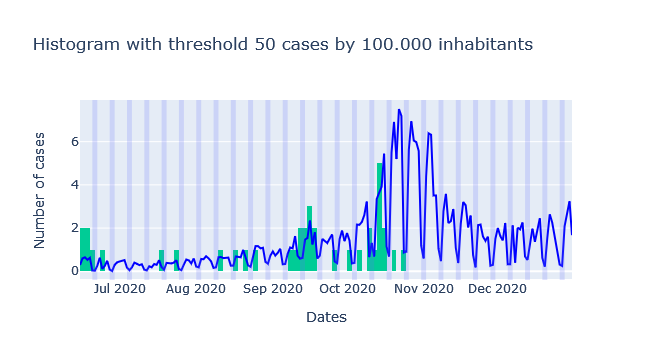

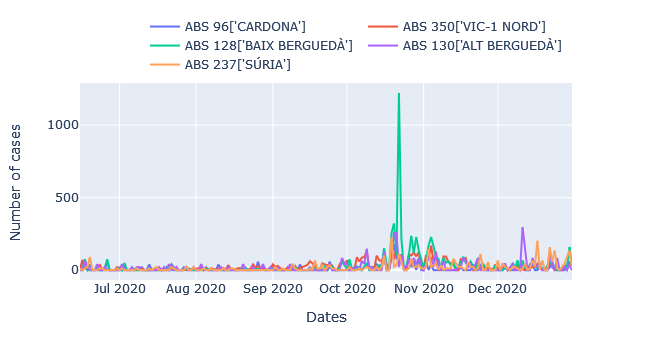

Threshold 100 cases by 100.000 population
Number of ABS that surpass the threshold 100 cases by 100.000 inhabitants is 33, which represents 86.8%
First 5 ABSs to surpass threshold 100 are ABS {217: "['SANT QUIRZE DE BESORA']", 236: "['EL SOLSONÈS']", 98: "['MONTSERRAT']", 144: "['MANLLEU']", 185: "['LLUÇANÈS']"} with first date 09/13/2020


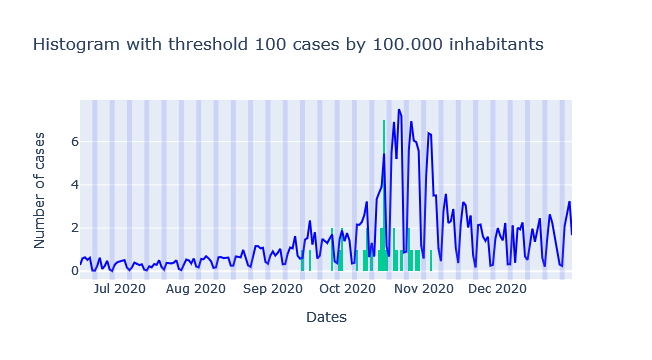

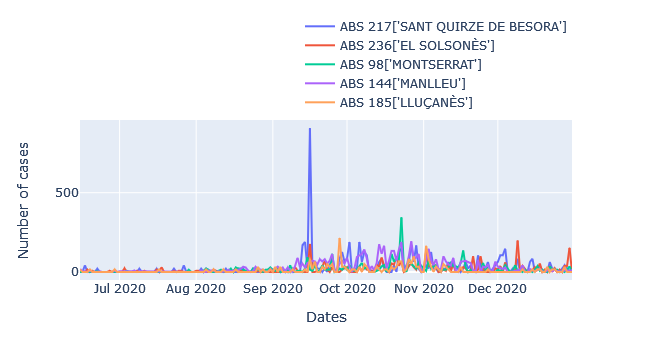

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 16, which represents 42.1%
First 5 ABSs to surpass threshold 200 are ABS {217: "['SANT QUIRZE DE BESORA']", 185: "['LLUÇANÈS']", 338: "['PIERA']", 148: "['MANRESA 4']", 128: "['BAIX BERGUEDÀ']"} with first date 09/16/2020


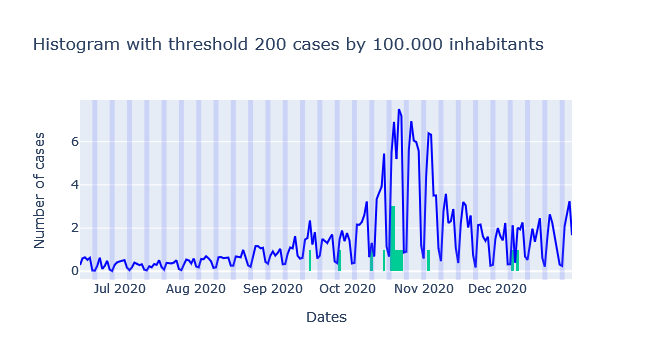

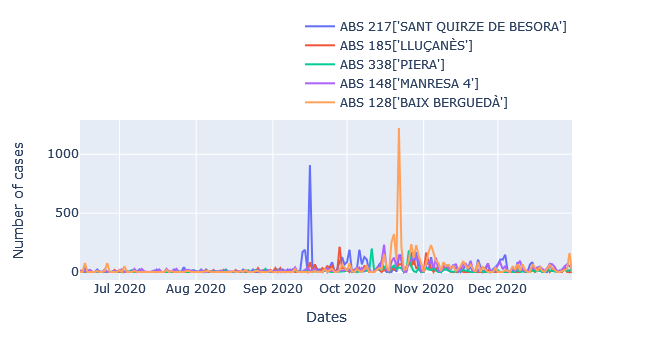

In [78]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    nambeabsbythreshold = []
    abss = second_wave_no_missing_dates_CC.CODIABS.unique()
    for j in abss:
        filterabs = second_wave_no_missing_dates_CC.CODIABS == j
        df = second_wave_no_missing_dates_CC[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        filternameabs = abstors.ABS1 == j
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            nambeabsbythreshold.append(nameabs)
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_CC.DATA_parsed.min(), second_wave_no_missing_dates_CC.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    if i == 50:
        print('\033[1m' + 'When ech ABS surpasses threshold 50?' + "\033[0m")
        datesbyabsthreshold2 = [date.strftime('%m/%d/%Y') for date in datesbyabsthreshold]
        abs_threshold_ring2_2wave = np.array(sorted(zip(nambeabsbythreshold,datesbyabsthreshold2), key=lambda t: t[1]))
        print(abs_threshold_ring2_2wave)
        print('\n')
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_CCgp = second_wave_no_missing_dates_CC.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_CCgp['population'] = int(population)
    second_wave_no_missing_dates_CCgp['100hab'] = 100000
    second_wave_no_missing_dates_CCgp['proves100hab'] = (second_wave_no_missing_dates_CCgp['100hab'] * second_wave_no_missing_dates_CCgp['NUM_PROVES']) / second_wave_no_missing_dates_CCgp['population']
    second_wave_no_missing_dates_CCgp['weekend'] = np.where((second_wave_no_missing_dates_CCgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_CCgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_CCgp['DATA_parsed'], y=second_wave_no_missing_dates_CCgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_CCgp.DATA_parsed ,y = second_wave_no_missing_dates_CCgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_CC.DATA_parsed.min(), second_wave_no_missing_dates_CC.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    # fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates_CC.CODIABS == l
        df = second_wave_no_missing_dates_CC[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

# RS ANALYSIS

In [109]:
# population by rs
pcrs = pd.read_csv('provesperdiaperABS.csv')
pcrs2 = pcrs.copy()
pcrs = pcrs.iloc[:,1:]
# pcrs = pcrs.rename(columns={"ABS1": "CODIABS"})
pcrs['DATA_parsed'] = pd.to_datetime(pcrs['DATA_parsed']).dt.date
pcrs = pcrs.drop('RelativeProves', axis = 1)
filterSES = pcrs.ABS1 == 'SES'
pcrs = pcrs[~filterSES]
pcrs['ABS1'] = pcrs['ABS1'].astype(str).astype(int)
print(pcrs.ABS1.nunique())
print(absrsss.ABS1.nunique())
absrsss['ABS1'] = absrsss['ABS1'].astype(str).astype(int)
print(absrsss.ABS1.nunique())
pcrsrs = pcrs.merge(absrsss)
pcrsrs
print(pcrsrs.ABS1.nunique())

/data/jupyter/software/miniconda_py39_4.10.3/envs/jupyterhub_0.4/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3251: DtypeWarning:

Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.



373
373
373
373


In [110]:
rsunique = pcrsrs.RS2.unique()
poprs = []
for i in rsunique:
    print(i)
    filterrs = pcrsrs.RS2 == i
    df = pcrsrs[filterrs]
    abss = df.ABS1.unique()
    print(len(abss))
    temppop = []
    for j in abss:
        filterabs = df.ABS1 == j
        df2 = df[filterabs]
        temppop.append(int(df2.NUM_INDIV.unique()))
    poprs.append(sum(temppop))
    
print(pcrsrs.ABS1.nunique())    
print(sum(poprs))
rspopdict = dict(zip(rsunique, poprs))
rspopdict

LLEIDA
23
TERRES DE L'EBRE
11
GIRONA
41
ALT PIRINEU i ARAN
8
BARCELONA
219
CATALUNYA CENTRAL
38
CAMP DE TARRAGONA
33
373
7722114


{'LLEIDA': 366906,
 "TERRES DE L'EBRE": 178635,
 'GIRONA': 873990,
 'ALT PIRINEU i ARAN': 68937,
 'BARCELONA': 5083329,
 'CATALUNYA CENTRAL': 532596,
 'CAMP DE TARRAGONA': 617721}

In [111]:
no_missing_dates_rs = no_missing_dates.copy()
no_missing_dates_rs = no_missing_dates_rs.merge(absrsss, left_on='CODIABS', right_on='ABS1')
no_missing_dates_rs

,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab,ABS1,ABS2,SS1,SS2,RS1,RS2
0,2020-02-25,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
1,2020-02-26,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
2,2020-02-27,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
3,2020-02-28,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
4,2020-02-29,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
...,...,...,...,...,...,...,...,...,...,...,...,...
229763,2021-10-28,403,29403,1,100000,3.401014,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA
229764,2021-10-29,403,0,0,0,0.000000,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA
229765,2021-10-30,403,0,0,0,0.000000,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA
229766,2021-10-31,403,0,0,0,0.000000,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA


In [112]:
no_missing_dates_rs = no_missing_dates_rs[['DATA_parsed','NUM_PROVES','RS2','CODIABS']]
no_missing_dates_rs = no_missing_dates_rs.groupby(['DATA_parsed', 'RS2'])['NUM_PROVES'].sum().reset_index()
no_missing_dates_rs["NUM_IND" ] = no_missing_dates_rs["RS2"].map(rspopdict)
no_missing_dates_rs['100pop'] = 100000
no_missing_dates_rs['cases100hab'] = ( no_missing_dates_rs['100pop'] * no_missing_dates_rs['NUM_PROVES'] ) / no_missing_dates_rs['NUM_IND']
no_missing_dates_rs
# no_missing_dates_rs[no_missing_dates_rs['DATA_parsed']=='2020-03-26']['NUM_IND'].sum()

,DATA_parsed,RS2,NUM_PROVES,NUM_IND,100pop,cases100hab
0,2020-02-25,ALT PIRINEU i ARAN,0,68937,100000,0.000000
1,2020-02-25,BARCELONA,1,5083329,100000,0.019672
2,2020-02-25,CAMP DE TARRAGONA,0,617721,100000,0.000000
3,2020-02-25,CATALUNYA CENTRAL,0,532596,100000,0.000000
4,2020-02-25,GIRONA,0,873990,100000,0.000000
...,...,...,...,...,...,...
4307,2021-11-01,CAMP DE TARRAGONA,0,617721,100000,0.000000
4308,2021-11-01,CATALUNYA CENTRAL,5,532596,100000,0.938798
4309,2021-11-01,GIRONA,11,873990,100000,1.258596
4310,2021-11-01,LLEIDA,5,366906,100000,1.362747


In [113]:
no_missing_dates_rs.cases100hab.max()

108.90055501731143

In [114]:
# first_wave_pcrs_filter = pcrs['DATA_parsed'] < pd.to_datetime('2020-06-15').date()
first_wave_no_missing_dates_filter = no_missing_dates_rs['DATA_parsed'] < '2020-06-15'
first_wave_no_missing_dates_rs = no_missing_dates_rs[first_wave_no_missing_dates_filter]
second_wave_no_missing_dates_rs = no_missing_dates_rs[~first_wave_no_missing_dates_filter]
filter_second_wave_no_missing_dates = second_wave_no_missing_dates_rs['DATA_parsed'] < '2021-01-01'
second_wave_no_missing_dates_rs_1 = second_wave_no_missing_dates_rs[filter_second_wave_no_missing_dates]

In [115]:
second_year_no_missing_dates_rs = second_wave_no_missing_dates_rs[~filter_second_wave_no_missing_dates]
 
second_year_first_wave_filter = second_year_no_missing_dates_rs['DATA_parsed'] < '2021-02-20'
second_year_first_wave = second_year_no_missing_dates_rs[second_year_first_wave_filter]
second_year_no_missing_dates_r2 = second_year_no_missing_dates_rs[~second_year_first_wave_filter]
second_year_second_wave_filter = second_year_no_missing_dates_r2['DATA_parsed'] < '2021-06-06'
second_year_second_wave = second_year_no_missing_dates_r2[second_year_second_wave_filter]
second_year_third_wave = second_year_no_missing_dates_r2[~second_year_second_wave_filter]


Threshold 50 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 50 cases by 100.000 inhabitants is 1, which represents 14.3%
First 1 RS to surpass threshold 50 are RS {'CATALUNYA CENTRAL': '[]'} with first date 03/26/2020


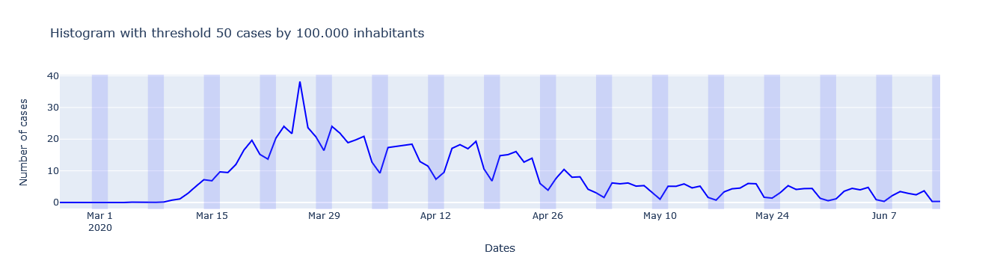

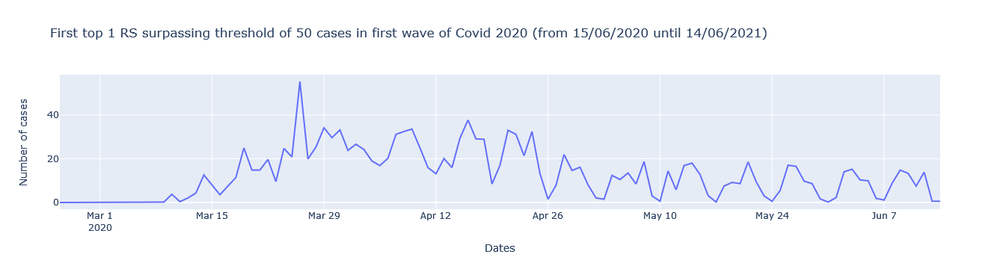

Threshold 100 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 100 cases by 100.000 inhabitants is 0, which represents 0.0%
No RS surpass threshold 100


In [116]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_no_missing_dates_rs.RS2.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates_rs.RS2 == j
        df = first_wave_no_missing_dates_rs[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Regions Sanitaries that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[first_wave_no_missing_dates_rs.DATA_parsed.min(), first_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No RS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' RS to surpass threshold ' + str(i) + ' are RS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_dates_rsgp = first_wave_no_missing_dates_rs.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_dates_rsgp['population'] = int(population)
    first_wave_no_missing_dates_rsgp['100hab'] = 100000
    first_wave_no_missing_dates_rsgp['proves100hab'] = (first_wave_no_missing_dates_rsgp['100hab'] * first_wave_no_missing_dates_rsgp['NUM_PROVES']) / first_wave_no_missing_dates_rsgp['population']
    first_wave_no_missing_dates_rsgp['weekend'] = np.where((first_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (first_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_rsgp['DATA_parsed'], y=first_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_rsgp.DATA_parsed ,y = first_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_dates_rs.DATA_parsed.min(), first_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' RS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid 2020 (from 15/06/2020 until 14/06/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates_rs.RS2 == l
        df = first_wave_no_missing_dates_rs[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='RS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 50 cases by 100.000 inhabitants is 7, which represents 100.0%
First 5 RS to surpass threshold 50 are RS {'LLEIDA': '[]', 'ALT PIRINEU i ARAN': '[]', 'BARCELONA': '[]', 'CATALUNYA CENTRAL': '[]', 'GIRONA': '[]'} with first date 07/07/2020


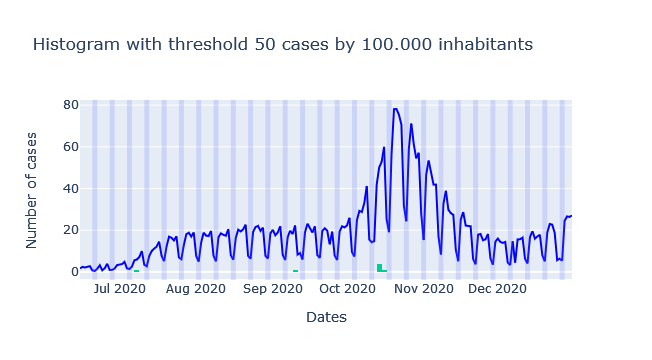

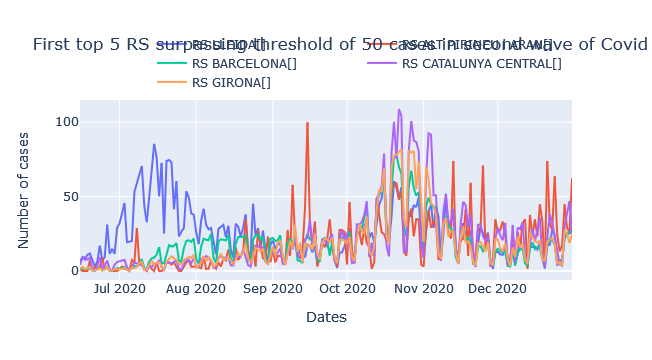

Threshold 100 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 100 cases by 100.000 inhabitants is 3, which represents 42.9%
First 3 RS to surpass threshold 100 are RS {'ALT PIRINEU i ARAN': '[]', 'CATALUNYA CENTRAL': '[]', 'CAMP DE TARRAGONA': '[]'} with first date 09/15/2020


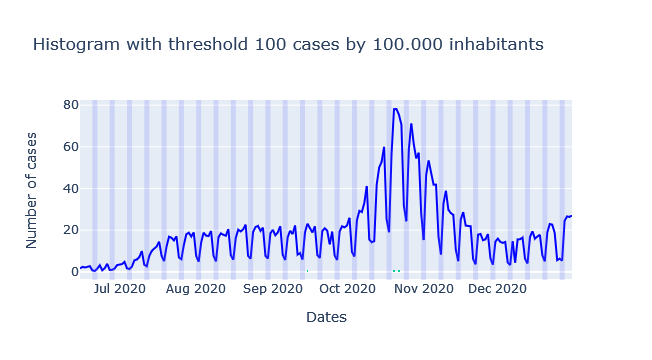

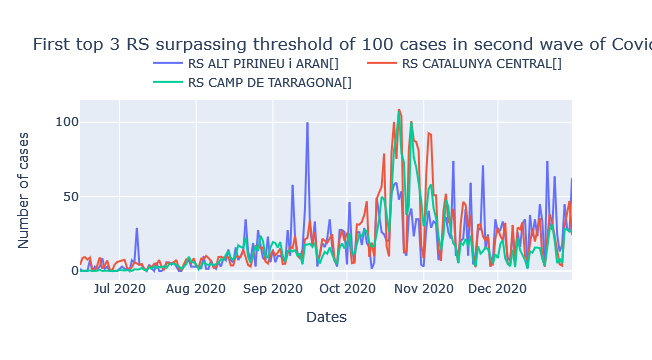

Threshold 200 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 200 cases by 100.000 inhabitants is 0, which represents 0.0%
No RS surpass threshold 200


In [87]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_wave_no_missing_dates_rs_1.RS2.unique()
    for j in abss:
        filterabs = second_wave_no_missing_dates_rs_1.RS2 == j
        df = second_wave_no_missing_dates_rs_1[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Regions Sanitaries that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No RS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' RS to surpass threshold ' + str(i) + ' are RS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_wave_no_missing_dates_rs_1.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' RS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates_rs_1.RS2 == l
        df = second_wave_no_missing_dates_rs_1[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='RS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 50 cases by 100.000 inhabitants is 2, which represents 28.6%
First 2 RS to surpass threshold 50 are RS {'ALT PIRINEU i ARAN': '[]', 'CATALUNYA CENTRAL': '[]'} with first date 01/04/2021


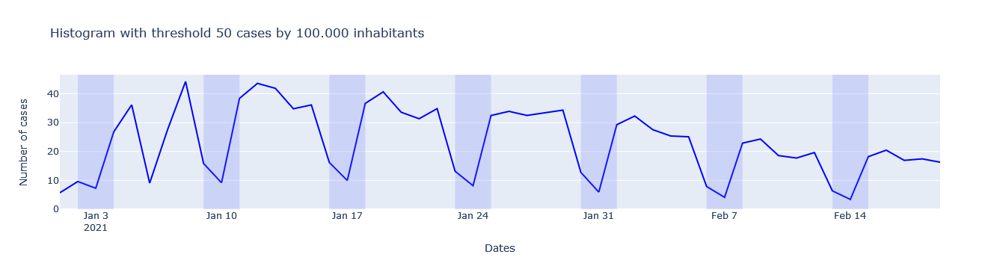

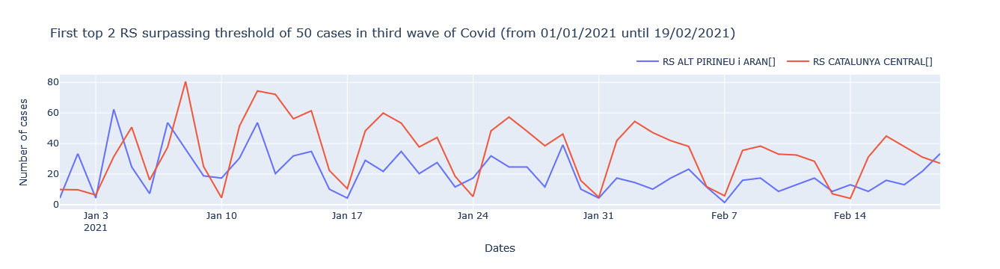

Threshold 100 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 100 cases by 100.000 inhabitants is 0, which represents 0.0%
No RS surpass threshold 100


In [117]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_year_first_wave.RS2.unique()
    for j in abss:
        filterabs = second_year_first_wave.RS2 == j
        df = second_year_first_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Regions Sanitaries that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No RS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' RS to surpass threshold ' + str(i) + ' are RS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_year_first_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' RS surpassing threshold of ' + str(i) +  ' cases in third wave of Covid (from 01/01/2021 until 19/02/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_year_first_wave.RS2 == l
        df = second_year_first_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='RS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 50 cases by 100.000 inhabitants is 3, which represents 42.9%
First 3 RS to surpass threshold 50 are RS {'ALT PIRINEU i ARAN': '[]', 'CATALUNYA CENTRAL': '[]', 'LLEIDA': '[]'} with first date 03/08/2021


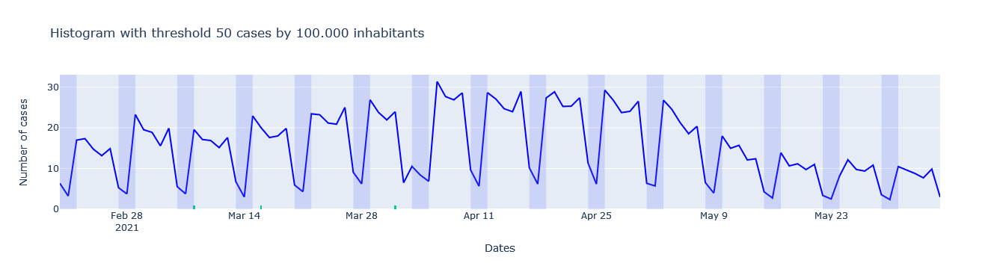

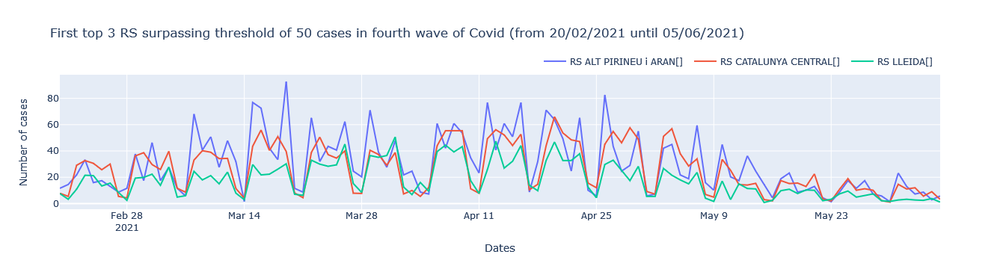

Threshold 100 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 100 cases by 100.000 inhabitants is 0, which represents 0.0%
No RS surpass threshold 100


In [118]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_year_second_wave.RS2.unique()
    for j in abss:
        filterabs = second_year_second_wave.RS2 == j
        df = second_year_second_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Regions Sanitaries that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No RS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' RS to surpass threshold ' + str(i) + ' are RS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_year_second_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' RS surpassing threshold of ' + str(i) +  ' cases in fourth wave of Covid (from 20/02/2021 until 05/06/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_year_second_wave.RS2 == l
        df = second_year_second_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='RS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 50 cases by 100.000 inhabitants is 4, which represents 57.1%
First 4 RS to surpass threshold 50 are RS {'ALT PIRINEU i ARAN': '[]', 'BARCELONA': '[]', 'CAMP DE TARRAGONA': '[]', 'GIRONA': '[]'} with first date 06/30/2021


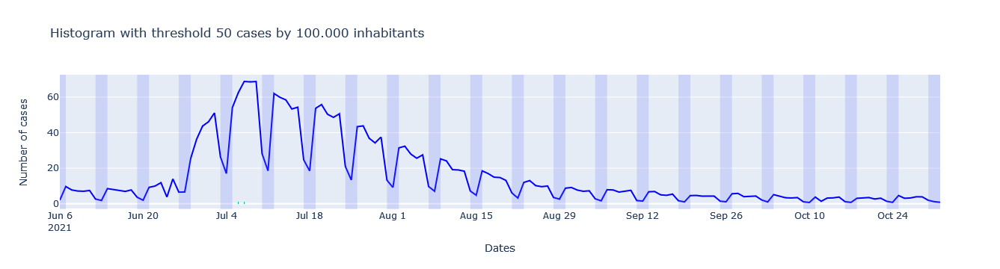

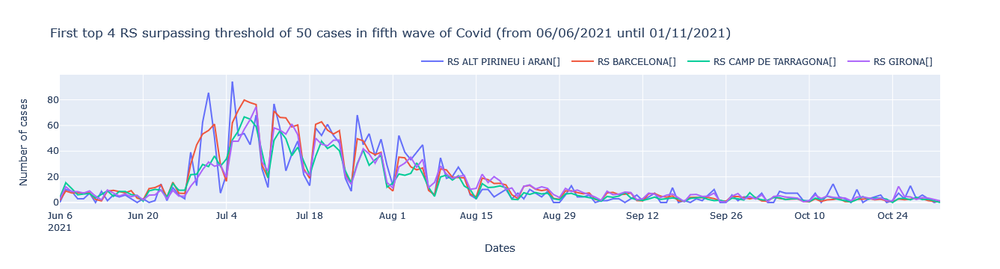

Threshold 100 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 100 cases by 100.000 inhabitants is 0, which represents 0.0%
No RS surpass threshold 100


In [119]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_year_third_wave.RS2.unique()
    for j in abss:
        filterabs = second_year_third_wave.RS2 == j
        df = second_year_third_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Regions Sanitaries that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No RS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' RS to surpass threshold ' + str(i) + ' are RS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_year_third_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' RS surpassing threshold of ' + str(i) +  ' cases in fifth wave of Covid (from 06/06/2021 until 01/11/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_year_third_wave.RS2 == l
        df = second_year_third_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='RS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

## SS ANALYSYS

In [91]:
# population by rs
pcrs = pd.read_csv('provesperdiaperABS.csv')
pcrs2 = pcrs.copy()
pcrs = pcrs.iloc[:,1:]
# pcrs = pcrs.rename(columns={"ABS1": "CODIABS"})
pcrs['DATA_parsed'] = pd.to_datetime(pcrs['DATA_parsed']).dt.date
pcrs = pcrs.drop('RelativeProves', axis = 1)
filterSES = pcrs.ABS1 == 'SES'
pcrs = pcrs[~filterSES]
pcrs['ABS1'] = pcrs['ABS1'].astype(str).astype(int)
print(pcrs.ABS1.nunique())
print(absrsss.ABS1.nunique())
absrsss['ABS1'] = absrsss['ABS1'].astype(str).astype(int)
print(absrsss.ABS1.nunique())
pcrsrs = pcrs.merge(absrsss)
pcrsrs
print(pcrsrs.ABS1.nunique())

/data/jupyter/software/miniconda_py39_4.10.3/envs/jupyterhub_0.4/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3251: DtypeWarning:

Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.



373
373
373
373


In [92]:
rsunique = pcrsrs.SS2.unique()
poprs = []
for i in rsunique:
    print(i)
    filterrs = pcrsrs.SS2 == i
    df = pcrsrs[filterrs]
    abss = df.ABS1.unique()
    print(len(abss))
    temppop = []
    for j in abss:
        filterabs = df.ABS1 == j
        df2 = df[filterabs]
        temppop.append(int(df2.NUM_INDIV.unique()))
    poprs.append(sum(temppop))
    
print(pcrsrs.ABS1.nunique())    
print(sum(poprs))
rspopdict = dict(zip(rsunique, poprs))
rspopdict

LLEIDA
23
TERRES DE L'EBRE
11
GIRONA SUD
21
ARAN
1
BARCELONÈS NORD I MARESME
37
SOLSONÈS-BAGES-BERGUEDÀ
18
TARRAGONÈS-BAIX PENEDÈS
16
BARCELONA CIUTAT VELLA
5
BARCELONA EIXAMPLE
10
BARCELONA SANTS-MONTJUÏC
8
BARCELONA LES CORTS
3
BARCELONA SARRIÀ-SANT GERVASI
5
BARCELONA GRÀCIA
5
BARCELONA HORTA-GUINARDÓ
7
BARCELONA NOU BARRIS
8
BARCELONA SANT ANDREU
6
BARCELONA SANT MARTÍ
10
GIRONA NORD
20
BAIX CAMP-PRIORAT
13
ANOIA
9
VALLÈS ORIENTAL
19
VALLÈS OCCIDENTAL EST
20
OSONA
11
ALT PIRINEU
7
BAIX LLOBREGAT CENTRE-LITORAL I L'H.LL.
43
BAIX LLOBREGAT NORD
7
ALT CAMP-CONCA DE BARBERÀ
4
ALT PENEDÈS-GARRAF
11
VALLÈS OCCIDENTAL OEST
15
373
7722114


{'LLEIDA': 366906,
 "TERRES DE L'EBRE": 178635,
 'GIRONA SUD': 521693,
 'ARAN': 9520,
 'BARCELONÈS NORD I MARESME': 714832,
 'SOLSONÈS-BAGES-BERGUEDÀ': 253010,
 'TARRAGONÈS-BAIX PENEDÈS': 352062,
 'BARCELONA CIUTAT VELLA': 104341,
 'BARCELONA EIXAMPLE': 271282,
 'BARCELONA SANTS-MONTJUÏC': 186716,
 'BARCELONA LES CORTS': 81206,
 'BARCELONA SARRIÀ-SANT GERVASI': 145517,
 'BARCELONA GRÀCIA': 124356,
 'BARCELONA HORTA-GUINARDÓ': 172844,
 'BARCELONA NOU BARRIS': 173437,
 'BARCELONA SANT ANDREU': 151297,
 'BARCELONA SANT MARTÍ': 238784,
 'GIRONA NORD': 352297,
 'BAIX CAMP-PRIORAT': 203775,
 'ANOIA': 114708,
 'VALLÈS ORIENTAL': 454031,
 'VALLÈS OCCIDENTAL EST': 438025,
 'OSONA': 164878,
 'ALT PIRINEU': 59417,
 "BAIX LLOBREGAT CENTRE-LITORAL I L'H.LL.": 958392,
 'BAIX LLOBREGAT NORD': 161710,
 'ALT CAMP-CONCA DE BARBERÀ': 61884,
 'ALT PENEDÈS-GARRAF': 260112,
 'VALLÈS OCCIDENTAL OEST': 446447}

In [93]:
no_missing_dates_rs = no_missing_dates.copy()
no_missing_dates_rs = no_missing_dates_rs.merge(absrsss, left_on='CODIABS', right_on='ABS1')
no_missing_dates_rs

,DATA_parsed,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab,ABS1,ABS2,SS1,SS2,RS1,RS2
0,2020-02-25,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
1,2020-02-26,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
2,2020-02-27,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
3,2020-02-28,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
4,2020-02-29,1,0,0,0,0.000000,1,AGRAMUNT,6156,LLEIDA,61,LLEIDA
...,...,...,...,...,...,...,...,...,...,...,...,...
229763,2021-10-28,403,29403,1,100000,3.401014,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA
229764,2021-10-29,403,0,0,0,0.000000,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA
229765,2021-10-30,403,0,0,0,0.000000,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA
229766,2021-10-31,403,0,0,0,0.000000,403,BARCELONA 8-L,7854,BARCELONA NOU BARRIS,78,BARCELONA


In [94]:
no_missing_dates_rs = no_missing_dates_rs[['DATA_parsed','NUM_PROVES','SS2','CODIABS']]
no_missing_dates_rs = no_missing_dates_rs.groupby(['DATA_parsed', 'SS2'])['NUM_PROVES'].sum().reset_index()
no_missing_dates_rs["NUM_IND" ] = no_missing_dates_rs["SS2"].map(rspopdict)
no_missing_dates_rs['100pop'] = 100000
no_missing_dates_rs['cases100hab'] = ( no_missing_dates_rs['100pop'] * no_missing_dates_rs['NUM_PROVES'] ) / no_missing_dates_rs['NUM_IND']
no_missing_dates_rs
# no_missing_dates_rs[no_missing_dates_rs['DATA_parsed']=='2020-03-26']['NUM_IND'].sum()

,DATA_parsed,SS2,NUM_PROVES,NUM_IND,100pop,cases100hab
0,2020-02-25,ALT CAMP-CONCA DE BARBERÀ,0,61884,100000,0.000000
1,2020-02-25,ALT PENEDÈS-GARRAF,0,260112,100000,0.000000
2,2020-02-25,ALT PIRINEU,0,59417,100000,0.000000
3,2020-02-25,ANOIA,0,114708,100000,0.000000
4,2020-02-25,ARAN,0,9520,100000,0.000000
...,...,...,...,...,...,...
17859,2021-11-01,TARRAGONÈS-BAIX PENEDÈS,0,352062,100000,0.000000
17860,2021-11-01,TERRES DE L'EBRE,3,178635,100000,1.679402
17861,2021-11-01,VALLÈS OCCIDENTAL EST,3,438025,100000,0.684892
17862,2021-11-01,VALLÈS OCCIDENTAL OEST,2,446447,100000,0.447982


In [95]:
no_missing_dates_rs.cases100hab.max()

146.23927907987826

In [96]:
# first_wave_pcrs_filter = pcrs['DATA_parsed'] < pd.to_datetime('2020-06-15').date()
first_wave_no_missing_dates_filter = no_missing_dates_rs['DATA_parsed'] < '2020-06-15'
first_wave_no_missing_dates_rs = no_missing_dates_rs[first_wave_no_missing_dates_filter]
second_wave_no_missing_dates_rs = no_missing_dates_rs[~first_wave_no_missing_dates_filter]
filter_second_wave_no_missing_dates = second_wave_no_missing_dates_rs['DATA_parsed'] < '2021-01-01'
second_wave_no_missing_dates_rs_1 = second_wave_no_missing_dates_rs[filter_second_wave_no_missing_dates]

In [97]:
second_year_no_missing_dates_rs = second_wave_no_missing_dates_rs[~filter_second_wave_no_missing_dates]
 
second_year_first_wave_filter = second_year_no_missing_dates_rs['DATA_parsed'] < '2021-02-20'
second_year_first_wave = second_year_no_missing_dates_rs[second_year_first_wave_filter]
second_year_no_missing_dates_r2 = second_year_no_missing_dates_rs[~second_year_first_wave_filter]
second_year_second_wave_filter = second_year_no_missing_dates_r2['DATA_parsed'] < '2021-06-06'
second_year_second_wave = second_year_no_missing_dates_r2[second_year_second_wave_filter]
second_year_third_wave = second_year_no_missing_dates_r2[~second_year_second_wave_filter]


In [102]:
second_year_first_wave

,DATA_parsed,SS2,NUM_PROVES,NUM_IND,100pop,cases100hab
9019,2021-01-01,ALT CAMP-CONCA DE BARBERÀ,0,61884,100000,0.000000
9020,2021-01-01,ALT PENEDÈS-GARRAF,10,260112,100000,3.844498
9021,2021-01-01,ALT PIRINEU,3,59417,100000,5.049060
9022,2021-01-01,ANOIA,8,114708,100000,6.974230
9023,2021-01-01,ARAN,0,9520,100000,0.000000
...,...,...,...,...,...,...
10464,2021-02-19,TARRAGONÈS-BAIX PENEDÈS,31,352062,100000,8.805267
10465,2021-02-19,TERRES DE L'EBRE,15,178635,100000,8.397011
10466,2021-02-19,VALLÈS OCCIDENTAL EST,59,438025,100000,13.469551
10467,2021-02-19,VALLÈS OCCIDENTAL OEST,92,446447,100000,20.607149


In [98]:
first_wave_no_missing_dates_rs

,DATA_parsed,SS2,NUM_PROVES,NUM_IND,100pop,cases100hab
0,2020-02-25,ALT CAMP-CONCA DE BARBERÀ,0,61884,100000,0.0
1,2020-02-25,ALT PENEDÈS-GARRAF,0,260112,100000,0.0
2,2020-02-25,ALT PIRINEU,0,59417,100000,0.0
3,2020-02-25,ANOIA,0,114708,100000,0.0
4,2020-02-25,ARAN,0,9520,100000,0.0
...,...,...,...,...,...,...
3214,2020-06-14,TARRAGONÈS-BAIX PENEDÈS,0,352062,100000,0.0
3215,2020-06-14,TERRES DE L'EBRE,0,178635,100000,0.0
3216,2020-06-14,VALLÈS OCCIDENTAL EST,0,438025,100000,0.0
3217,2020-06-14,VALLÈS OCCIDENTAL OEST,0,446447,100000,0.0


Threshold 50 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 50 cases by 100.000 inhabitants is 11, which represents 37.9%
First 5 RS to surpass threshold 50 are RS {'ANOIA': '[]', 'ARAN': '[]', 'BAIX LLOBREGAT NORD': '[]', 'BARCELONA CIUTAT VELLA': '[]', 'BARCELONA GRÀCIA': '[]'} with first date 03/14/2020


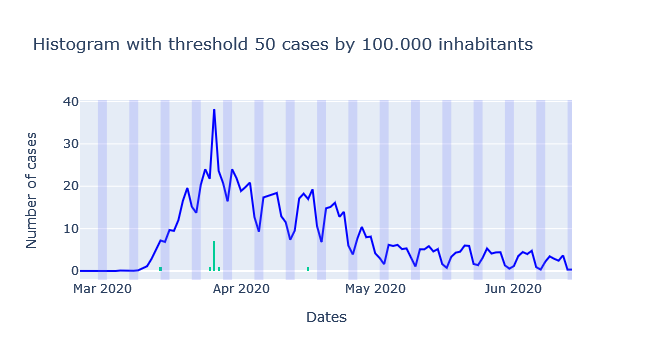

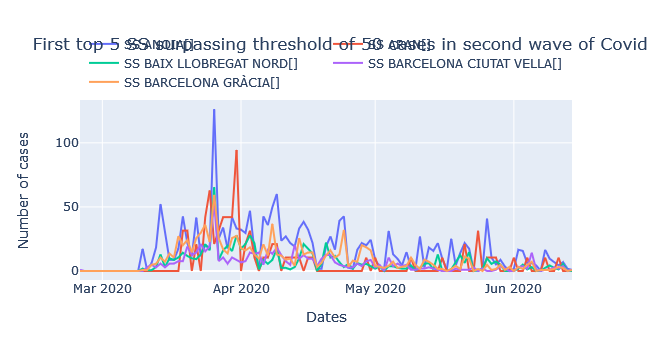

Threshold 100 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 100 cases by 100.000 inhabitants is 1, which represents 3.4%
First 1 RS to surpass threshold 100 are RS {'ANOIA': '[]'} with first date 03/26/2020


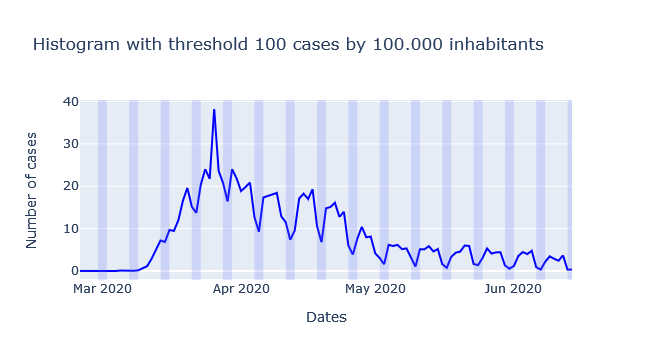

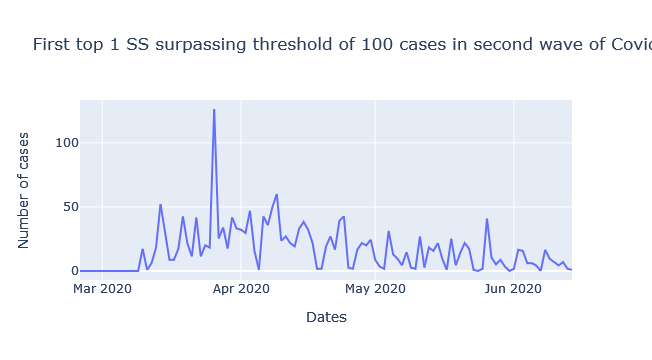

Threshold 200 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 200 cases by 100.000 inhabitants is 0, which represents 0.0%
No SS surpass threshold 200


In [99]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_no_missing_dates_rs.SS2.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates_rs.SS2 == j
        df = first_wave_no_missing_dates_rs[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Sectors Sanitaris that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[first_wave_no_missing_dates_rs.DATA_parsed.min(), first_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No SS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' RS to surpass threshold ' + str(i) + ' are RS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_dates_rsgp = first_wave_no_missing_dates_rs.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_dates_rsgp['population'] = int(population)
    first_wave_no_missing_dates_rsgp['100hab'] = 100000
    first_wave_no_missing_dates_rsgp['proves100hab'] = (first_wave_no_missing_dates_rsgp['100hab'] * first_wave_no_missing_dates_rsgp['NUM_PROVES']) / first_wave_no_missing_dates_rsgp['population']
    first_wave_no_missing_dates_rsgp['weekend'] = np.where((first_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (first_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_rsgp['DATA_parsed'], y=first_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_dates_rsgp.DATA_parsed ,y = first_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_dates_rs.DATA_parsed.min(), first_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' SS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates_rs.SS2 == l
        df = first_wave_no_missing_dates_rs[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='SS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 50 cases by 100.000 inhabitants is 29, which represents 100.0%
First 5 RS to surpass threshold 50 are SS {'LLEIDA': '[]', 'BARCELONA SANTS-MONTJUÏC': '[]', 'ARAN': '[]', 'ALT PIRINEU': '[]', 'OSONA': '[]'} with first date 07/07/2020


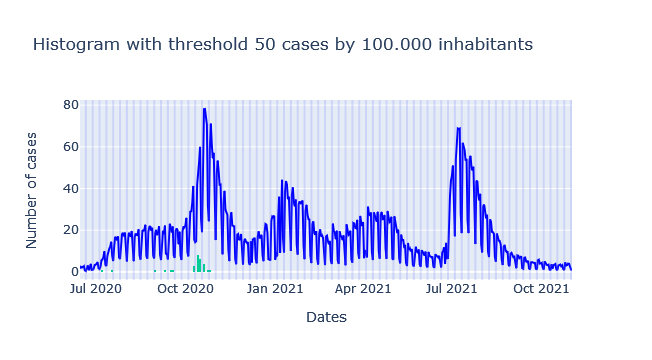

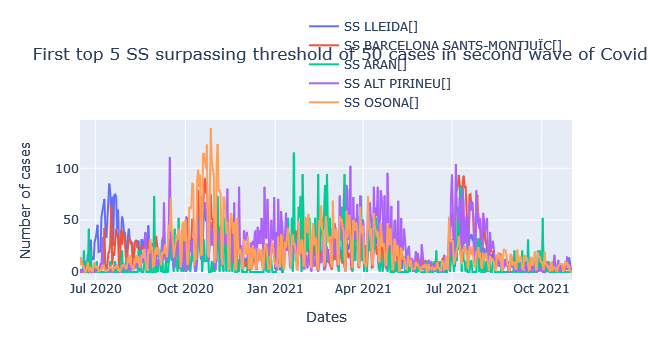

Threshold 100 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 100 cases by 100.000 inhabitants is 16, which represents 55.2%
First 5 RS to surpass threshold 100 are SS {'ALT PIRINEU': '[]', 'BARCELONA CIUTAT VELLA': '[]', 'OSONA': '[]', 'BAIX LLOBREGAT NORD': '[]', 'BARCELONA LES CORTS': '[]'} with first date 09/15/2020


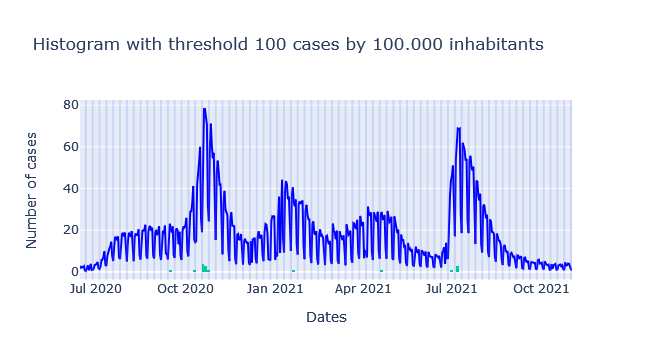

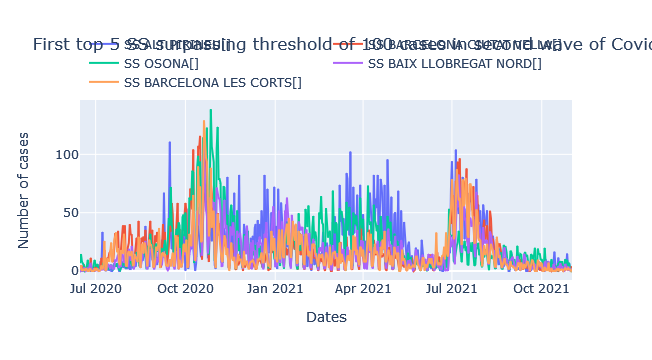

Threshold 200 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 200 cases by 100.000 inhabitants is 0, which represents 0.0%
No SS surpass threshold 200


In [100]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_wave_no_missing_dates_rs.SS2.unique()
    for j in abss:
        filterabs = second_wave_no_missing_dates_rs.SS2 == j
        df = second_wave_no_missing_dates_rs[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Sectors Sanitaris that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No SS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' RS to surpass threshold ' + str(i) + ' are SS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_wave_no_missing_dates_rs.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' SS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates_rs.SS2 == l
        df = second_wave_no_missing_dates_rs[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='SS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 50 cases by 100.000 inhabitants is 16, which represents 55.2%
First 5 RS to surpass threshold 50 are RS {'ALT PIRINEU': '[]', 'ALT PENEDÈS-GARRAF': '[]', 'ANOIA': '[]', 'BAIX LLOBREGAT NORD': '[]', 'BARCELONA NOU BARRIS': '[]'} with first date 01/04/2021


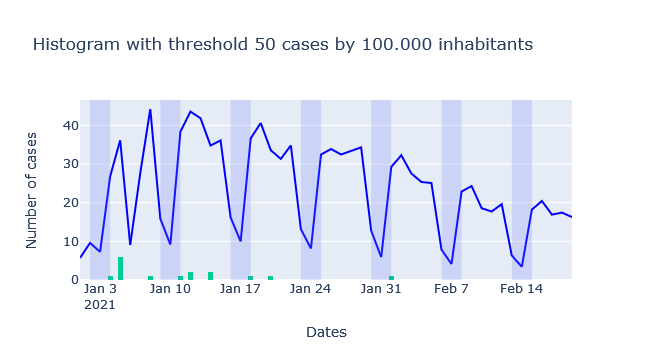

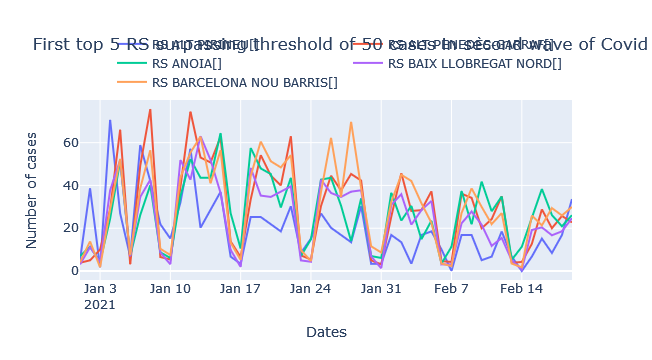

Threshold 100 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 100 cases by 100.000 inhabitants is 2, which represents 6.9%
First 2 RS to surpass threshold 100 are RS {'SOLSONÈS-BAGES-BERGUEDÀ': '[]', 'ARAN': '[]'} with first date 01/08/2021


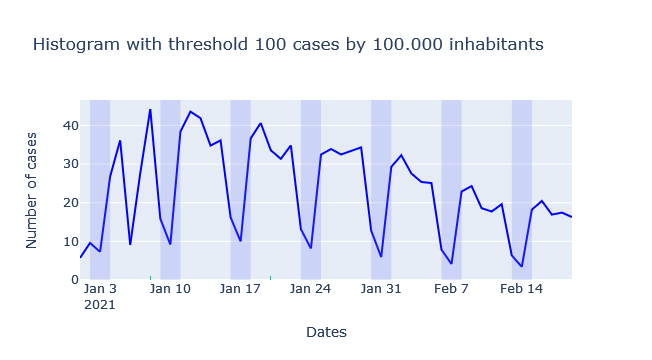

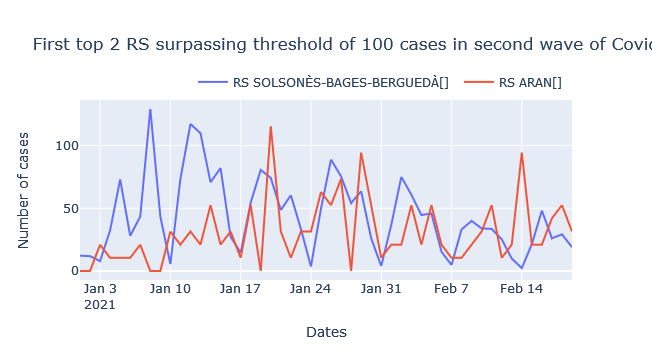

Threshold 200 cases by 100.000 population
Number of Regions Sanitaries that surpass the threshold 200 cases by 100.000 inhabitants is 0, which represents 0.0%
No RS surpass threshold 200


In [103]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_year_first_wave.SS2.unique()
    for j in abss:
        filterabs = second_year_first_wave.SS2 == j
        df = second_year_first_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Regions Sanitaries that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No RS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' SS to surpass threshold ' + str(i) + ' are SS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_year_first_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' SS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_year_first_wave.SS2 == l
        df = second_year_first_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='SS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 50 cases by 100.000 inhabitants is 8, which represents 27.6%
First 5 SS to surpass threshold 50 are SS {'ARAN': '[]', 'OSONA': '[]', 'ALT PIRINEU': '[]', 'ANOIA': '[]', 'ALT CAMP-CONCA DE BARBERÀ': '[]'} with first date 02/20/2021


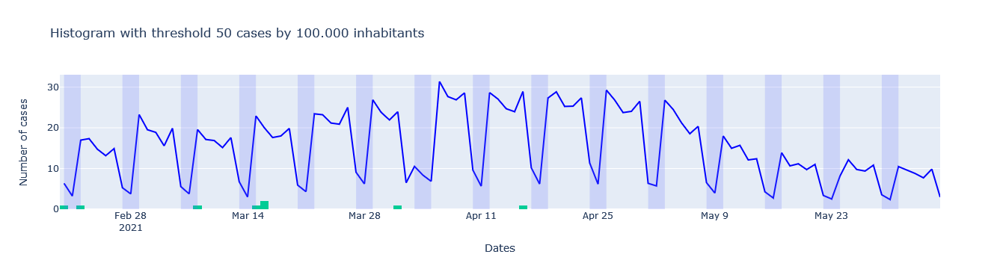

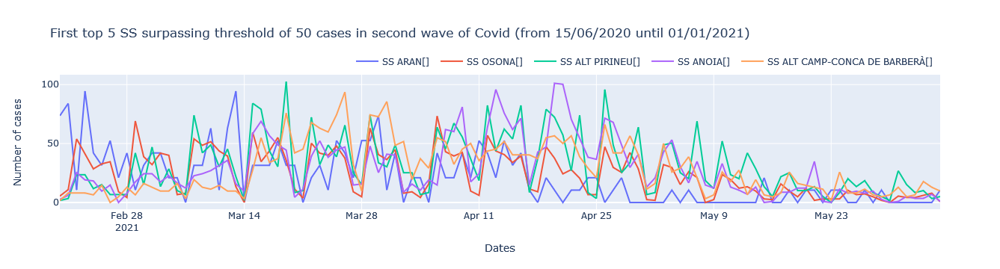

Threshold 100 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 100 cases by 100.000 inhabitants is 2, which represents 6.9%
First 2 SS to surpass threshold 100 are SS {'ALT PIRINEU': '[]', 'ANOIA': '[]'} with first date 03/19/2021


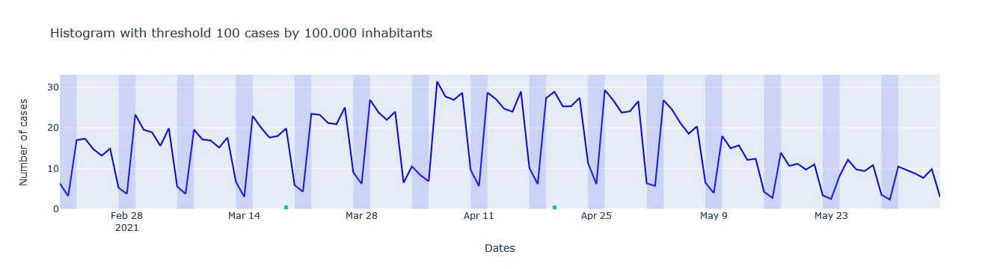

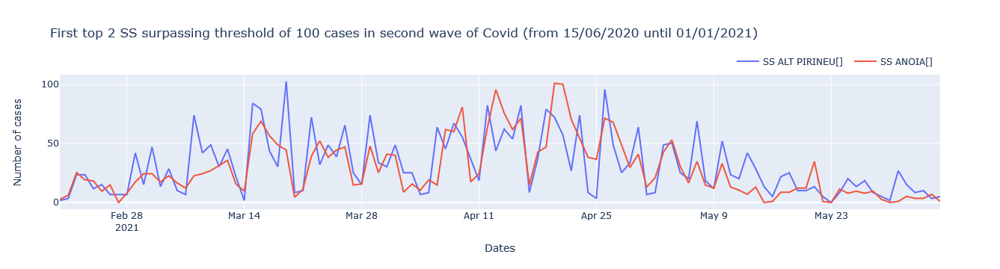

Threshold 200 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 200 cases by 100.000 inhabitants is 0, which represents 0.0%
No RS surpass threshold 200


In [107]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_year_second_wave.SS2.unique()
    for j in abss:
        filterabs = second_year_second_wave.SS2 == j
        df = second_year_second_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Sectors Sanitaris that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No RS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' SS to surpass threshold ' + str(i) + ' are SS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_year_second_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' SS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_year_second_wave.SS2 == l
        df = second_year_second_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='SS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

Threshold 50 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 50 cases by 100.000 inhabitants is 26, which represents 89.7%
First 5 SS to surpass threshold 50 are SS {'BARCELONA SARRIÀ-SANT GERVASI': '[]', 'OSONA': '[]', 'BARCELONA EIXAMPLE': '[]', 'VALLÈS OCCIDENTAL EST': '[]', 'ALT CAMP-CONCA DE BARBERÀ': '[]'} with first date 06/28/2021


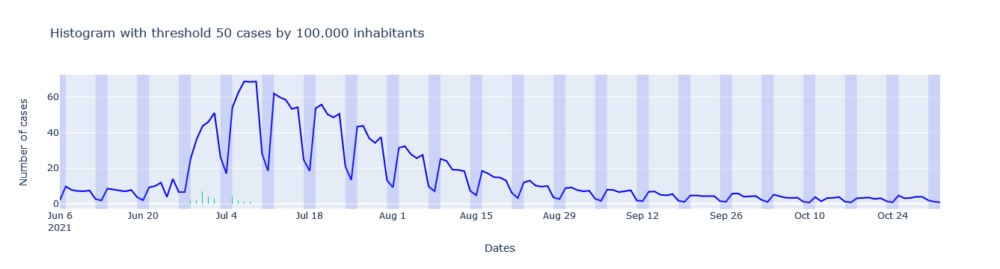

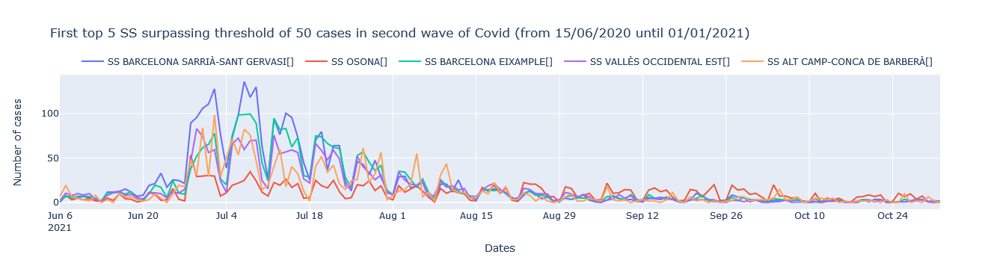

Threshold 100 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 100 cases by 100.000 inhabitants is 5, which represents 17.2%
First 5 SS to surpass threshold 100 are SS {'BARCELONA SARRIÀ-SANT GERVASI': '[]', 'ALT PIRINEU': '[]', 'ALT PENEDÈS-GARRAF': '[]', 'BARCELONA GRÀCIA': '[]', 'BARCELONA SANT MARTÍ': '[]'} with first date 06/30/2021


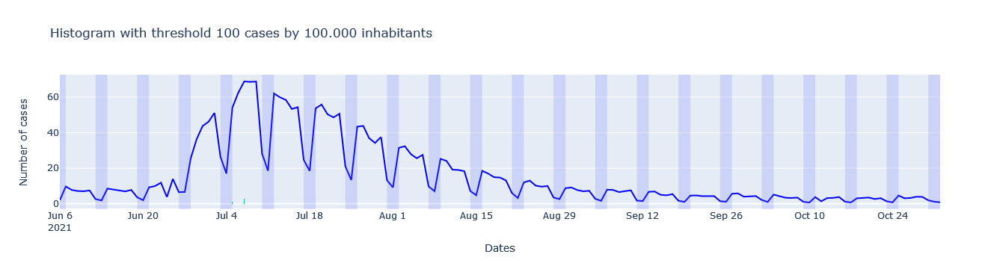

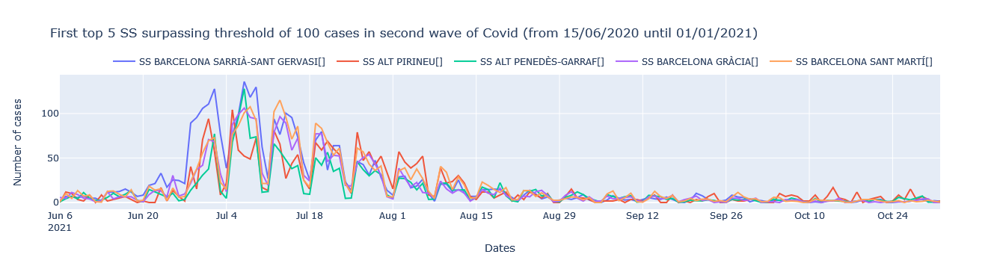

Threshold 200 cases by 100.000 population
Number of Sectors Sanitaris that surpass the threshold 200 cases by 100.000 inhabitants is 0, which represents 0.0%
No SS surpass threshold 200


In [106]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50, 100, 200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_year_third_wave.SS2.unique()
    for j in abss:
        filterabs = second_year_third_wave.SS2 == j
        df = second_year_third_wave[filterabs]
        df = df.sort_values(by = ['DATA_parsed'])
        df = df.set_index('DATA_parsed') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('Number of Sectors Sanitaris that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)) + ', which represents {:.1%}'.format(len(datesbyabsthreshold)/len(abss)))
    # fig = px.histogram(datesbyabsthreshold, nbins=100)
    # fig.update_layout(showlegend=False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    # fig.show()  
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    if len(min_date_kabs_l) == 0:
        print('No SS surpass threshold ' + str(i))
        break
    print('First ' + str(K) + ' SS to surpass threshold ' + str(i) + ' are SS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_dates_rsgp = second_year_third_wave.groupby(['DATA_parsed'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_dates_rsgp['population'] = int(population)
    second_wave_no_missing_dates_rsgp['100hab'] = 100000
    second_wave_no_missing_dates_rsgp['proves100hab'] = (second_wave_no_missing_dates_rsgp['100hab'] * second_wave_no_missing_dates_rsgp['NUM_PROVES']) / second_wave_no_missing_dates_rsgp['population']
    second_wave_no_missing_dates_rsgp['weekend'] = np.where((second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 5) | (second_wave_no_missing_dates_rsgp.DATA_parsed.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp['DATA_parsed'], y=second_wave_no_missing_dates_rsgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_dates_rsgp.DATA_parsed ,y = second_wave_no_missing_dates_rsgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_dates_rs.DATA_parsed.min(), second_wave_no_missing_dates_rs.DATA_parsed.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' SS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')    
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_year_third_wave.SS2 == l
        df = second_year_third_wave[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.DATA_parsed, y = df.cases100hab, name='SS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# if we take into accunt first threshold, lleida province is clearly when second wave started earlier

In [ ]:
# fer segona meitat d'any 
# SS i RS per 100000 hab

## Weekly analysis

In [90]:
pcrsw = pd.read_csv('provespersemanaperABS.csv')
pcrsw = pcrsw.iloc[:,1:]
pcrsw = pcrsw.rename(columns={"ABS1": "CODIABS"})
pcrsw['WeekDate'] = pd.to_datetime(pcrsw['WeekDate']).dt.date
pcrsw.WeekDate = pcrsw.WeekDate.astype('datetime64[ns]')
pcrsw = pcrsw.drop('RelativeProves', axis = 1)
pcrsw

,CODIABS,NUM_INDIV,WeekDate,NUM_PROVES
0,001,6495,2020-03-09,1
1,001,6495,2020-03-16,4
2,001,6495,2020-03-23,2
3,001,6495,2020-04-06,6
4,001,6495,2020-04-13,3
...,...,...,...,...
30380,403,29403,2021-10-04,13
30381,403,29403,2021-10-11,8
30382,403,29403,2021-10-18,5
30383,403,29403,2021-10-25,2


In [91]:
pcrsw.dtypes, data.dtypes

(CODIABS               object
 NUM_INDIV              int64
 WeekDate      datetime64[ns]
 NUM_PROVES             int64
 dtype: object,
 CODIABS        int64
 NOMABS        object
 geometry    geometry
 dtype: object)

In [92]:
pcrsw['100hab'] = 100000
pcrsw['cases100hab'] = ( pcrsw['100hab'] * pcrsw.NUM_PROVES ) / pcrsw.NUM_INDIV
filterSES = pcrsw.CODIABS == 'SES'
pcrsw = pcrsw[~filterSES]

In [93]:
pcrsw['CODIABS'] = pcrsw['CODIABS'].astype(str).astype(int)
data['CODIABS'] = data['CODIABS'].astype(str).astype(int)

/tmp/ipykernel_96/257049035.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [94]:
# ABS = pcrsw.CODIABS.unique()
# # ABS
# for i in ABS:
#     filterABS = pcrsw.CODIABS == i
#     df = pcrsw[filterABS]
#     fig = px.bar(x = df.WeekDate, y = df.cases100hab, title = 'Relative weekly tests distribution over time by ABS ' + str(i), labels = {"x": "DATE", "y": "Normalized tests by 100.000 population"})
#     fig.show()
#     plotly.offline.plot(fig,filename= 'AgregatedDataplots/AgregatedData-Tests/TestsbyABS/Normalized_tests_weekly/abs'+str(i)+'.html',config={'displayModeBar': False})

In [95]:
# no_missing_dates_w = pcrsw.copy()
# no_missing_dates_w = no_missing_dates_w.set_index(
#     ['WeekDate', 'CODIABS']
# ).unstack(
#     fill_value=0
# ).asfreq(
#     'W', fill_value=0
# ).stack().sort_index(level=1).reset_index()


### First wave weekly analysis

In [96]:
first_wave_pcrs_filter = pcrsw['WeekDate'] < '2020-06-01'

In [97]:
first_wave_pcrs = pcrsw[first_wave_pcrs_filter]
pcrsw.shape, first_wave_pcrs.shape

((30384, 6), (4123, 6))

In [98]:
first_wave_pcrs.cases100hab.max()

820.4193254329991

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 169
First 5 ABSs to surpass threshold 200 are ABS {372: "['IGUALADA-2']", 124: "['GIRONA 1']", 126: "['GIRONA 3']", 127: "['GIRONA 4']", 183: "['EL PRAT DE LLOBREGAT 2']"} with first date 03/09/2020


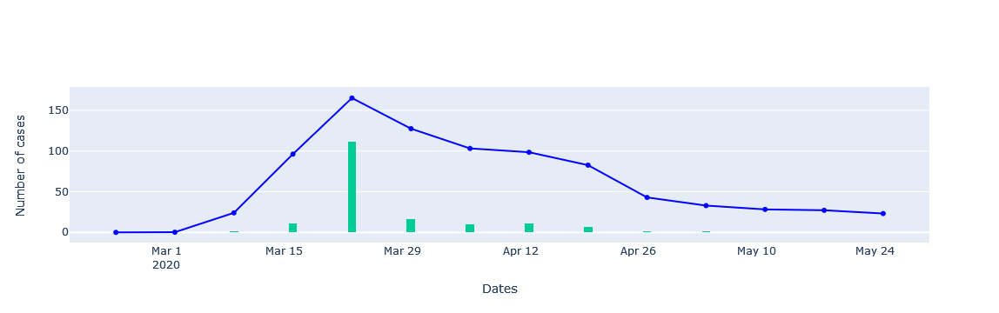

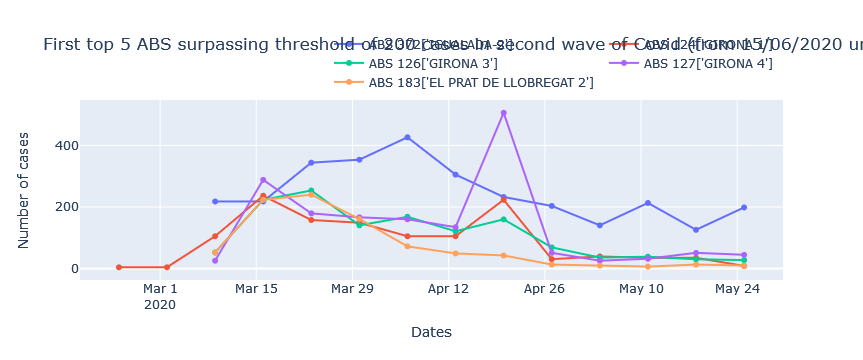

Threshold 400 cases by 100.000 population
Number of ABS that surpass the threshold 400 cases by 100.000 inhabitants is 15
First 5 ABSs to surpass threshold 400 are ABS {204: "['SANT BOI DE LLOBREGAT 3']", 96: "['CARDONA']", 88: "['CALAF']", 228: "['SANTA COLOMA DE QUERALT']", 372: "['IGUALADA-2']"} with first date 03/23/2020


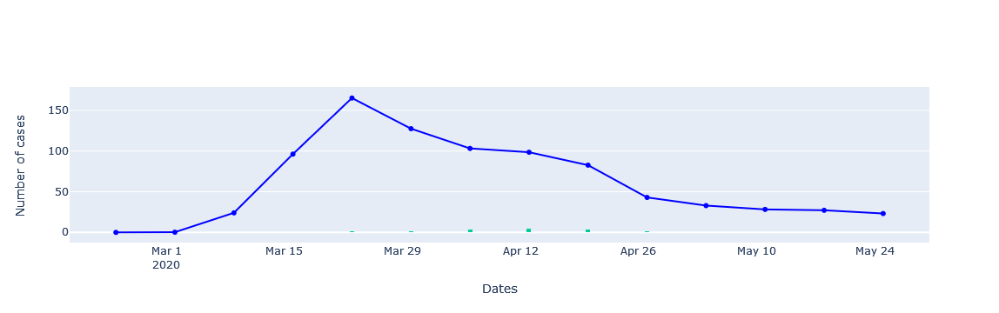

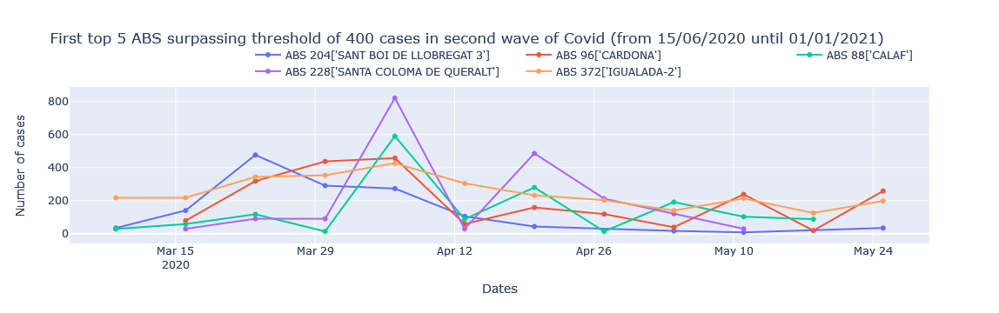

Threshold 600 cases by 100.000 population
Number of ABS that surpass the threshold 600 cases by 100.000 inhabitants is 3
First 3 ABSs to surpass threshold 600 are ABS {228: "['SANTA COLOMA DE QUERALT']", 55: "['BARCELONA 7-E']", 159: "['MOIÀ']"} with first date 04/06/2020


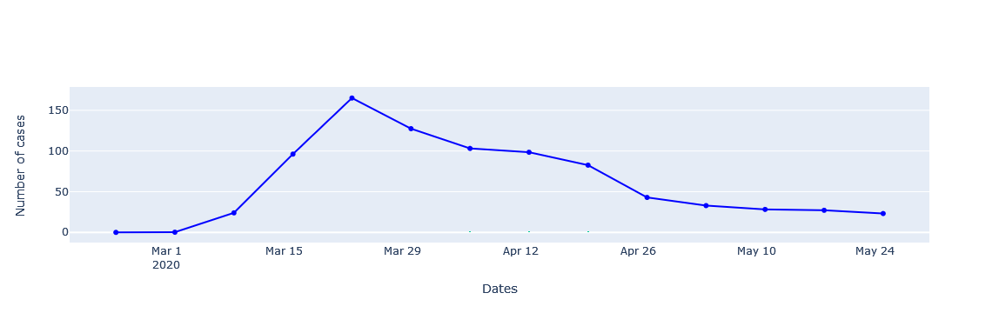

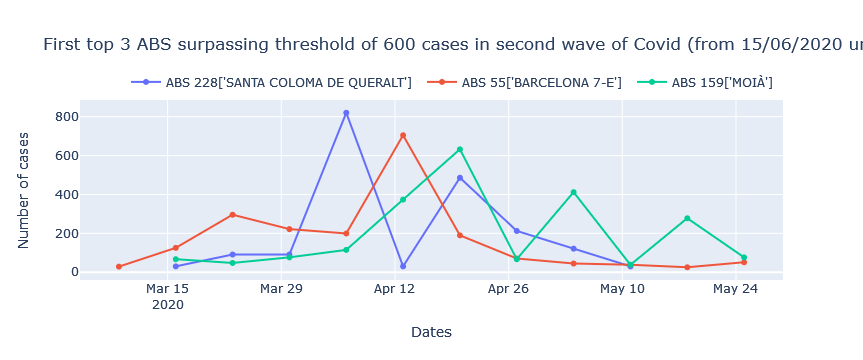

In [99]:
# check when each abs surpasses threshold

threshs = [200,400,600]

for i in threshs:
    print('Threshold ' + str(i) + ' cases by 100.000 population')
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_pcrs.CODIABS.unique()
    for j in abss:
        filterabs = first_wave_pcrs.CODIABS == j
        df = first_wave_pcrs  [filterabs]
        df = df.sort_values(by = ['WeekDate'])
        df = df.set_index('WeekDate') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)       
        else: 
            pass
            # print('No more than ' + str(i) + ' cases in the first wave were registered')
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))    
    # first_wave_no_missing_datesgp = first_wave_pcrs.groupby(['WeekDate'])['cases100hab'].sum()
    # fig = px.line(x = first_wave_no_missing_datesgp.index ,y = first_wave_no_missing_datesgp, title='First wave evolution of positive cases')
    # fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')    
    # fig.show()
    first_wave_no_missing_datesgp = first_wave_pcrs.groupby(['WeekDate'])['NUM_PROVES'].sum().reset_index()
    first_wave_no_missing_datesgp['population'] = int(population)
    first_wave_no_missing_datesgp['100hab'] = 100000
    first_wave_no_missing_datesgp['proves100hab'] = (first_wave_no_missing_datesgp['100hab'] * first_wave_no_missing_datesgp['NUM_PROVES']) / first_wave_no_missing_datesgp['population']
    first_wave_no_missing_datesgp['weekend'] = np.where((first_wave_no_missing_datesgp.WeekDate.dt.weekday == 5) | (first_wave_no_missing_datesgp.WeekDate.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_datesgp['WeekDate'], y=first_wave_no_missing_datesgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_datesgp.WeekDate ,y = first_wave_no_missing_datesgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_datesgp.WeekDate.min(), first_wave_no_missing_datesgp.WeekDate.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_pcrs.CODIABS == l
        df = first_wave_pcrs[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.WeekDate, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# starts in Girona mainly

In [100]:
# # check when each abs surpasses threshold

# threshs = [50,100,150,200,250,300,350,400,450,500,1200]

# for i in threshs:
#     print('Threshold ' + str(i) + ' cases by 100.000 population')
#     datesbyabsthreshold = []
#     absbythreshold = []    
#     abss = first_wave_no_missing_dates.CODIABS.unique()
#     for j in abss:
#         filterabs = first_wave_no_missing_dates.CODIABS == j
#         df = first_wave_no_missing_dates[filterabs]
#         df = df.sort_values(by = ['WeekDate'])
#         df = df.set_index('WeekDate') 
#         df = df[(df.cases100hab > i)]
#         if len(df) > 0:
#             date = (df.cases100hab > i).idxmax()
#             datesbyabsthreshold.append(date)
#             absbythreshold.append(j) 
#         else: pass
#     K = 5
#     min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
#     min_kabs_l = [i[0] for i in min_kabs_list]
#     min_date_kabs_l = [i[1] for i in min_kabs_list]   
#     if len(min_kabs_l) < K:
#         K = len(min_kabs_l)
#     else: pass
#     print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(min_kabs_l) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
#     first_wave_no_missing_datesgp = first_wave_no_missing_dates.groupby(['WeekDate'])['cases100hab'].sum()
#     fig = px.line(x = first_wave_no_missing_datesgp.index ,y = first_wave_no_missing_datesgp, title='First wave evolution of positive cases')
#     fig.show()
#     fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid (until 15/06/2020')
#     for l in min_kabs_l:
#         filterABS = first_wave_no_missing_dates.CODIABS == l
#         df = first_wave_no_missing_dates[filterABS]
#         fig.add_trace(go.Scatter(x = df.WeekDate, y = df.cases100hab, name='ABS ' + str(l)))
#     fig.show()
#     # break


### Second wave weekly analysis

In [101]:
second_wave_pcrs = pcrsw[~first_wave_pcrs_filter]
filter_second_wave_pcrs = second_wave_pcrs['WeekDate'] < '2021-01-01'
second_wave_pcrs = second_wave_pcrs[filter_second_wave_pcrs]
pcrsw.shape, second_wave_pcrs.shape

((30384, 6), (10747, 6))

In [102]:
second_wave_pcrs.cases100hab.max()

2156.7462002207694

Threshold 200 cases by 100.000 population
Number of ABS that surpass the threshold 200 cases by 100.000 inhabitants is 368
First 5 ABSs to surpass threshold 200 are ABS {159: "['MOIÀ']", 347: '["VALL D\'EN BAS"]', 237: "['SÚRIA']", 2: "['ALCARRÀS']", 135: "['LLEIDA 1 CENTRE HISTÒRIC-RAMBLA FERRAN']"} with first date 06/01/2020


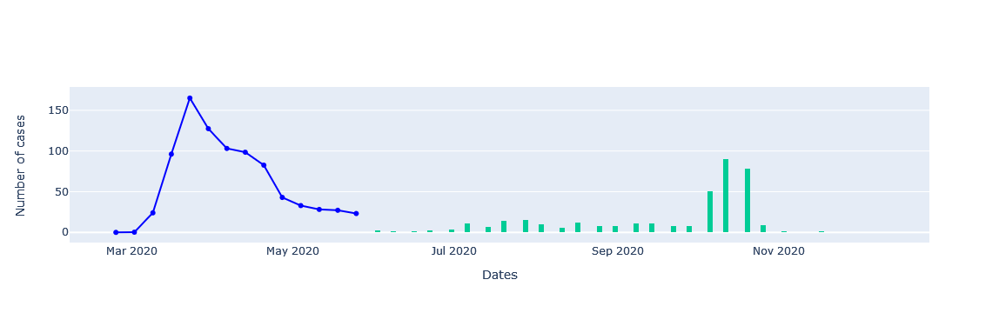

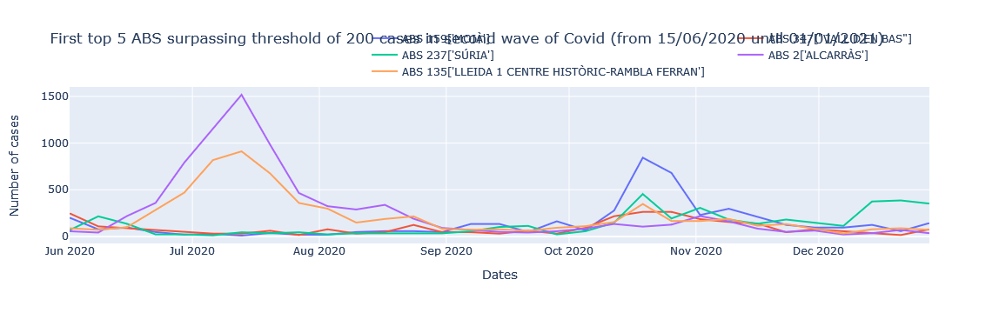

Threshold 400 cases by 100.000 population
Number of ABS that surpass the threshold 400 cases by 100.000 inhabitants is 212
First 5 ABSs to surpass threshold 400 are ABS {2: "['ALCARRÀS']", 135: "['LLEIDA 1 CENTRE HISTÒRIC-RAMBLA FERRAN']", 232: "['SERÒS']", 14: "['BALAGUER']", 136: "['LLEIDA 2 PRIMER DE MAIG']"} with first date 06/29/2020


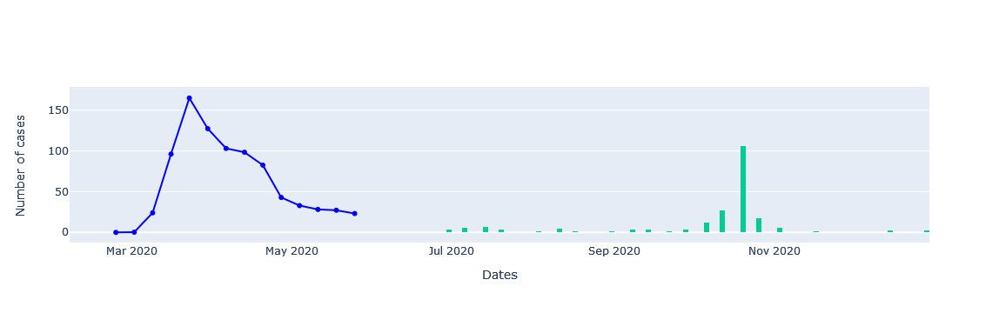

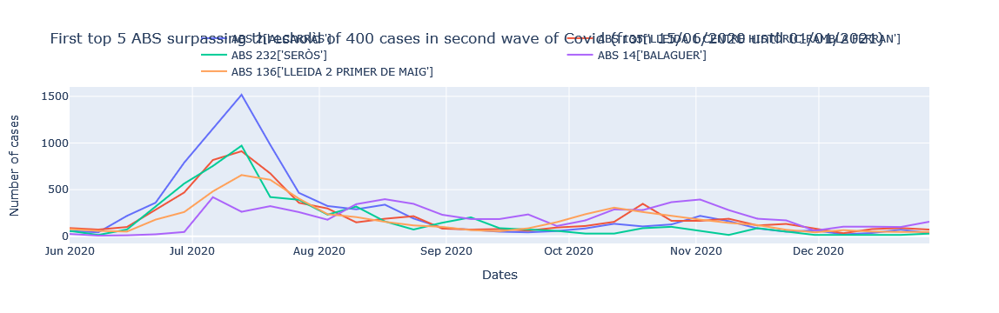

Threshold 600 cases by 100.000 population
Number of ABS that surpass the threshold 600 cases by 100.000 inhabitants is 69
First 5 ABSs to surpass threshold 600 are ABS {2: "['ALCARRÀS']", 135: "['LLEIDA 1 CENTRE HISTÒRIC-RAMBLA FERRAN']", 232: "['SERÒS']", 379: "['LLEIDA 7 ONZE DE SETEMBRE']", 136: "['LLEIDA 2 PRIMER DE MAIG']"} with first date 06/29/2020


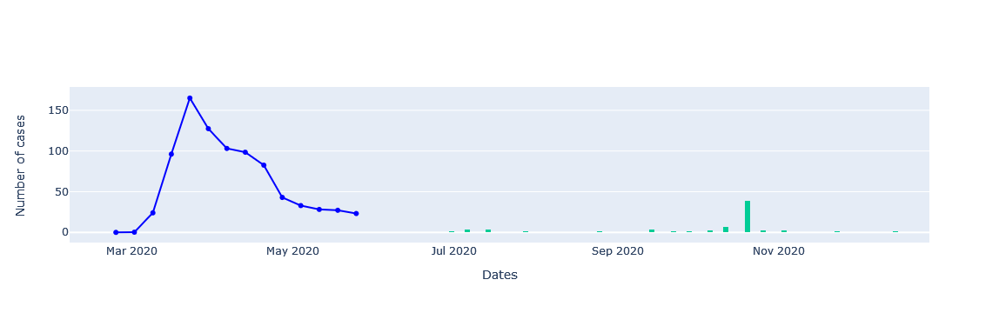

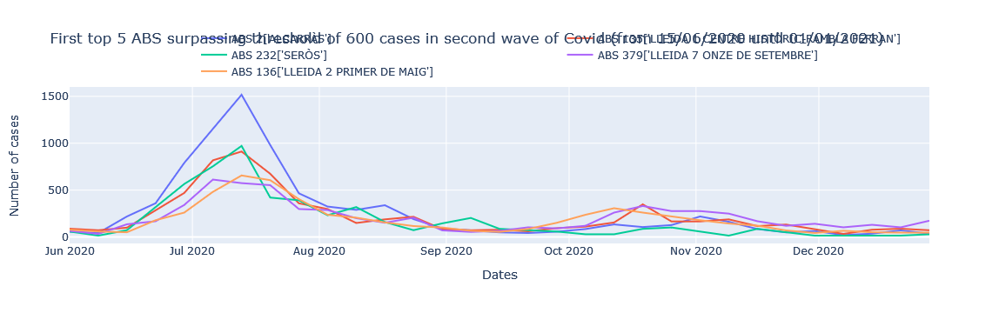

In [103]:
threshs = [200,400,600]

for i in threshs:
    print('Threshold ' + str(i) + ' cases by 100.000 population')
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_wave_pcrs.CODIABS.unique()
    for j in abss:
        filterabs = second_wave_pcrs.CODIABS == j
        df = second_wave_pcrs[filterabs]
        df = df.sort_values(by = ['WeekDate'])
        df = df.set_index('WeekDate') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)        
        else: pass
    print('Number of ABS that surpass the threshold ' + str(i) + ' cases by 100.000 inhabitants is ' +str(len(datesbyabsthreshold)))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)
    # fig.update_layout(showlegend=False)    
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    for l in min_kabs_l:
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))    
    # first_wave_no_missing_datesgp = second_wave_pcrs.groupby(['WeekDate'])['cases100hab'].sum()
    # fig = px.line(x = first_wave_no_missing_datesgp.index ,y = first_wave_no_missing_datesgp, title='second wave evolution of positive cases')
    # fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    # fig.show()
    second_wave_no_missing_datesgp = second_wave_pcrs.groupby(['WeekDate'])['NUM_PROVES'].sum().reset_index()
    second_wave_no_missing_datesgp['population'] = int(population)
    second_wave_no_missing_datesgp['100hab'] = 100000
    second_wave_no_missing_datesgp['proves100hab'] = (second_wave_no_missing_datesgp['100hab'] * second_wave_no_missing_datesgp['NUM_PROVES']) / second_wave_no_missing_datesgp['population']
    second_wave_no_missing_datesgp['weekend'] = np.where((second_wave_no_missing_datesgp.WeekDate.dt.weekday == 5) | (second_wave_no_missing_datesgp.WeekDate.dt.weekday == 6), 1, 0 )
    # print(first_wave_no_missing_datesgp)
    # break
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_datesgp['WeekDate'], y=second_wave_no_missing_datesgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_datesgp.WeekDate ,y = first_wave_no_missing_datesgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_pcrs.WeekDate.min(), second_wave_pcrs.WeekDate.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    # fig.update_traces(showlegend=False, 
    #               fillcolor = 'rgba(37, 41, 88, 1)',
    #               row = 1, col = 1)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 01/01/2021)')
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_pcrs.CODIABS == l
        df = second_wave_pcrs[filterABS]
        filternameabs = abstors.ABS1 == l
        nameabs = abstors[filternameabs]
        nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.WeekDate, y = df.cases100hab, name='ABS ' + str(l) + str(nameabs)))
    fig.update_layout(legend=dict(
        orientation = 'h',
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1))
    fig.show()

# starts lleida province


In [104]:
pcrsw.CODIABS.nunique(), data.CODIABS.nunique() #seems we have one abs less than geographical data

(373, 374)

In [105]:
absdata = data.CODIABS.unique()
abspcrsw = pcrsw.CODIABS.unique()

set(abspcrsw) ^ set(absdata)

{302, 381, 382}

In [106]:
maxval = pcrsw.cases100hab.max()
maxval

2478.9729969012838

In [107]:
#find initial date and last date in data
mindate_w = pcrsw.WeekDate.min()
maxdate_w = pcrsw.WeekDate.max() 
(maxdate_w-mindate_w).days / 7

88.0

In [108]:
mindate_w.to_pydatetime().weekday()

0

In [109]:
mindate_w

Timestamp('2020-02-24 00:00:00')

In [110]:
mindate_w = mindate_w +dt.timedelta(days=1)

In [111]:
maxdate_w.to_pydatetime().weekday()

0

In [112]:
maxdate_w = maxdate_w +dt.timedelta(days=1)

In [113]:
maxdate_w

Timestamp('2021-11-02 00:00:00')

In [114]:
type(mindate_w.to_pydatetime())

datetime.datetime

In [115]:
dates = pcrsw.WeekDate.unique()

for i in dates:
    a = pd.Timestamp(i)
    a = a.to_pydatetime()
    if a.weekday() == 0:
        pass
    else: 
        print('Date'+str(i)+'Not a monday')

In [116]:
pcrsw.WeekDate.min()

Timestamp('2020-02-24 00:00:00')

In [117]:
pcrsw.WeekDate.nunique()

89

In [118]:
pcrsw.CODIABS.nunique()

373

In [119]:
pcrsw

,CODIABS,NUM_INDIV,WeekDate,NUM_PROVES,100hab,cases100hab
0,1,6495,2020-03-09,1,100000,15.396459
1,1,6495,2020-03-16,4,100000,61.585835
2,1,6495,2020-03-23,2,100000,30.792918
3,1,6495,2020-04-06,6,100000,92.378753
4,1,6495,2020-04-13,3,100000,46.189376
...,...,...,...,...,...,...
30379,403,29403,2021-09-27,5,100000,17.005068
30380,403,29403,2021-10-04,13,100000,44.213176
30381,403,29403,2021-10-11,8,100000,27.208108
30382,403,29403,2021-10-18,5,100000,17.005068


In [120]:
pcrsw.dtypes

CODIABS                 int64
NUM_INDIV               int64
WeekDate       datetime64[ns]
NUM_PROVES              int64
100hab                  int64
cases100hab           float64
dtype: object

In [121]:
pcrsw.WeekDate.dt.dayofweek
pcrsw.WeekDate.dt.day_name()

0        Monday
1        Monday
2        Monday
3        Monday
4        Monday
          ...  
30379    Monday
30380    Monday
30381    Monday
30382    Monday
30383    Monday
Name: WeekDate, Length: 30384, dtype: object

In [122]:
abss = pcrsw.CODIABS.unique()
dfs = []
for i in abss:
    filterabs = pcrsw.CODIABS == i
    df = pcrsw[filterabs]
    df = (df.set_index('WeekDate')
      .reindex(pd.date_range(mindate_w, maxdate_w, freq='W-MON'))
      .rename_axis(['WeekDate'])
      .reset_index())
    df['CODIABS'] = i
    num_ind = float(df.NUM_INDIV.dropna().unique())
    df['NUM_INDIV'] = df['NUM_INDIV'].fillna(num_ind)
    df['100hab'] = df['100hab'].fillna(100000.0)
    df[['NUM_PROVES', 'cases100hab']] = df[['NUM_PROVES', 'cases100hab']].fillna(0)
    dfs.append(df)

no_missing_dates_w = pd.concat(dfs, axis=0, ignore_index=True)

In [123]:
no_missing_dates_w.CODIABS.nunique()

373

In [124]:
abss = pcrsw.CODIABS.unique()

for i in abss:
    filterabs = no_missing_dates_w.CODIABS == i
    df = no_missing_dates_w[filterabs]
    min_date = df.WeekDate.min()
    max_date = df.WeekDate.max() 
    diff_dates = (max_date-min_date).days
    if diff_dates != 609:
        print('Abs '+str(i) +' has' + str(diff_dates) +' different days')
    else: pass

In [125]:
no_missing_dates_w

,WeekDate,CODIABS,NUM_INDIV,NUM_PROVES,100hab,cases100hab
0,2020-03-02,1,6495.0,0.0,100000.0,0.000000
1,2020-03-09,1,6495.0,1.0,100000.0,15.396459
2,2020-03-16,1,6495.0,4.0,100000.0,61.585835
3,2020-03-23,1,6495.0,2.0,100000.0,30.792918
4,2020-03-30,1,6495.0,0.0,100000.0,0.000000
...,...,...,...,...,...,...
32819,2021-10-04,403,29403.0,13.0,100000.0,44.213176
32820,2021-10-11,403,29403.0,8.0,100000.0,27.208108
32821,2021-10-18,403,29403.0,5.0,100000.0,17.005068
32822,2021-10-25,403,29403.0,2.0,100000.0,6.802027


In [126]:
no_missing_dates_w.dtypes

WeekDate       datetime64[ns]
CODIABS                 int64
NUM_INDIV             float64
NUM_PROVES            float64
100hab                float64
cases100hab           float64
dtype: object

In [127]:
no_missing_dates_w.CODIABS.nunique()

373

In [128]:
maxval = no_missing_dates_w.cases100hab.max()

In [129]:
# dates = pcrsw.WeekDate.unique()
# len(dates)
# for i in dates:
#     # cmap = 'Blues'
#     filterdata = no_missing_dates_w.WeekDate == i
#     df = no_missing_dates_w[filterdata]
#     mergeddataplot = data.merge(df, on ='CODIABS', how='right')
#     mergeddataplot = mergeddataplot.drop(['NUM_INDIV', 'NUM_PROVES','100hab'], axis=1)
#     mergeddataplot['cases100hab'] = mergeddataplot['cases100hab'].fillna(0)
#     mergeddataplot['WeekDate'] = mergeddataplot['WeekDate'].fillna(mergeddataplot.WeekDate.value_counts().index[0])
#     # print(mergeddataplot.isna().sum())
#     # break
#     mergeddataplot = mergeddataplot.sort_values(by=['CODIABS'])
#     fig, ax = plt.subplots(1, 1)
#     mergeddataplot.plot(column='cases100hab', ax=ax, cmap = cmap_rb, legend=True, edgecolor='0.3', \
#                         vmin = 0, vmax = maxval/2,linewidth = 0.05)
#     plt.axis('off')
#     plt.title('Normalized PCR tests / 100.000 habitants on day ' + str(i)) 
#     plt.show()
#     fig.savefig(f'PCRdistributionnormalized/WeekPlots/Week_'+str(i)+'.png', dpi=100, bbox_inches='tight') 

In [130]:
# conseguir tener histograma de cuando passan threshold cada abs

# Simulation Analysis

In [131]:
summaryinfo = pd.read_csv('SummaryInfoAO.csv',sep=';')
simulation  = pd.read_csv('statusPeopleStatusIDRegions_AO.csv',sep=';')
summaryinfo_ = summaryinfo.join(simulation[['regionsNameList']])

In [132]:
summaryinfo_.diagnosedTic.nunique()

884

In [133]:
summaryinfo_

,exposed,lambda_home,lambda_work,lambda_play,lambda_work_pubTran,lambda_play_pubTran,infectious,diagnosed,exposedTic,infectiousTic,diagnosedTic,Worktransportlist,Playtransportlist,regionsNameList
0,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,1,0,ALTP30_40
1,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,0,0,ALTP30_40
2,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,0,0,ALTP30_40
3,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,0,0,ALTP30_40
4,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,0,2,ALTP30_40
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5527228,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,0,2,VAOR>40
5527229,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,0,0,VAOR>40
5527230,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,0,0,VAOR>40
5527231,0,0.0,0.0,0.0,0.0,0.0,0,0,-1,-1,-1,1,0,VAOR>40


In [134]:
# summaryinfo_.diagnosedTic = summaryinfo_.diagnosedTic.replace(-1, 0)
summaryinfo_.diagnosedTic.nunique()

884

In [135]:
# knowing how many people we have per region to be able to compute cases per 100.000 inhabitants
summaryinfo_gp = summaryinfo_.groupby('regionsNameList').count().reset_index()
summaryinfo_gp = summaryinfo_gp[['regionsNameList', 'exposed']].rename(columns={"exposed": "NUM_IND"})
print(summaryinfo_gp.columns)
popbcn = summaryinfo_gp.NUM_IND.sum()
summaryinfo_gp_dict = dict(zip(summaryinfo_gp.regionsNameList, summaryinfo_gp.NUM_IND))
summaryinfo_['date'] = summaryinfo_['diagnosedTic'].apply(lambda x: tictotime(x))

Index(['regionsNameList', 'NUM_IND'], dtype='object')


In [136]:
summaryinfo_.date.nunique()

299

In [137]:
summaryinfo_.columns

Index(['exposed', 'lambda_home', 'lambda_work', 'lambda_play',
       'lambda_work_pubTran', 'lambda_play_pubTran', 'infectious', 'diagnosed',
       'exposedTic', 'infectiousTic', 'diagnosedTic', 'Worktransportlist',
       'Playtransportlist', 'regionsNameList', 'date'],
      dtype='object')

In [138]:
summaryinfo_.diagnosed.value_counts()

0    5162221
1     365012
Name: diagnosed, dtype: int64

In [139]:
filterdiagnosed  = summaryinfo_.diagnosed == 1
summaryinfo_diag = summaryinfo_[filterdiagnosed]

In [140]:
summaryinfo_diag

,exposed,lambda_home,lambda_work,lambda_play,lambda_work_pubTran,lambda_play_pubTran,infectious,diagnosed,exposedTic,infectiousTic,diagnosedTic,Worktransportlist,Playtransportlist,regionsNameList,date
25,1,0.000000,0.000000,0.0,0.000210,0.0,1,1,421,426,439,1,0,ALTP30_40,2020-07-05
53,1,0.000000,0.018636,0.0,0.000000,0.0,1,1,805,805,821,0,2,ALTP30_40,2020-11-09
106,1,0.000000,0.089514,0.0,0.000000,0.0,1,1,118,122,155,0,0,ALTP30_40,2020-04-01
129,1,0.949016,0.000000,0.0,0.000000,0.0,1,1,125,140,159,0,0,ALTP30_40,2020-04-03
155,1,0.000000,0.000000,0.0,0.001654,0.0,1,1,673,690,709,1,0,ALTP30_40,2020-10-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5526970,1,0.465522,0.000000,0.0,0.000000,0.0,1,1,411,411,427,0,0,VAOR>40,2020-07-01
5527009,1,0.239092,0.000000,0.0,0.000000,0.0,1,1,397,406,434,0,0,VAOR>40,2020-07-03
5527087,1,0.632677,0.000000,0.0,0.000000,0.0,1,1,411,432,448,0,0,VAOR>40,2020-07-08
5527176,1,0.000000,0.000000,0.0,0.011468,0.0,1,1,115,173,198,1,0,VAOR>40,2020-04-16


In [141]:
summaryinfo_diag.shape

(365012, 15)

In [142]:
summaryinfo_diag_gp = summaryinfo_diag.groupby(['regionsNameList', 'date'])['diagnosed'].sum().reset_index()
summaryinfo_diag_gp

,regionsNameList,date,diagnosed
0,ALTP30_40,2020-03-05,1
1,ALTP30_40,2020-03-06,1
2,ALTP30_40,2020-03-07,4
3,ALTP30_40,2020-03-10,3
4,ALTP30_40,2020-03-11,2
...,...,...,...
21254,VAOR>40,2020-12-02,6
21255,VAOR>40,2020-12-03,6
21256,VAOR>40,2020-12-04,4
21257,VAOR>40,2020-12-05,2


In [143]:
no_missing_dates = summaryinfo_diag_gp.copy()
no_missing_dates.date = pd.to_datetime(no_missing_dates.date)

# dates = no_missing_dates.set_index('date').resample('D').asfreq().index 
# no_missing_dates.set_index('date').resample('D').asfreq()

no_missing_dates = no_missing_dates.set_index(
    ['date', 'regionsNameList']
).unstack(
    fill_value=0
).asfreq(
    'D', fill_value=0
).stack().sort_index(level=1).reset_index()


In [144]:
no_missing_dates.shape, summaryinfo_diag_gp.shape

((24734, 3), (21259, 3))

In [145]:
no_missing_dates.date.min(),no_missing_dates.date.max() 

(Timestamp('2020-02-13 00:00:00'), Timestamp('2020-12-06 00:00:00'))

In [146]:
first_wave_no_missing_dates_filter = no_missing_dates['date'] < '2020-06-15'

In [147]:
first_wave_no_missing_dates_filter

0         True
1         True
2         True
3         True
4         True
         ...  
24729    False
24730    False
24731    False
24732    False
24733    False
Name: date, Length: 24734, dtype: bool

In [148]:
#### First wave daily analysis
first_wave_no_missing_dates = no_missing_dates[first_wave_no_missing_dates_filter]
first_wave_no_missing_dates["NUM_IND"]= first_wave_no_missing_dates["regionsNameList"].map(summaryinfo_gp_dict)
first_wave_no_missing_dates['100hab'] = 100000
first_wave_no_missing_dates['cases100hab'] = ( first_wave_no_missing_dates['100hab'] * first_wave_no_missing_dates.diagnosed ) / first_wave_no_missing_dates.NUM_IND
first_wave_no_missing_dates

/tmp/ipykernel_96/1004343529.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_96/1004343529.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_96/1004343529.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,regionsNameList,diagnosed,NUM_IND,100hab,cases100hab
0,2020-02-13,ALTP30_40,0,72770,100000,0.000000
1,2020-02-14,ALTP30_40,0,72770,100000,0.000000
2,2020-02-15,ALTP30_40,0,72770,100000,0.000000
3,2020-02-16,ALTP30_40,0,72770,100000,0.000000
4,2020-02-17,ALTP30_40,0,72770,100000,0.000000
...,...,...,...,...,...,...
24554,2020-06-10,VAOR>40,1,41208,100000,2.426713
24555,2020-06-11,VAOR>40,0,41208,100000,0.000000
24556,2020-06-12,VAOR>40,2,41208,100000,4.853427
24557,2020-06-13,VAOR>40,0,41208,100000,0.000000


Threshold 50 cases by 100.000 population
There are 59 ABS that surpass threshold 50
First 5 ABSs to surpass threshold 50 are ABS {} with first date 03/11/2020


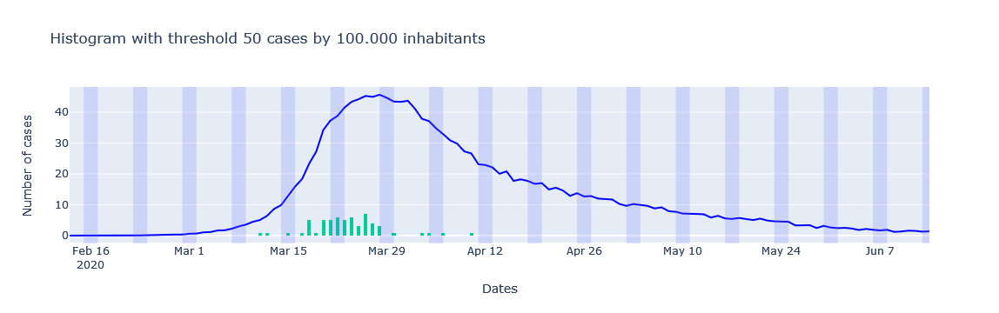

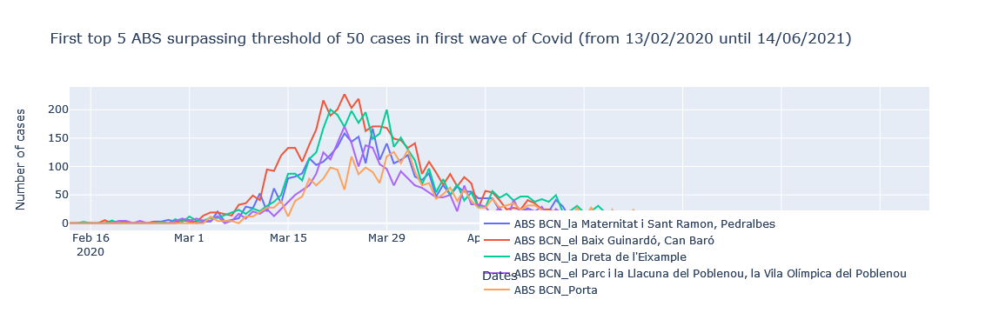

Threshold 100 cases by 100.000 population
There are 11 ABS that surpass threshold 100
First 5 ABSs to surpass threshold 100 are ABS {} with first date 03/14/2020


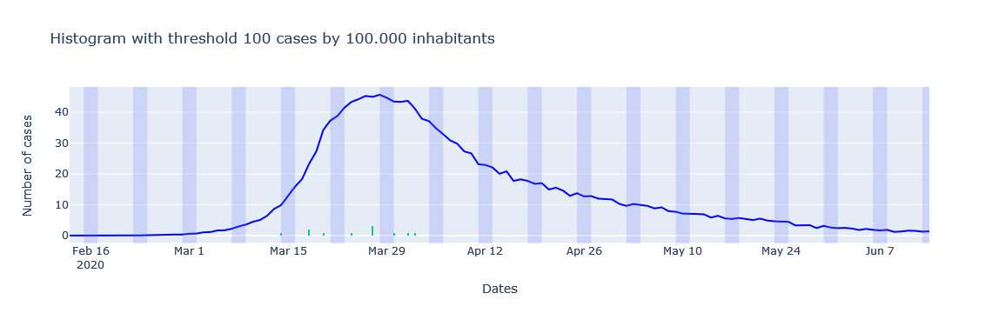

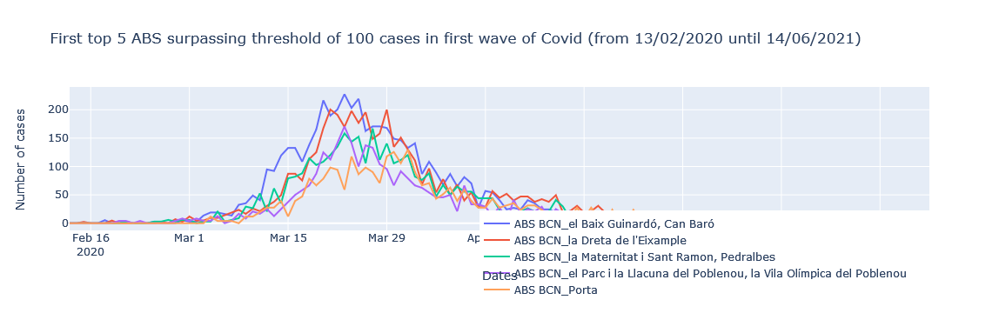

Threshold 200 cases by 100.000 population
There are 3 ABS that surpass threshold 200
First 3 ABSs to surpass threshold 200 are ABS {} with first date 03/20/2020


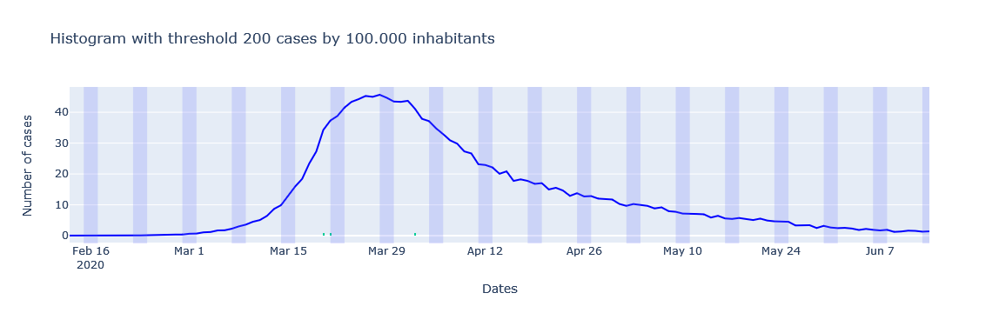

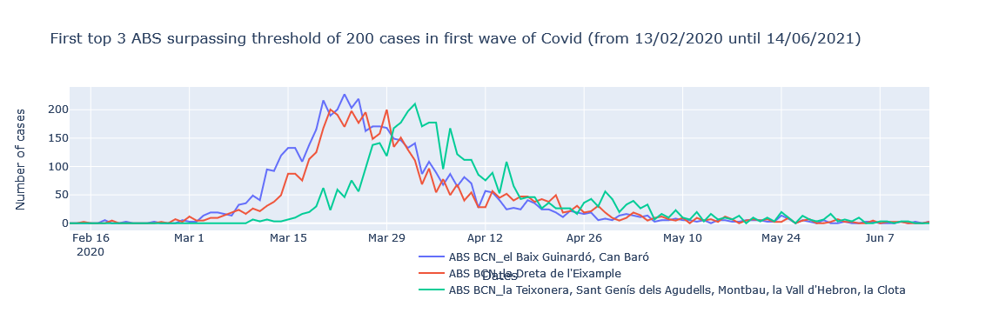

In [149]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = first_wave_no_missing_dates.regionsNameList.unique()
    for j in abss:
        filterabs = first_wave_no_missing_dates.regionsNameList == j
        df = first_wave_no_missing_dates[filterabs]
        df = df.sort_values(by = ['date'])
        df = df.set_index('date') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('There are ' +str(len(datesbyabsthreshold)) + ' ABS that surpass threshold ' + str(i))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)    
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    # for l in min_kabs_l:
    #     filternameabs = abstors.ABS1 == l
    #     nameabs = abstors[filternameabs]
    #     nameabs = str(nameabs.ABS2.values)
    #     namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    first_wave_no_missing_datesgp = first_wave_no_missing_dates.groupby(['date'])['diagnosed'].sum().reset_index()
    first_wave_no_missing_datesgp['population'] = int(popbcn)
    first_wave_no_missing_datesgp['100hab'] = 100000
    first_wave_no_missing_datesgp['proves100hab'] = (first_wave_no_missing_datesgp['100hab'] * first_wave_no_missing_datesgp['diagnosed']) / first_wave_no_missing_datesgp['population']
    first_wave_no_missing_datesgp['weekend'] = np.where((first_wave_no_missing_datesgp.date.dt.weekday == 5) | (first_wave_no_missing_datesgp.date.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=first_wave_no_missing_datesgp['date'], y=first_wave_no_missing_datesgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=first_wave_no_missing_datesgp.date ,y = first_wave_no_missing_datesgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[first_wave_no_missing_datesgp.date.min(), first_wave_no_missing_datesgp.date.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in first wave of Covid (from 13/02/2020 until 14/06/2021)')
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = first_wave_no_missing_dates.regionsNameList == l
        df = first_wave_no_missing_dates[filterABS]
        # filternameabs = abstors.ABS1 == l
        # nameabs = abstors[filternameabs]
        # nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.date, y = df.cases100hab, name='ABS ' + str(l)))
        fig.update_layout(legend=dict(
            orientation = 'h',
            yanchor="bottom",
            y=-0.5,
            xanchor="right",
            x=1))
    fig.show()

    
# if we take into accound first threshold 50, Igualada is clearly the place where it had more cases since the beggining
# second threshold selva comarca

In [150]:
#### Second wave daily analysis
second_wave_no_missing_dates = no_missing_dates[~first_wave_no_missing_dates_filter]
second_wave_no_missing_dates["NUM_IND"]= second_wave_no_missing_dates["regionsNameList"].map(summaryinfo_gp_dict)
second_wave_no_missing_dates['100hab'] = 100000
second_wave_no_missing_dates['cases100hab'] = ( second_wave_no_missing_dates['100hab'] * second_wave_no_missing_dates.diagnosed ) / second_wave_no_missing_dates.NUM_IND
second_wave_no_missing_dates

/tmp/ipykernel_96/4206949441.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_96/4206949441.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_96/4206949441.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,regionsNameList,diagnosed,NUM_IND,100hab,cases100hab
123,2020-06-15,ALTP30_40,2,72770,100000,2.748385
124,2020-06-16,ALTP30_40,0,72770,100000,0.000000
125,2020-06-17,ALTP30_40,3,72770,100000,4.122578
126,2020-06-18,ALTP30_40,0,72770,100000,0.000000
127,2020-06-19,ALTP30_40,0,72770,100000,0.000000
...,...,...,...,...,...,...
24729,2020-12-02,VAOR>40,6,41208,100000,14.560280
24730,2020-12-03,VAOR>40,6,41208,100000,14.560280
24731,2020-12-04,VAOR>40,4,41208,100000,9.706853
24732,2020-12-05,VAOR>40,2,41208,100000,4.853427


Threshold 50 cases by 100.000 population
There are 58 ABS that surpass threshold 50
First 5 ABSs to surpass threshold 50 are ABS {} with first date 07/15/2020


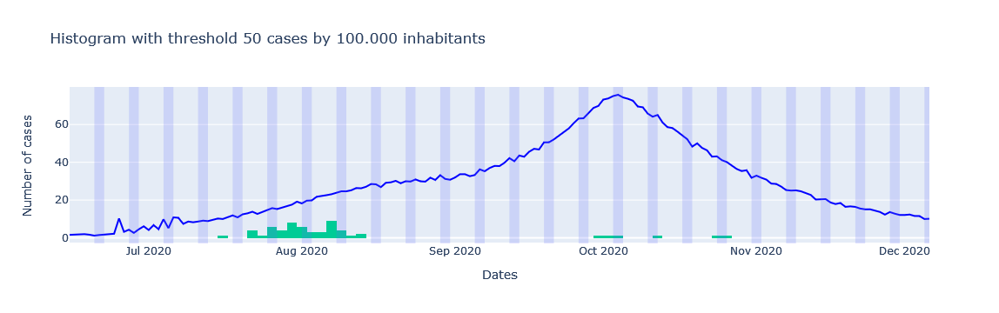

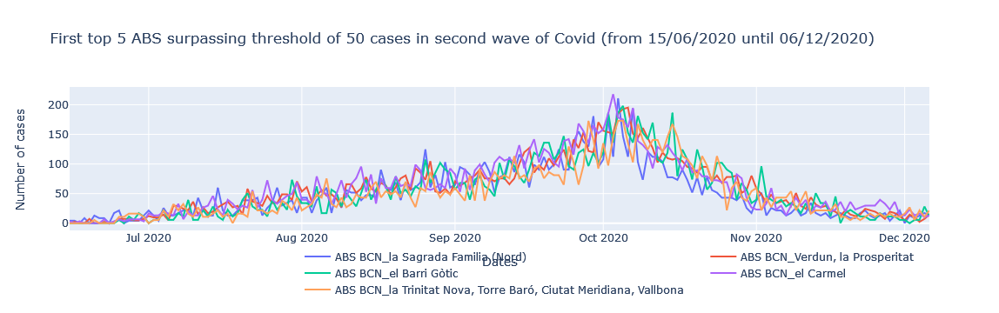

Threshold 100 cases by 100.000 population
There are 52 ABS that surpass threshold 100
First 5 ABSs to surpass threshold 100 are ABS {} with first date 08/17/2020


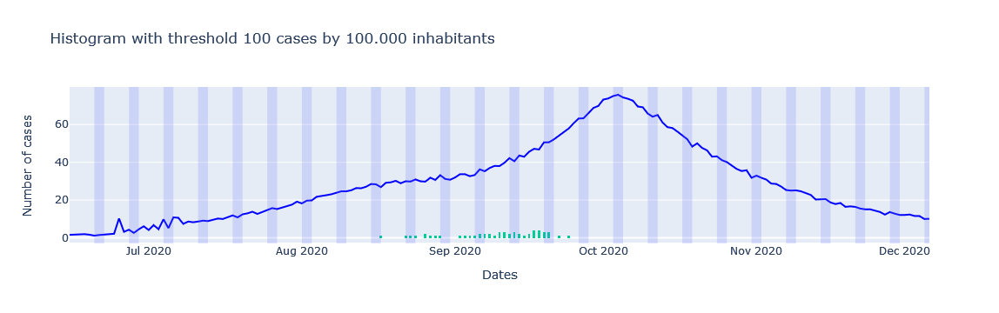

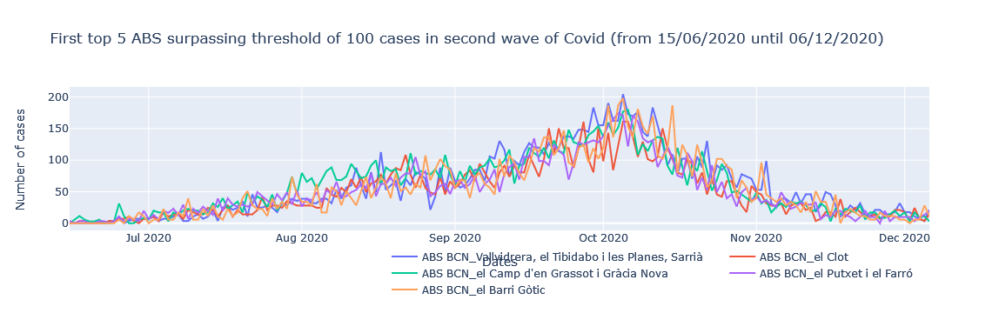

Threshold 200 cases by 100.000 population
There are 13 ABS that surpass threshold 200
First 5 ABSs to surpass threshold 200 are ABS {} with first date 09/24/2020


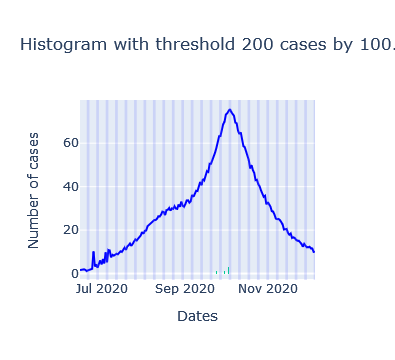

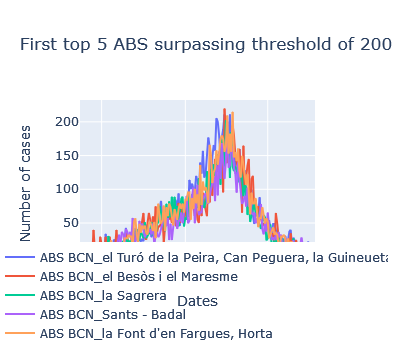

In [151]:
# check when each abs surpasses threshold
import plotly.graph_objects as go
threshs = [50,100,200]

for i in threshs:
    print("\033[1m" + 'Threshold ' + str(i) + ' cases by 100.000 population' + "\033[0m")
    datesbyabsthreshold = []
    absbythreshold = []
    abss = second_wave_no_missing_dates.regionsNameList.unique()
    for j in abss:
        filterabs = second_wave_no_missing_dates.regionsNameList == j
        df = second_wave_no_missing_dates[filterabs]
        df = df.sort_values(by = ['date'])
        df = df.set_index('date') 
        df = df[(df.cases100hab > i)]
        if len(df) > 0:
            date = (df.cases100hab > i).idxmax()
            datesbyabsthreshold.append(date)
            absbythreshold.append(j)
        else: pass
    print('There are ' +str(len(datesbyabsthreshold)) + ' ABS that surpass threshold ' + str(i))
    # fig = px.histogram(datesbyabsthreshold, nbins=55)    
    # fig.update_layout(showlegend=False)
    # fig.show()
    K = 5
    min_kabs_list = sorted(zip(absbythreshold,datesbyabsthreshold), key=lambda t: t[1])[:K]
    min_kabs_l = [i[0] for i in min_kabs_list]
    min_date_kabs_l = [i[1] for i in min_kabs_list]   
    if len(min_kabs_l) < K:
        K = len(min_kabs_l)
    else: pass
    namesabs = []
    # for l in min_kabs_l:
    #     filternameabs = abstors.ABS1 == l
    #     nameabs = abstors[filternameabs]
    #     nameabs = str(nameabs.ABS2.values)
    #     namesabs.append(nameabs)
    dictabs = dict(zip(min_kabs_l, namesabs))
    print('First ' + str(K) + ' ABSs to surpass threshold ' + str(i) + ' are ABS ' + str(dictabs) + ' with first date ' +str(min_date_kabs_l[0].strftime('%m/%d/%Y')))
    second_wave_no_missing_datesgp = second_wave_no_missing_dates.groupby(['date'])['diagnosed'].sum().reset_index()
    second_wave_no_missing_datesgp['population'] = int(popbcn)
    second_wave_no_missing_datesgp['100hab'] = 100000
    second_wave_no_missing_datesgp['proves100hab'] = (second_wave_no_missing_datesgp['100hab'] * second_wave_no_missing_datesgp['diagnosed']) / second_wave_no_missing_datesgp['population']
    second_wave_no_missing_datesgp['weekend'] = np.where((second_wave_no_missing_datesgp.date.dt.weekday == 5) | (second_wave_no_missing_datesgp.date.dt.weekday == 6), 1, 0 )
    fig = make_subplots(specs=[[{"secondary_y": True, "r":-0.06}]])
    fig.add_trace(go.Scatter(x=second_wave_no_missing_datesgp['date'], y=second_wave_no_missing_datesgp.weekend, fill = 'tonexty', showlegend = False), secondary_y=True)
    fig.update_traces(showlegend=False, line_shape = 'hv',
                  line_color = 'rgba(0,0,0,0)',
                  fillcolor = 'rgba(99, 110, 250, 0.2)',
                  row = 1, col = 1)
    fig.update_xaxes(showgrid=False, gridwidth=5, gridcolor='rgba(0,0,255,0.1)')
    fig.update_layout(showlegend=False,yaxis2_range=[-0,0.1], yaxis2_showgrid=False,  yaxis2_tickfont_color = 'rgba(0,0,0,0)')
    fig.add_trace(go.Scatter(x=second_wave_no_missing_datesgp.date ,y = second_wave_no_missing_datesgp.proves100hab, line_color = 'blue'), secondary_y = False)
    fig.update_layout(title = 'Histogram with threshold ' + str(i) + ' cases by 100.000 inhabitants', showlegend=False, xaxis_title = 'Dates', yaxis_title='Number of cases')
    hist = px.histogram(datesbyabsthreshold, nbins=373, color_discrete_sequence=['indianred'])
    hist.update_layout(showlegend = False, xaxis_range=[second_wave_no_missing_datesgp.date.min(), second_wave_no_missing_datesgp.date.max()])
    fig.add_trace(go.Histogram(x = hist.data[0].x, y= hist.data[0].y, nbinsx = 100), secondary_y = False)
    fig.show()
    # break
    fig = px.line(title = 'First top ' +str(K)+ ' ABS surpassing threshold of ' + str(i) +  ' cases in second wave of Covid (from 15/06/2020 until 06/12/2020)')
    # fig = px.line()
    fig.update_layout(xaxis_title = 'Dates', yaxis_title='Number of cases')
    for l in min_kabs_l:
        filterABS = second_wave_no_missing_dates.regionsNameList == l
        df = second_wave_no_missing_dates[filterABS]
        # filternameabs = abstors.ABS1 == l
        # nameabs = abstors[filternameabs]
        # nameabs = str(nameabs.ABS2.values)
        fig.add_trace(go.Scatter(x = df.date, y = df.cases100hab, name='ABS ' + str(l)))
        fig.update_layout(legend=dict(
            orientation = 'h',
            yanchor="bottom",
            y=-0.5,
            xanchor="right",
            x=1))
    fig.show()

    
# if we take into accound first threshold 50, Igualada is clearly the place where it had more cases since the beggining
# second threshold selva comarca